In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pylab as plt
import seaborn as sns

from sklearn.model_selection  import train_test_split
from sklearn.tree import DecisionTreeClassifier   # Import Decision Tree Classifier

from sklearn.tree import DecisionTreeRegressor 
from sklearn.metrics import classification_report
import sklearn.metrics
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder

from sklearn.naive_bayes import GaussianNB

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import mean_absolute_error

import pandas_profiling

from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

In [6]:
new_data = pd.read_csv('C:/Users/MMQuant/Desktop/GME II/notebooks/AI_CUST2020_RAND_200K_new.csv')

print(new_data.shape)
print(new_data.columns)
new_data.head()

(200529, 82)
Index(['Unnamed: 0', 'Customer_ID', 'Date_First_Purchase_2020',
       'Date_Last_Purchase_2020', 'number_of_orders_2020',
       'UniqueSKU_ordered_2020', 'Sales_Amt_2020', 'Sales_Qty_2020',
       'Discount_Amt_2020', 'Margin_Amt_2020', 'HasMobileChannelTrx',
       'HasDesktopeChannelTrx', 'HasAppChannelTrx', 'HasWebInStoreChannelTrx',
       'HasDomesticStoreTrx', 'LootTrx_L1', 'DigitalTrx_L1', 'Zero_RevTrx_L1',
       'Video_GameTrx_L1', 'MobileTrx_L1', 'OtherTrx_L1',
       'has_redeemed_5_dollar_coupon', 'sale_only_sum', 'tradein_only_sum',
       'pre_order_Trx', 'pre_order_amt', 'promotion_Trx', 'promotion_amt',
       'clearance_Trx', 'clearance_amt', 'regular_sale_Trx',
       'regular_sale_amt', 'Total_online_Trx', 'online_sales_amt',
       'L123_01_VidGmNewSW_Trx', 'L123_01_VidGmNewSW_amt',
       'L123_02_VidGmNewHW_Trx', 'L123_02_VidGmNewHW_amt',
       'L123_03_VidGmNewAcc_Trx', 'L123_03_VidGmNewAcc_amt',
       'L123_04_VidGmUsedSW_Trx', 'L123_04_VidGmUse

,Unnamed: 0,Customer_ID,Date_First_Purchase_2020,Date_Last_Purchase_2020,number_of_orders_2020,UniqueSKU_ordered_2020,Sales_Amt_2020,Sales_Qty_2020,Discount_Amt_2020,Margin_Amt_2020,...,Current_Segment,Total_Transaction_Count,Points_Earned_Till_Date,City,State,Country_Code,RFM_Segment_Start,RFM_descr_Start,RFM_Segment_End,RFM_desrc_End
0,0,1260750970,2020-06-06,2020-06-06,1,1,3.15,1.0,NaN,3.15,...,NaN,NaN,11320.0,NaN,NaN,NaN,0.0,Lapsed,1.0,Least Loyal
1,1,1035235120,2020-10-14,2020-10-14,1,4,62.97,6.0,NaN,43.08,...,Y,1.0,211428.0,NaN,NaN,NaN,5.0,Best in Class,2.0,Sporadic Returners
2,2,1298857210,2020-07-17,2020-07-17,1,3,125.98,4.0,NaN,29.98,...,NaN,NaN,5000.0,NaN,NaN,NaN,NaN,NaN,2.0,Sporadic Returners
3,3,1276699004,2020-10-02,2020-10-02,1,1,12.99,1.0,NaN,10.72,...,Y,1.0,30000.0,NaN,NaN,NaN,0.0,Lapsed,2.0,Sporadic Returners
4,4,1018142558,2020-06-01,2020-06-01,1,4,131.96,4.0,5.0,40.02,...,Y,1.0,128400.0,NaN,NaN,NaN,4.0,Rising Stars,2.0,Sporadic Returners


In [7]:
new_data = new_data.drop(['Unnamed: 0'], axis=1)
new_data.head()

,Customer_ID,Date_First_Purchase_2020,Date_Last_Purchase_2020,number_of_orders_2020,UniqueSKU_ordered_2020,Sales_Amt_2020,Sales_Qty_2020,Discount_Amt_2020,Margin_Amt_2020,HasMobileChannelTrx,...,Current_Segment,Total_Transaction_Count,Points_Earned_Till_Date,City,State,Country_Code,RFM_Segment_Start,RFM_descr_Start,RFM_Segment_End,RFM_desrc_End
0,1260750970,2020-06-06,2020-06-06,1,1,3.15,1.0,NaN,3.15,0,...,NaN,NaN,11320.0,NaN,NaN,NaN,0.0,Lapsed,1.0,Least Loyal
1,1035235120,2020-10-14,2020-10-14,1,4,62.97,6.0,NaN,43.08,0,...,Y,1.0,211428.0,NaN,NaN,NaN,5.0,Best in Class,2.0,Sporadic Returners
2,1298857210,2020-07-17,2020-07-17,1,3,125.98,4.0,NaN,29.98,0,...,NaN,NaN,5000.0,NaN,NaN,NaN,NaN,NaN,2.0,Sporadic Returners
3,1276699004,2020-10-02,2020-10-02,1,1,12.99,1.0,NaN,10.72,0,...,Y,1.0,30000.0,NaN,NaN,NaN,0.0,Lapsed,2.0,Sporadic Returners
4,1018142558,2020-06-01,2020-06-01,1,4,131.96,4.0,5.0,40.02,0,...,Y,1.0,128400.0,NaN,NaN,NaN,4.0,Rising Stars,2.0,Sporadic Returners


In [8]:
new_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200529 entries, 0 to 200528
Data columns (total 81 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   Customer_ID                         200529 non-null  int64  
 1   Date_First_Purchase_2020            200529 non-null  object 
 2   Date_Last_Purchase_2020             200529 non-null  object 
 3   number_of_orders_2020               200529 non-null  int64  
 4   UniqueSKU_ordered_2020              200529 non-null  int64  
 5   Sales_Amt_2020                      200529 non-null  float64
 6   Sales_Qty_2020                      200529 non-null  float64
 7   Discount_Amt_2020                   95658 non-null   float64
 8   Margin_Amt_2020                     200529 non-null  float64
 9   HasMobileChannelTrx                 200529 non-null  int64  
 10  HasDesktopeChannelTrx               200529 non-null  int64  
 11  HasAppChannelTrx          

In [ ]:
new_data.profile_report()

Summarize dataset:   0%|          | 0/94 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
new_data.columns

Index(['Customer_ID', 'Date_First_Purchase_2020', 'Date_Last_Purchase_2020',
       'number_of_orders_2020', 'UniqueSKU_ordered_2020', 'Sales_Amt_2020',
       'Sales_Qty_2020', 'Discount_Amt_2020', 'Margin_Amt_2020',
       'HasMobileChannelTrx', 'HasDesktopeChannelTrx', 'HasAppChannelTrx',
       'HasWebInStoreChannelTrx', 'HasDomesticStoreTrx',
       'Preferred_Store_Number', 'Home_Store_Number',
       'Loyalty_Account_Creation_Date', 'Loyalty_Account_Effective_Date',
       'Tier', 'TierRenewalStatus', 'TierExpirationStatus', 'Tenure_in_days',
       'Total_Dollar_Spent', 'Age_In_Years', 'Gender_Description',
       'Loyalty_Account_Status_Description', 'Lifecycle_Segment',
       'Lifecycle_SubSegment', 'Current_Segment', 'Total_Transaction_Count',
       'Points_Earned_Till_Date', 'City', 'State', 'Country_Code',
       'RFM_Segment_Start', 'RFM_descr_Start', 'RFM_Segment_End',
       'RFM_desrc_End'],
      dtype='object')

In [ ]:
# filtering the data by sales_amt_2020 <=100

new_data_fikter_salesAmt = new_data[new_data['Sales_Amt_2020']<=100]

In [12]:
new_data['to_buy'] = '0'

for index, row in new_data.iterrows():
    if new_data['Total_Dollar_Spent'][index]>10:
        new_data['ordered'][index] = True
    else:
        new_data['ordered'][index] = False
        
new_data.head()

C:\Users\Marin\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\Marin\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


,Customer_ID,Date_First_Purchase_2020,Date_Last_Purchase_2020,number_of_orders_2020,UniqueSKU_ordered_2020,Sales_Amt_2020,Sales_Qty_2020,Discount_Amt_2020,Margin_Amt_2020,HasMobileChannelTrx,...,Total_Transaction_Count,Points_Earned_Till_Date,City,State,Country_Code,RFM_Segment_Start,RFM_descr_Start,RFM_Segment_End,RFM_desrc_End,ordered
0,1033022981,2020-12-16,2020-12-22,2,3,52.96,3.0,2.97,22.89,0,...,NaN,526664.0,NaN,NaN,NaN,1.0,Least Loyal,4.0,Rising Stars,1
1,1007007246,2020-02-28,2020-12-03,14,18,620.46,23.0,23.40,179.66,1,...,NaN,1746860.0,NaN,NaN,NaN,5.0,Best in Class,5.0,Best in Class,1
2,1256055276,2020-06-13,2020-12-24,3,4,-122.18,0.0,NaN,-24.19,0,...,NaN,29310.0,NaN,NaN,NaN,0.0,Lapsed,5.0,Best in Class,1
3,1040294308,2020-02-07,2020-11-13,11,21,331.57,20.0,77.25,112.78,0,...,NaN,317160.0,NaN,NaN,NaN,5.0,Best in Class,5.0,Best in Class,1
4,1079472993,2020-04-29,2020-12-27,6,8,614.92,9.0,10.00,254.84,0,...,NaN,197555.0,NaN,NaN,NaN,4.0,Rising Stars,5.0,Best in Class,1


In [9]:
new_data.profile_report()

Summarize dataset:   0%|          | 0/52 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
dates_list = ['Date_First_Purchase_2020', 
              'Date_Last_Purchase_2020', 
              'Loyalty_Account_Creation_Date',
              'Loyalty_Account_Effective_Date'
             ]

# converting  string to datetime
prep_new_data = new_data
 
prep_new_data.Date_First_Purchase_2020 = pd.to_datetime(prep_new_data.Date_First_Purchase_2020)
prep_new_data.Date_Last_Purchase_2020 = pd.to_datetime(prep_new_data.Date_Last_Purchase_2020 )
prep_new_data.Loyalty_Account_Creation_Date = pd.to_datetime(prep_new_data.Loyalty_Account_Creation_Date)
prep_new_data.Loyalty_Account_Effective_Date = pd.to_datetime(prep_new_data.Loyalty_Account_Effective_Date)

prep_new_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 39 columns):
 #   Column                              Non-Null Count   Dtype         
---  ------                              --------------   -----         
 0   Customer_ID                         200000 non-null  int64         
 1   Date_First_Purchase_2020            200000 non-null  datetime64[ns]
 2   Date_Last_Purchase_2020             200000 non-null  datetime64[ns]
 3   number_of_orders_2020               200000 non-null  int64         
 4   UniqueSKU_ordered_2020              200000 non-null  int64         
 5   Sales_Amt_2020                      200000 non-null  float64       
 6   Sales_Qty_2020                      200000 non-null  float64       
 7   Discount_Amt_2020                   72249 non-null   float64       
 8   Margin_Amt_2020                     200000 non-null  float64       
 9   HasMobileChannelTrx                 200000 non-null  int64         
 10  HasDeskt

In [15]:
# for case when ordered i s 1 or 0 and for RandomForestRegressor
"""
new_data['ordered'] =  new_data['ordered'].astype('int')
new_data.head()
"""

,Customer_ID,Date_First_Purchase_2020,Date_Last_Purchase_2020,number_of_orders_2020,UniqueSKU_ordered_2020,Sales_Amt_2020,Sales_Qty_2020,Discount_Amt_2020,Margin_Amt_2020,HasMobileChannelTrx,...,Total_Transaction_Count,Points_Earned_Till_Date,City,State,Country_Code,RFM_Segment_Start,RFM_descr_Start,RFM_Segment_End,RFM_desrc_End,ordered
0,1033022981,2020-12-16,2020-12-22,2,3,52.96,3.0,2.97,22.89,0,...,NaN,526664.0,NaN,NaN,NaN,1.0,Least Loyal,4.0,Rising Stars,1
1,1007007246,2020-02-28,2020-12-03,14,18,620.46,23.0,23.40,179.66,1,...,NaN,1746860.0,NaN,NaN,NaN,5.0,Best in Class,5.0,Best in Class,1
2,1256055276,2020-06-13,2020-12-24,3,4,-122.18,0.0,NaN,-24.19,0,...,NaN,29310.0,NaN,NaN,NaN,0.0,Lapsed,5.0,Best in Class,1
3,1040294308,2020-02-07,2020-11-13,11,21,331.57,20.0,77.25,112.78,0,...,NaN,317160.0,NaN,NaN,NaN,5.0,Best in Class,5.0,Best in Class,1
4,1079472993,2020-04-29,2020-12-27,6,8,614.92,9.0,10.00,254.84,0,...,NaN,197555.0,NaN,NaN,NaN,4.0,Rising Stars,5.0,Best in Class,1


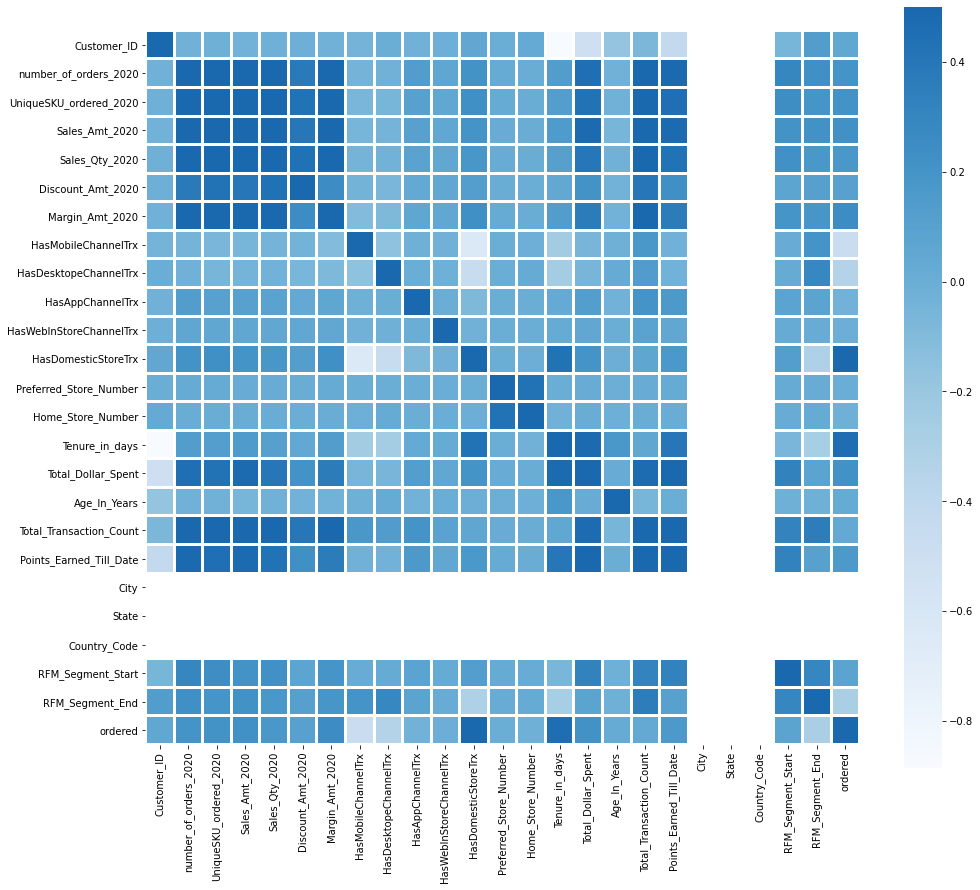

In [16]:
corr = prep_new_data.corr()
plt.figure(figsize=(16, 14))
sns.heatmap(corr, vmax=0.5, center=0,
            square=True, linewidths=2, cmap='Blues')
plt.savefig("heatmap.png")
plt.show()

In [17]:
ordered_CORR = prep_new_data.corr()['ordered']
ordered_CORR

Customer_ID                0.058059
number_of_orders_2020      0.200991
UniqueSKU_ordered_2020     0.208396
Sales_Amt_2020             0.219557
Sales_Qty_2020             0.180548
Discount_Amt_2020          0.098774
Margin_Amt_2020            0.246613
HasMobileChannelTrx       -0.470881
HasDesktopeChannelTrx     -0.340806
HasAppChannelTrx          -0.033974
HasWebInStoreChannelTrx   -0.006719
HasDomesticStoreTrx        0.757203
Preferred_Store_Number     0.006191
Home_Store_Number         -0.017045
Tenure_in_days             0.461118
Total_Dollar_Spent         0.217831
Age_In_Years               0.027644
Total_Transaction_Count    0.034828
Points_Earned_Till_Date    0.162883
City                            NaN
State                           NaN
Country_Code                    NaN
RFM_Segment_Start          0.075859
RFM_Segment_End           -0.285880
ordered                    1.000000
Name: ordered, dtype: float64

In [18]:
# droping the datetime features
no_dates = prep_new_data.drop(dates_list, axis=1)

corr_drop = ['Customer_ID',
             'Age_In_Years',
             'Total_Transaction_Count',
             'City',
             'State',
             'Country_Code',
             'RFM_Segment_Start',
             'RFM_Segment_End'
            ]

prep = no_dates.drop(corr_drop, axis=1)

prep_CORR = prep.corr()['ordered']
prep_CORR.sort_values( ascending=False)

ordered                    1.000000
HasDomesticStoreTrx        0.757203
Tenure_in_days             0.461118
Margin_Amt_2020            0.246613
Sales_Amt_2020             0.219557
Total_Dollar_Spent         0.217831
UniqueSKU_ordered_2020     0.208396
number_of_orders_2020      0.200991
Sales_Qty_2020             0.180548
Points_Earned_Till_Date    0.162883
Discount_Amt_2020          0.098774
Preferred_Store_Number     0.006191
HasWebInStoreChannelTrx   -0.006719
Home_Store_Number         -0.017045
HasAppChannelTrx          -0.033974
HasDesktopeChannelTrx     -0.340806
HasMobileChannelTrx       -0.470881
Name: ordered, dtype: float64

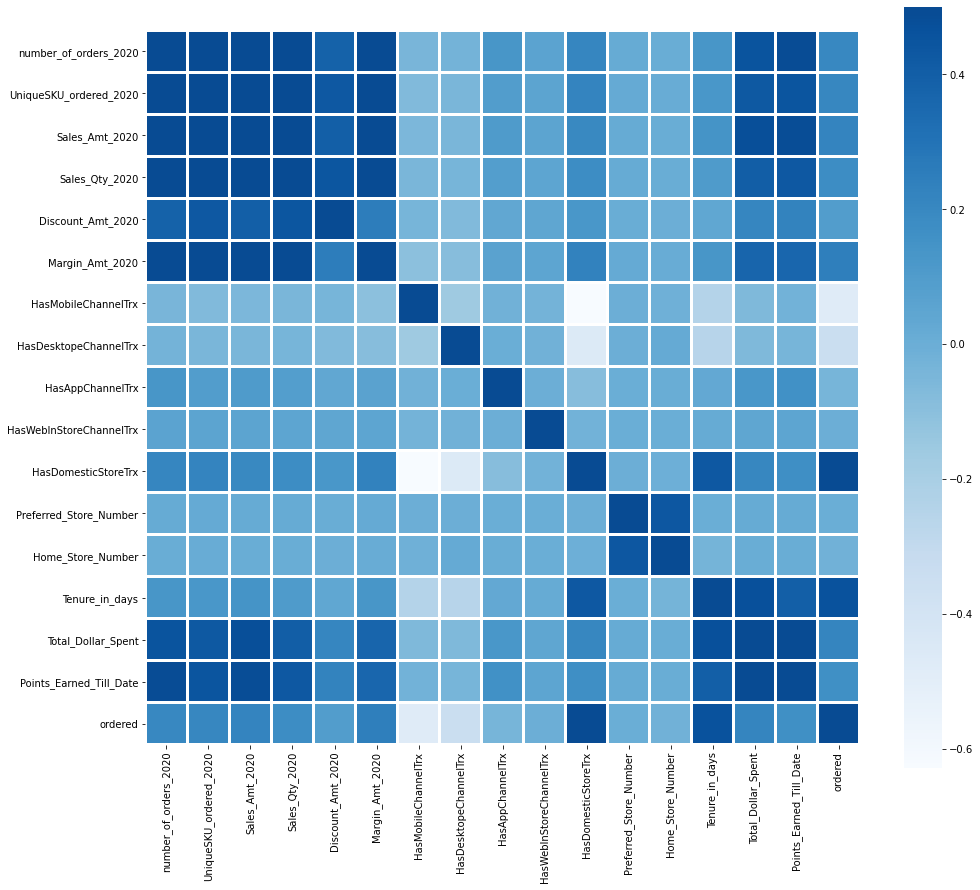

In [19]:
# more_drop = ['Customer_ID', 'City', 'State', 'Country_Code']
# less_data = no_dates.drop(more_drop, axis=1)

corr_new_preped = prep.corr()
plt.figure(figsize=(16, 14))
sns.heatmap(corr_new_preped, vmax=0.5, center=0,
            square=True, linewidths=2, cmap='Blues')
plt.savefig("heatmap.png")
plt.show()

In [20]:
prep_CORR.sort_values( ascending=False)

ordered                    1.000000
HasDomesticStoreTrx        0.757203
Tenure_in_days             0.461118
Margin_Amt_2020            0.246613
Sales_Amt_2020             0.219557
Total_Dollar_Spent         0.217831
UniqueSKU_ordered_2020     0.208396
number_of_orders_2020      0.200991
Sales_Qty_2020             0.180548
Points_Earned_Till_Date    0.162883
Discount_Amt_2020          0.098774
Preferred_Store_Number     0.006191
HasWebInStoreChannelTrx   -0.006719
Home_Store_Number         -0.017045
HasAppChannelTrx          -0.033974
HasDesktopeChannelTrx     -0.340806
HasMobileChannelTrx       -0.470881
Name: ordered, dtype: float64

In [23]:
prep_no_nans = prep.fillna(0)

In [26]:
prep_no_nans.profile_report()

Summarize dataset:   0%|          | 0/40 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [31]:
# RANDOM FOREST REGRESSOR MODEL

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error

# predictors only if > 0,1 or < -0,1
predictors_RF = prep_no_nans[['HasDomesticStoreTrx',
                      'Tenure_in_days',
                      'Margin_Amt_2020',
                      "Sales_Amt_2020",
                      'UniqueSKU_ordered_2020',
                      'number_of_orders_2020',
                      'Sales_Qty_2020',
                      'Points_Earned_Till_Date',
                      'HasDesktopeChannelTrx',
                      'HasMobileChannelTrx']]


targets_RF = prep_no_nans.ordered

X_train, X_test, y_train, y_test  =   train_test_split(predictors_RF, targets_RF, test_size=0.3)

print( "Predictor - Training : ", X_train.shape, "Predictor - Testing : ", X_test.shape )

# np.nan_to_num

forest_model_RF = RandomForestRegressor(random_state=1)
forest_model_RF = forest_model_RF.fit(X_train, y_train)
prop_preds_new = forest_model_RF.predict(X_test)
print("mean absolute error: ", mean_absolute_error(y_test, prop_preds_new))



Predictor - Training :  (140000, 10) Predictor - Testing :  (60000, 10)


C:\Users\Marin\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


mean absolute error:  0.054009652364779996


In [32]:

# Classifier
# Create Decision Tree regressor object
clf_2 = DecisionTreeRegressor(criterion='mae',
                              max_depth=6,
                              min_samples_split=0.1,
                              min_samples_leaf=0.1,
                              presort=True)

# Train Decision Tree Classifer
clf_2 = clf_2.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf_2.predict(X_test)

tree_score=clf_2.score(X_test, y_test)
print("score: ", tree_score)

score:  0.48685534078242665


In [33]:
dot_data = StringIO()
export_graphviz(clf_2, out_file='tree_limited.dot',  
                filled=True,
                rounded=True,
                special_characters=True,
                feature_names = predictors_RF.columns,
                class_names=['HasDomesticStoreTrx',
                             'UniqueSKU_ordered_2020',
                             'UniqueSKU_ordered_2020',
                             "number_of_orders_2020",
                             'Sales_Qty_2020',
                             'Sales_Amt_2020',
                             'HasMobileChannelTrx'],
                rotate = False)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
#graph.write_png('Dyrvo.png')

!dot -Tpng tree_limited.dot -o tree_limited11.png -Gdpi=600

Image(graph.create_png("C:/Users/Marin/Desktop/GME II/notebooks/tree_limited03.png"))

Image(filename = 'tree_limited12.png')


^
Expected {'graph' | 'digraph'} (at char 0), (line:1, col:1)


AttributeError: 'NoneType' object has no attribute 'create_png'

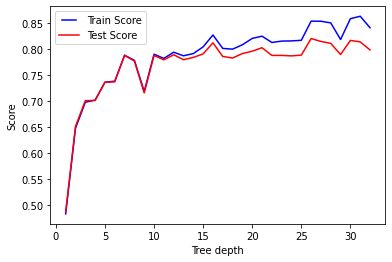

In [34]:
# TODO later
"""

max_depths = np.linspace(1, 32, 32, endpoint=True)
# max_depths = np.linspace(1, 32, 32, endpoint=True)
train_results = []
test_results = []
for max_depth in max_depths:
    clf_3 = DecisionTreeRegressor(criterion='mae',max_depth=max_depth,presort=True)
    clf_3 = clf_3.fit(X_train,y_train)
    y_pred = clf_3.predict(X_train)
    tree_score=clf_3.score(X_train, y_train)
   # Add auc score to previous train results
    train_results.append(tree_score)   

    y_pred = clf_3.predict(X_test)
    tree_score=clf_3.score(X_test, y_test)
   # Add auc score to previous test results
    test_results.append(tree_score)
    
from matplotlib.legend_handler import HandlerLine2D
line1, = plt.plot(max_depths, train_results, 'b', label='Train Score')
line2, = plt.plot(max_depths, test_results, 'r', label='Test Score')
plt.legend(handler_map={line1: HandlerLine2D(numpoints=2)})
plt.ylabel('Score')
plt.xlabel('Tree depth')
plt.show()

"""


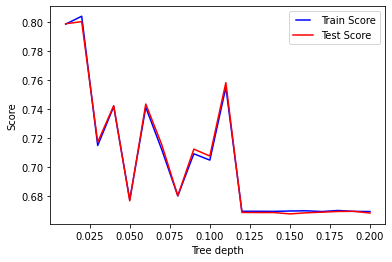

In [35]:
# TODO later
"""

min_samples_splits = np.linspace(0.01, 0.2, 20, endpoint=True)
train_results = []
test_results = []
for min_samples_split in min_samples_splits:
    clf_2 = DecisionTreeRegressor(criterion='mae',
                                  min_samples_split=min_samples_split,
                                  presort=True)
    clf_2 = clf_2.fit(X_train,y_train)
    y_pred = clf_2.predict(X_train)
    tree_score=clf_2.score(X_train, y_train)
   # Add auc score to previous train results
    train_results.append(tree_score)   

    y_pred = clf_2.predict(X_test)
    tree_score=clf_2.score(X_test, y_test)
   # Add auc score to previous test results
    test_results.append(tree_score)
    
line3, = plt.plot(min_samples_splits, train_results, 'b', label='Train Score')
line4, = plt.plot(min_samples_splits, test_results, 'r', label='Test Score')
plt.legend(handler_map={line3: HandlerLine2D(numpoints=2)})
plt.ylabel('Score')
plt.xlabel('Tree depth')
plt.show()

"""


In [ ]:
""""""
min_samples_leafs = np.linspace(0.01, 0.1, 10, endpoint=True)
train_results = []
test_results = []
for min_samples_leaf in min_samples_leafs:
    clf_5 = DecisionTreeRegressor(criterion='mae',
                                  min_samples_leaf=min_samples_leaf,
                                  presort=True)
    clf_5 = clf_5.fit(X_train,y_train)
    y_pred = clf_5.predict(X_train)
    tree_score=clf_5.score(X_train, y_train)
   # Add auc score to previous train results
    train_results.append(tree_score)   

    y_pred = clf_5.predict(X_test)
    tree_score=clf_5.score(X_test, y_test)
   # Add auc score to previous test results
    test_results.append(tree_score)

line5, = plt.plot(min_samples_leafs, train_results, 'b', label='Train Score')
line6, = plt.plot(min_samples_leafs, test_results, 'r', label='Test Score')
plt.legend(handler_map={line5: HandlerLine2D(numpoints=2)})
plt.ylabel('Score')
plt.xlabel('Tree depth')
plt.show()

In [ ]:
from sklearn.metrics import mean_absolute_error, r2_score

rsq = r2_score(y_test, y_pred)

maerr = mean_absolute_error(y_test, y_pred)

print("mean absolute error: ", maerr)
print("R squared: ", rsq)

In [ ]:
feature_cols = predictors_RF.columns

# Using those arrays, we can parse the tree structure:
n_nodes = clf_2.tree_.node_count
children_left = clf_2.tree_.children_left
children_right = clf_2.tree_.children_right
feature = clf_2.tree_.feature
threshold = clf_2.tree_.threshold

# The tree structure can be traversed to compute various properties such
# as the depth of each node and whether or not it is a leaf.
node_depth = np.zeros(shape=n_nodes, dtype=np.int64)
is_leaves = np.zeros(shape=n_nodes, dtype=bool)
stack = [(0, -1)]  # seed is the root node id and its parent depth
while len(stack) > 0:
    node_id, parent_depth = stack.pop()
    node_depth[node_id] = parent_depth + 1

    # If we have a test node
    if (children_left[node_id] != children_right[node_id]):
        stack.append((children_left[node_id], parent_depth + 1))
        stack.append((children_right[node_id], parent_depth + 1))
    else:
        is_leaves[node_id] = True

print("The binary tree structure has %s nodes and has "
      "the following tree structure:"
      % n_nodes)
for i in range(n_nodes):
    if is_leaves[i]:
        print("%snode=%s leaf node." % (node_depth[i] * "\t", i))
    else:
        #print("%snode=%s test node: go to node %s if X[:, %s] <= %s else to "
        #      "node %s."
        print("%snode=%s test node: go to node %s if %s <= %s else to "
              "node %s."
              % (node_depth[i] * "\t",
                 i,
                 children_left[i],
                 feature_cols[feature[i]],
                 threshold[i],
                 children_right[i],
                 ))
print()

In [42]:
# First let's retrieve the decision path of each sample. The decision_path
# method allows to retrieve the node indicator functions. A non zero element of
# indicator matrix at the position (i, j) indicates that the sample i goes
# through the node j.
node_indicator = clf_2.decision_path(X_test)

# Similarly, we can also have the leaves ids reached by each sample.
leave_id = clf_2.apply(X_test)

# Now, it's possible to get the tests that were used to predict a sample or
# a group of samples. First, let's make it for the sample.

for sample_id in range(0,10000):
    node_index = node_indicator.indices[node_indicator.indptr[sample_id]:
                                        node_indicator.indptr[sample_id + 1]]

    print('Rules used to predict sample %s: ' % sample_id)
    for node_id in node_index:
        if leave_id[sample_id] == node_id:
            continue

        if (X_test.iloc[sample_id, feature[node_id]] <= threshold[node_id]):
            threshold_sign = "<="

        else:
            threshold_sign = ">"

        print("decision id node %s : %s, %s (= %s) %s %s)"
              % (node_id,
                 sample_id,
                 feature_cols[feature[node_id]],
                 X_test.iloc[sample_id, feature[node_id]],
                 threshold_sign,
                 threshold[node_id]))

Rules used to predict sample 0: 
decision id node 0 : 0, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 0, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 0, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 0, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 0, UniqueSKU_ordered_2020 (= 4) <= 26.0)
decision id node 5 : 0, Margin_Amt_2020 (= 17.86) <= 239.7949981689453)
decision id node 6 : 0, Sales_Amt_2020 (= 78.96) <= 224.98500061035156)
decision id node 7 : 0, Sales_Amt_2020 (= 78.96) <= 221.44000244140625)
decision id node 8 : 0, Margin_Amt_2020 (= 17.86) > -42.084999084472656)
decision id node 10 : 0, Sales_Qty_2020 (= 4.0) <= 11.5)
decision id node 11 : 0, Sales_Amt_2020 (= 78.96) <= 204.95999908447266)
decision id node 12 : 0, Margin_Amt_2020 (= 17.86) > -27.005000114440918)
decision id node 14 : 0, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 0, Sales_Qty_2020 (= 4.0) <= 6.049999952316284)
decision id node 16 : 0, Points_Earned_Til

decision id node 62 : 50, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 50, Tenure_in_days (= 3726.0) > 670.5)
decision id node 66 : 50, Margin_Amt_2020 (= 12.62) > -111.42499923706055)
decision id node 68 : 50, Points_Earned_Till_Date (= 30000.0) > 200.0)
decision id node 70 : 50, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 50, Tenure_in_days (= 3726.0) > 671.5)
decision id node 73 : 50, Points_Earned_Till_Date (= 30000.0) > 310.0)
decision id node 75 : 50, Points_Earned_Till_Date (= 30000.0) > 325.0)
decision id node 77 : 50, Tenure_in_days (= 3726.0) > 682.5)
decision id node 79 : 50, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 50, Margin_Amt_2020 (= 12.62) > -55.7549991607666)
decision id node 82 : 50, Tenure_in_days (= 3726.0) > 685.5)
decision id node 84 : 50, Sales_Amt_2020 (= 19.99) > 16.954999923706055)
decision id node 86 : 50, Margin_Amt_2020 (= 12.62) > -20.020000457763672)
decision id node 88 : 50, Sales_Am

decision id node 104 : 78, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 78, Sales_Amt_2020 (= 45.97) > 17.530000686645508)
Rules used to predict sample 79: 
decision id node 0 : 79, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 79, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 79, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 79, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 79, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 79, Margin_Amt_2020 (= 7.49) <= 239.7949981689453)
decision id node 6 : 79, Sales_Amt_2020 (= 14.99) <= 224.98500061035156)
decision id node 7 : 79, Sales_Amt_2020 (= 14.99) <= 221.44000244140625)
decision id node 8 : 79, Margin_Amt_2020 (= 7.49) > -42.084999084472656)
decision id node 10 : 79, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 79, Sales_Amt_2020 (= 14.99) <= 204.95999908447266)
decision id node 12 : 79, Margin_Amt_2020 (= 7.49) > -27.005000114440918)
decision id node 14 : 

decision id node 58 : 111, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 111, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 111, Margin_Amt_2020 (= 4.41) > -117.2400016784668)
decision id node 62 : 111, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 111, Tenure_in_days (= 3182.0) > 670.5)
decision id node 66 : 111, Margin_Amt_2020 (= 4.41) > -111.42499923706055)
decision id node 68 : 111, Points_Earned_Till_Date (= 73920.0) > 200.0)
decision id node 70 : 111, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 111, Tenure_in_days (= 3182.0) > 671.5)
decision id node 73 : 111, Points_Earned_Till_Date (= 73920.0) > 310.0)
decision id node 75 : 111, Points_Earned_Till_Date (= 73920.0) > 325.0)
decision id node 77 : 111, Tenure_in_days (= 3182.0) > 682.5)
decision id node 79 : 111, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 111, Margin_Amt_2020 (= 4.41) > -55.7549991607666)
decision id node 82 : 111

decision id node 94 : 141, Margin_Amt_2020 (= 7.75) > -16.145000457763672)
decision id node 96 : 141, Margin_Amt_2020 (= 7.75) > -14.944999694824219)
decision id node 98 : 141, Tenure_in_days (= 3738.0) > 717.5)
decision id node 100 : 141, Margin_Amt_2020 (= 7.75) > -10.369999885559082)
decision id node 102 : 141, Tenure_in_days (= 3738.0) > 767.5)
decision id node 104 : 141, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 141, Sales_Amt_2020 (= 26.99) > 17.530000686645508)
Rules used to predict sample 142: 
decision id node 0 : 142, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 142, Sales_Qty_2020 (= 17.0) > -0.6650000065565109)
decision id node 54 : 142, Sales_Amt_2020 (= 682.4) > -709.8450012207031)
decision id node 56 : 142, Sales_Amt_2020 (= 682.4) > 0.004999999888241291)
decision id node 58 : 142, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 142, Sales_Qty_2020 (= 17.0) > 7.585000038146973)
Rules used to predict sample 143: 
decision id node 0 : 

decision id node 15 : 191, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 191, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 191, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 191, Margin_Amt_2020 (= 2.52) > -24.270000457763672)
decision id node 20 : 191, Margin_Amt_2020 (= 2.52) > -19.015000343322754)
decision id node 22 : 191, Margin_Amt_2020 (= 2.52) > -18.035000801086426)
decision id node 24 : 191, Margin_Amt_2020 (= 2.52) <= 122.89500045776367)
decision id node 25 : 191, Margin_Amt_2020 (= 2.52) <= 121.66500091552734)
decision id node 26 : 191, Margin_Amt_2020 (= 2.52) <= 22.675000190734863)
decision id node 27 : 191, Margin_Amt_2020 (= 2.52) <= 22.494999885559082)
decision id node 28 : 191, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 191, Margin_Amt_2020 (= 2.52) > -11.3100004196167)
decision id node 31 : 191, Margin_Amt_2020 (= 2.52) > 0.23499999940395355)
Rules used to predict sample 192: 
decision i

decision id node 5 : 215, Margin_Amt_2020 (= 12.73) <= 239.7949981689453)
decision id node 6 : 215, Sales_Amt_2020 (= 59.98) <= 224.98500061035156)
decision id node 7 : 215, Sales_Amt_2020 (= 59.98) <= 221.44000244140625)
decision id node 8 : 215, Margin_Amt_2020 (= 12.73) > -42.084999084472656)
decision id node 10 : 215, Sales_Qty_2020 (= 2.0) <= 11.5)
decision id node 11 : 215, Sales_Amt_2020 (= 59.98) <= 204.95999908447266)
decision id node 12 : 215, Margin_Amt_2020 (= 12.73) > -27.005000114440918)
decision id node 14 : 215, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 215, Sales_Qty_2020 (= 2.0) <= 6.049999952316284)
decision id node 16 : 215, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 215, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 215, Margin_Amt_2020 (= 12.73) > -24.270000457763672)
decision id node 20 : 215, Margin_Amt_2020 (= 12.73) > -19.015000343322754)
decision id node 22 : 215, Margin_Amt_2020 (= 12.73) > -18.0350008010

decision id node 56 : 239, Sales_Amt_2020 (= 54.98) > 0.004999999888241291)
decision id node 58 : 239, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 239, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 239, Margin_Amt_2020 (= 36.93) > -117.2400016784668)
decision id node 62 : 239, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 239, Tenure_in_days (= 1880.0) > 670.5)
decision id node 66 : 239, Margin_Amt_2020 (= 36.93) > -111.42499923706055)
decision id node 68 : 239, Points_Earned_Till_Date (= 5000.0) > 200.0)
decision id node 70 : 239, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 239, Tenure_in_days (= 1880.0) > 671.5)
decision id node 73 : 239, Points_Earned_Till_Date (= 5000.0) > 310.0)
decision id node 75 : 239, Points_Earned_Till_Date (= 5000.0) > 325.0)
decision id node 77 : 239, Tenure_in_days (= 1880.0) > 682.5)
decision id node 79 : 239, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 2

decision id node 54 : 260, Sales_Amt_2020 (= 122.0) > -709.8450012207031)
decision id node 56 : 260, Sales_Amt_2020 (= 122.0) > 0.004999999888241291)
decision id node 58 : 260, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 260, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 260, Margin_Amt_2020 (= 14.86) > -117.2400016784668)
decision id node 62 : 260, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 260, Tenure_in_days (= 3470.0) > 670.5)
decision id node 66 : 260, Margin_Amt_2020 (= 14.86) > -111.42499923706055)
decision id node 68 : 260, Points_Earned_Till_Date (= 173716.0) > 200.0)
decision id node 70 : 260, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 260, Tenure_in_days (= 3470.0) > 671.5)
decision id node 73 : 260, Points_Earned_Till_Date (= 173716.0) > 310.0)
decision id node 75 : 260, Points_Earned_Till_Date (= 173716.0) > 325.0)
decision id node 77 : 260, Tenure_in_days (= 3470.0) > 682.5)
decision id nod

decision id node 68 : 281, Points_Earned_Till_Date (= 35000.0) > 200.0)
decision id node 70 : 281, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 281, Tenure_in_days (= 3725.0) > 671.5)
decision id node 73 : 281, Points_Earned_Till_Date (= 35000.0) > 310.0)
decision id node 75 : 281, Points_Earned_Till_Date (= 35000.0) > 325.0)
decision id node 77 : 281, Tenure_in_days (= 3725.0) > 682.5)
decision id node 79 : 281, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 281, Margin_Amt_2020 (= 29.77) > -55.7549991607666)
decision id node 82 : 281, Tenure_in_days (= 3725.0) > 685.5)
decision id node 84 : 281, Sales_Amt_2020 (= 54.99) > 16.954999923706055)
decision id node 86 : 281, Margin_Amt_2020 (= 29.77) > -20.020000457763672)
decision id node 88 : 281, Sales_Amt_2020 (= 54.99) > 16.964999198913574)
decision id node 90 : 281, Sales_Amt_2020 (= 54.99) > 17.3100004196167)
decision id node 92 : 281, Margin_Amt_2020 (= 29.77) > -18.619999885559082)
decision

decision id node 104 : 307, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 307, Sales_Amt_2020 (= 25.98) > 17.530000686645508)
Rules used to predict sample 308: 
decision id node 0 : 308, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 308, Sales_Qty_2020 (= 15.0) > -0.6650000065565109)
decision id node 54 : 308, Sales_Amt_2020 (= 153.94) > -709.8450012207031)
decision id node 56 : 308, Sales_Amt_2020 (= 153.94) > 0.004999999888241291)
decision id node 58 : 308, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 308, Sales_Qty_2020 (= 15.0) > 7.585000038146973)
Rules used to predict sample 309: 
decision id node 0 : 309, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 309, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 309, Sales_Amt_2020 (= 12.99) > -709.8450012207031)
decision id node 56 : 309, Sales_Amt_2020 (= 12.99) > 0.004999999888241291)
decision id node 58 : 309, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 309

decision id node 26 : 340, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 340, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 340, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 340, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 340, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 341: 
decision id node 0 : 341, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 341, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 341, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 341, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 341, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 341, Margin_Amt_2020 (= 3.25) <= 239.7949981689453)
decision id node 6 : 341, Sales_Amt_2020 (= 24.99) <= 224.98500061035156)
decision id node 7 : 341, Sales_Amt_2020 (= 24.99) <= 221.44000244140625)
decision id node 8 : 341, Margin_Amt_2020 (= 3.25) > -42.08499

decision id node 60 : 364, Margin_Amt_2020 (= 6.74) > -117.2400016784668)
decision id node 62 : 364, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 364, Tenure_in_days (= 2155.0) > 670.5)
decision id node 66 : 364, Margin_Amt_2020 (= 6.74) > -111.42499923706055)
decision id node 68 : 364, Points_Earned_Till_Date (= 117014.0) > 200.0)
decision id node 70 : 364, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 364, Tenure_in_days (= 2155.0) > 671.5)
decision id node 73 : 364, Points_Earned_Till_Date (= 117014.0) > 310.0)
decision id node 75 : 364, Points_Earned_Till_Date (= 117014.0) > 325.0)
decision id node 77 : 364, Tenure_in_days (= 2155.0) > 682.5)
decision id node 79 : 364, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 364, Margin_Amt_2020 (= 6.74) > -55.7549991607666)
decision id node 82 : 364, Tenure_in_days (= 2155.0) > 685.5)
decision id node 84 : 364, Sales_Amt_2020 (= 18.99) > 16.954999923706055)
decision id node 86 :

decision id node 73 : 397, Points_Earned_Till_Date (= 5000.0) > 310.0)
decision id node 75 : 397, Points_Earned_Till_Date (= 5000.0) > 325.0)
decision id node 77 : 397, Tenure_in_days (= 1207.0) > 682.5)
decision id node 79 : 397, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 397, Margin_Amt_2020 (= 18.0) > -55.7549991607666)
decision id node 82 : 397, Tenure_in_days (= 1207.0) > 685.5)
decision id node 84 : 397, Sales_Amt_2020 (= 59.99) > 16.954999923706055)
decision id node 86 : 397, Margin_Amt_2020 (= 18.0) > -20.020000457763672)
decision id node 88 : 397, Sales_Amt_2020 (= 59.99) > 16.964999198913574)
decision id node 90 : 397, Sales_Amt_2020 (= 59.99) > 17.3100004196167)
decision id node 92 : 397, Margin_Amt_2020 (= 18.0) > -18.619999885559082)
decision id node 94 : 397, Margin_Amt_2020 (= 18.0) > -16.145000457763672)
decision id node 96 : 397, Margin_Amt_2020 (= 18.0) > -14.944999694824219)
decision id node 98 : 397, Tenure_in_days (= 1207.0) > 717.5)
decisio

decision id node 52 : 450, Sales_Qty_2020 (= 7.0) > -0.6650000065565109)
decision id node 54 : 450, Sales_Amt_2020 (= 89.95) > -709.8450012207031)
decision id node 56 : 450, Sales_Amt_2020 (= 89.95) > 0.004999999888241291)
decision id node 58 : 450, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 450, Sales_Qty_2020 (= 7.0) <= 7.585000038146973)
decision id node 60 : 450, Margin_Amt_2020 (= 56.03) > -117.2400016784668)
decision id node 62 : 450, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 450, Tenure_in_days (= 3569.0) > 670.5)
decision id node 66 : 450, Margin_Amt_2020 (= 56.03) > -111.42499923706055)
decision id node 68 : 450, Points_Earned_Till_Date (= 138936.0) > 200.0)
decision id node 70 : 450, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 451: 
decision id node 0 : 451, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 451, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 451, Sales_Amt_2020 (= 8

decision id node 7 : 501, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 501, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 501, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 501, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 501, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 501, Tenure_in_days (= 53.0) <= 322.5)
decision id node 15 : 501, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 501, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 501, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 501, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 501, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 501, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 501, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 501, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)


decision id node 77 : 550, Tenure_in_days (= 2124.0) > 682.5)
decision id node 79 : 550, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 550, Margin_Amt_2020 (= 0.0) > -55.7549991607666)
decision id node 82 : 550, Tenure_in_days (= 2124.0) > 685.5)
decision id node 84 : 550, Sales_Amt_2020 (= 50.0) > 16.954999923706055)
decision id node 86 : 550, Margin_Amt_2020 (= 0.0) > -20.020000457763672)
decision id node 88 : 550, Sales_Amt_2020 (= 50.0) > 16.964999198913574)
decision id node 90 : 550, Sales_Amt_2020 (= 50.0) > 17.3100004196167)
decision id node 92 : 550, Margin_Amt_2020 (= 0.0) > -18.619999885559082)
decision id node 94 : 550, Margin_Amt_2020 (= 0.0) > -16.145000457763672)
decision id node 96 : 550, Margin_Amt_2020 (= 0.0) > -14.944999694824219)
decision id node 98 : 550, Tenure_in_days (= 2124.0) > 717.5)
decision id node 100 : 550, Margin_Amt_2020 (= 0.0) > -10.369999885559082)
decision id node 102 : 550, Tenure_in_days (= 2124.0) > 767.5)
decision id node 10

decision id node 54 : 596, Sales_Amt_2020 (= 77.98) > -709.8450012207031)
decision id node 56 : 596, Sales_Amt_2020 (= 77.98) > 0.004999999888241291)
decision id node 58 : 596, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 596, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 596, Margin_Amt_2020 (= 33.71) > -117.2400016784668)
decision id node 62 : 596, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 596, Tenure_in_days (= 1618.0) > 670.5)
decision id node 66 : 596, Margin_Amt_2020 (= 33.71) > -111.42499923706055)
decision id node 68 : 596, Points_Earned_Till_Date (= 7260.0) > 200.0)
decision id node 70 : 596, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 596, Tenure_in_days (= 1618.0) > 671.5)
decision id node 73 : 596, Points_Earned_Till_Date (= 7260.0) > 310.0)
decision id node 75 : 596, Points_Earned_Till_Date (= 7260.0) > 325.0)
decision id node 77 : 596, Tenure_in_days (= 1618.0) > 682.5)
decision id node 79 :

decision id node 62 : 648, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 648, Tenure_in_days (= 1046.0) > 670.5)
decision id node 66 : 648, Margin_Amt_2020 (= 37.44) > -111.42499923706055)
decision id node 68 : 648, Points_Earned_Till_Date (= 3510.0) > 200.0)
decision id node 70 : 648, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 648, Tenure_in_days (= 1046.0) > 671.5)
decision id node 73 : 648, Points_Earned_Till_Date (= 3510.0) > 310.0)
decision id node 75 : 648, Points_Earned_Till_Date (= 3510.0) > 325.0)
decision id node 77 : 648, Tenure_in_days (= 1046.0) > 682.5)
decision id node 79 : 648, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 648, Margin_Amt_2020 (= 37.44) > -55.7549991607666)
decision id node 82 : 648, Tenure_in_days (= 1046.0) > 685.5)
decision id node 84 : 648, Sales_Amt_2020 (= 56.96) > 16.954999923706055)
decision id node 86 : 648, Margin_Amt_2020 (= 37.44) > -20.020000457763672)
decision id node 88 : 6

Rules used to predict sample 695: 
decision id node 0 : 695, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 695, Sales_Qty_2020 (= 7.0) > -0.6650000065565109)
decision id node 54 : 695, Sales_Amt_2020 (= 126.5) > -709.8450012207031)
decision id node 56 : 695, Sales_Amt_2020 (= 126.5) > 0.004999999888241291)
decision id node 58 : 695, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 695, Sales_Qty_2020 (= 7.0) <= 7.585000038146973)
decision id node 60 : 695, Margin_Amt_2020 (= 30.5) > -117.2400016784668)
decision id node 62 : 695, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 695, Tenure_in_days (= 1461.0) > 670.5)
decision id node 66 : 695, Margin_Amt_2020 (= 30.5) > -111.42499923706055)
decision id node 68 : 695, Points_Earned_Till_Date (= 20660.0) > 200.0)
decision id node 70 : 695, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 696: 
decision id node 0 : 696, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 696, S

decision id node 25 : 745, Margin_Amt_2020 (= 7.17) <= 121.66500091552734)
decision id node 26 : 745, Margin_Amt_2020 (= 7.17) <= 22.675000190734863)
decision id node 27 : 745, Margin_Amt_2020 (= 7.17) <= 22.494999885559082)
decision id node 28 : 745, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 745, Margin_Amt_2020 (= 7.17) > -11.3100004196167)
decision id node 31 : 745, Margin_Amt_2020 (= 7.17) > 0.23499999940395355)
Rules used to predict sample 746: 
decision id node 0 : 746, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 746, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 746, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 746, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 746, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 746, Margin_Amt_2020 (= 3.78) <= 239.7949981689453)
decision id node 6 : 746, Sales_Amt_2020 (= 30.0) <= 224.98500061035156)
decision id node 7 : 746, Sales_Amt_2020 (= 30.0) <= 221.44000

decision id node 75 : 795, Points_Earned_Till_Date (= 18240.0) > 325.0)
decision id node 77 : 795, Tenure_in_days (= 895.0) > 682.5)
decision id node 79 : 795, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 795, Margin_Amt_2020 (= 2.34) > -55.7549991607666)
decision id node 82 : 795, Tenure_in_days (= 895.0) > 685.5)
decision id node 84 : 795, Sales_Amt_2020 (= 2.34) <= 16.954999923706055)
Rules used to predict sample 796: 
decision id node 0 : 796, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 796, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 796, Sales_Amt_2020 (= 13.94) > -709.8450012207031)
decision id node 56 : 796, Sales_Amt_2020 (= 13.94) > 0.004999999888241291)
decision id node 58 : 796, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 796, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 796, Margin_Amt_2020 (= 4.49) > -117.2400016784668)
decision id node 62 : 796, Sales_Qty_2020 (= 2.0) > 0.8350000

decision id node 70 : 846, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 846, Tenure_in_days (= 3574.0) > 671.5)
decision id node 73 : 846, Points_Earned_Till_Date (= 9260.0) > 310.0)
decision id node 75 : 846, Points_Earned_Till_Date (= 9260.0) > 325.0)
decision id node 77 : 846, Tenure_in_days (= 3574.0) > 682.5)
decision id node 79 : 846, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 846, Margin_Amt_2020 (= 8.99) > -55.7549991607666)
decision id node 82 : 846, Tenure_in_days (= 3574.0) > 685.5)
decision id node 84 : 846, Sales_Amt_2020 (= 24.99) > 16.954999923706055)
decision id node 86 : 846, Margin_Amt_2020 (= 8.99) > -20.020000457763672)
decision id node 88 : 846, Sales_Amt_2020 (= 24.99) > 16.964999198913574)
decision id node 90 : 846, Sales_Amt_2020 (= 24.99) > 17.3100004196167)
decision id node 92 : 846, Margin_Amt_2020 (= 8.99) > -18.619999885559082)
decision id node 94 : 846, Margin_Amt_2020 (= 8.99) > -16.145000457763672)
decision i

decision id node 66 : 893, Margin_Amt_2020 (= 8.96) > -111.42499923706055)
decision id node 68 : 893, Points_Earned_Till_Date (= 10000.0) > 200.0)
decision id node 70 : 893, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 893, Tenure_in_days (= 2054.0) > 671.5)
decision id node 73 : 893, Points_Earned_Till_Date (= 10000.0) > 310.0)
decision id node 75 : 893, Points_Earned_Till_Date (= 10000.0) > 325.0)
decision id node 77 : 893, Tenure_in_days (= 2054.0) > 682.5)
decision id node 79 : 893, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 893, Margin_Amt_2020 (= 8.96) > -55.7549991607666)
decision id node 82 : 893, Tenure_in_days (= 2054.0) > 685.5)
decision id node 84 : 893, Sales_Amt_2020 (= 19.99) > 16.954999923706055)
decision id node 86 : 893, Margin_Amt_2020 (= 8.96) > -20.020000457763672)
decision id node 88 : 893, Sales_Amt_2020 (= 19.99) > 16.964999198913574)
decision id node 90 : 893, Sales_Amt_2020 (= 19.99) > 17.3100004196167)
decision id

decision id node 88 : 942, Sales_Amt_2020 (= 125.97) > 16.964999198913574)
decision id node 90 : 942, Sales_Amt_2020 (= 125.97) > 17.3100004196167)
decision id node 92 : 942, Margin_Amt_2020 (= 42.96) > -18.619999885559082)
decision id node 94 : 942, Margin_Amt_2020 (= 42.96) > -16.145000457763672)
decision id node 96 : 942, Margin_Amt_2020 (= 42.96) > -14.944999694824219)
decision id node 98 : 942, Tenure_in_days (= 2725.0) > 717.5)
decision id node 100 : 942, Margin_Amt_2020 (= 42.96) > -10.369999885559082)
decision id node 102 : 942, Tenure_in_days (= 2725.0) > 767.5)
decision id node 104 : 942, UniqueSKU_ordered_2020 (= 3) <= 3.5)
decision id node 105 : 942, Sales_Amt_2020 (= 125.97) > 17.530000686645508)
Rules used to predict sample 943: 
decision id node 0 : 943, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 943, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 943, Sales_Amt_2020 (= 1.26) > -709.8450012207031)
decision id node 56 : 943, Sales_Amt_2020

decision id node 6 : 990, Sales_Amt_2020 (= 20.0) <= 224.98500061035156)
decision id node 7 : 990, Sales_Amt_2020 (= 20.0) <= 221.44000244140625)
decision id node 8 : 990, Margin_Amt_2020 (= 2.6) > -42.084999084472656)
decision id node 10 : 990, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 990, Sales_Amt_2020 (= 20.0) <= 204.95999908447266)
decision id node 12 : 990, Margin_Amt_2020 (= 2.6) > -27.005000114440918)
decision id node 14 : 990, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 990, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 990, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 990, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 990, Margin_Amt_2020 (= 2.6) > -24.270000457763672)
decision id node 20 : 990, Margin_Amt_2020 (= 2.6) > -19.015000343322754)
decision id node 22 : 990, Margin_Amt_2020 (= 2.6) > -18.035000801086426)
decision id node 24 : 990, Margin_Amt_2020 (= 2.6) <= 122.89500045776367)
decisi

decision id node 77 : 1041, Tenure_in_days (= 3620.0) > 682.5)
decision id node 79 : 1041, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 1041, Margin_Amt_2020 (= 17.98) > -55.7549991607666)
decision id node 82 : 1041, Tenure_in_days (= 3620.0) > 685.5)
decision id node 84 : 1041, Sales_Amt_2020 (= 89.98) > 16.954999923706055)
decision id node 86 : 1041, Margin_Amt_2020 (= 17.98) > -20.020000457763672)
decision id node 88 : 1041, Sales_Amt_2020 (= 89.98) > 16.964999198913574)
decision id node 90 : 1041, Sales_Amt_2020 (= 89.98) > 17.3100004196167)
decision id node 92 : 1041, Margin_Amt_2020 (= 17.98) > -18.619999885559082)
decision id node 94 : 1041, Margin_Amt_2020 (= 17.98) > -16.145000457763672)
decision id node 96 : 1041, Margin_Amt_2020 (= 17.98) > -14.944999694824219)
decision id node 98 : 1041, Tenure_in_days (= 3620.0) > 717.5)
decision id node 100 : 1041, Margin_Amt_2020 (= 17.98) > -10.369999885559082)
decision id node 102 : 1041, Tenure_in_days (= 3620.0)

decision id node 58 : 1095, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1095, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 1095, Margin_Amt_2020 (= 6.98) > -117.2400016784668)
decision id node 62 : 1095, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 1095, Tenure_in_days (= 400.0) <= 670.5)
Rules used to predict sample 1096: 
decision id node 0 : 1096, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1096, Sales_Qty_2020 (= 5.0) > -0.6650000065565109)
decision id node 54 : 1096, Sales_Amt_2020 (= 481.96) > -709.8450012207031)
decision id node 56 : 1096, Sales_Amt_2020 (= 481.96) > 0.004999999888241291)
decision id node 58 : 1096, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1096, Sales_Qty_2020 (= 5.0) <= 7.585000038146973)
decision id node 60 : 1096, Margin_Amt_2020 (= 196.48) > -117.2400016784668)
decision id node 62 : 1096, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 1096, Tenure_in_day

decision id node 86 : 1141, Margin_Amt_2020 (= 0.99) > -20.020000457763672)
decision id node 88 : 1141, Sales_Amt_2020 (= 24.99) > 16.964999198913574)
decision id node 90 : 1141, Sales_Amt_2020 (= 24.99) > 17.3100004196167)
decision id node 92 : 1141, Margin_Amt_2020 (= 0.99) > -18.619999885559082)
decision id node 94 : 1141, Margin_Amt_2020 (= 0.99) > -16.145000457763672)
decision id node 96 : 1141, Margin_Amt_2020 (= 0.99) > -14.944999694824219)
decision id node 98 : 1141, Tenure_in_days (= 2948.0) > 717.5)
decision id node 100 : 1141, Margin_Amt_2020 (= 0.99) > -10.369999885559082)
decision id node 102 : 1141, Tenure_in_days (= 2948.0) > 767.5)
decision id node 104 : 1141, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 1141, Sales_Amt_2020 (= 24.99) > 17.530000686645508)
Rules used to predict sample 1142: 
decision id node 0 : 1142, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1142, Sales_Qty_2020 (= 9.0) > -0.6650000065565109)
decision id node 54 : 1142, Sale

decision id node 54 : 1190, Sales_Amt_2020 (= 365.94) > -709.8450012207031)
decision id node 56 : 1190, Sales_Amt_2020 (= 365.94) > 0.004999999888241291)
decision id node 58 : 1190, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 1190, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 1190, Margin_Amt_2020 (= 50.69) > -117.2400016784668)
decision id node 62 : 1190, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 1190, Tenure_in_days (= 165.0) <= 670.5)
Rules used to predict sample 1191: 
decision id node 0 : 1191, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1191, Sales_Qty_2020 (= 14.0) > -0.6650000065565109)
decision id node 54 : 1191, Sales_Amt_2020 (= 106.53) > -709.8450012207031)
decision id node 56 : 1191, Sales_Amt_2020 (= 106.53) > 0.004999999888241291)
decision id node 58 : 1191, number_of_orders_2020 (= 7) > 5.5)
Rules used to predict sample 1192: 
decision id node 0 : 1192, HasDomesticStoreTrx (= 0) <= 0.5)
decision id 

decision id node 86 : 1237, Margin_Amt_2020 (= 9.99) > -20.020000457763672)
decision id node 88 : 1237, Sales_Amt_2020 (= 24.99) > 16.964999198913574)
decision id node 90 : 1237, Sales_Amt_2020 (= 24.99) > 17.3100004196167)
decision id node 92 : 1237, Margin_Amt_2020 (= 9.99) > -18.619999885559082)
decision id node 94 : 1237, Margin_Amt_2020 (= 9.99) > -16.145000457763672)
decision id node 96 : 1237, Margin_Amt_2020 (= 9.99) > -14.944999694824219)
decision id node 98 : 1237, Tenure_in_days (= 1135.0) > 717.5)
decision id node 100 : 1237, Margin_Amt_2020 (= 9.99) > -10.369999885559082)
decision id node 102 : 1237, Tenure_in_days (= 1135.0) > 767.5)
decision id node 104 : 1237, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 1237, Sales_Amt_2020 (= 24.99) > 17.530000686645508)
Rules used to predict sample 1238: 
decision id node 0 : 1238, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1238, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 1238, Sale

decision id node 77 : 1282, Tenure_in_days (= 3601.0) > 682.5)
decision id node 79 : 1282, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 1282, Margin_Amt_2020 (= 19.64) > -55.7549991607666)
decision id node 82 : 1282, Tenure_in_days (= 3601.0) > 685.5)
decision id node 84 : 1282, Sales_Amt_2020 (= 87.97) > 16.954999923706055)
decision id node 86 : 1282, Margin_Amt_2020 (= 19.64) > -20.020000457763672)
decision id node 88 : 1282, Sales_Amt_2020 (= 87.97) > 16.964999198913574)
decision id node 90 : 1282, Sales_Amt_2020 (= 87.97) > 17.3100004196167)
decision id node 92 : 1282, Margin_Amt_2020 (= 19.64) > -18.619999885559082)
decision id node 94 : 1282, Margin_Amt_2020 (= 19.64) > -16.145000457763672)
decision id node 96 : 1282, Margin_Amt_2020 (= 19.64) > -14.944999694824219)
decision id node 98 : 1282, Tenure_in_days (= 3601.0) > 717.5)
decision id node 100 : 1282, Margin_Amt_2020 (= 19.64) > -10.369999885559082)
decision id node 102 : 1282, Tenure_in_days (= 3601.0)

decision id node 79 : 1338, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 1338, Margin_Amt_2020 (= 4.96) > -55.7549991607666)
decision id node 82 : 1338, Tenure_in_days (= 3550.0) > 685.5)
decision id node 84 : 1338, Sales_Amt_2020 (= 19.96) > 16.954999923706055)
decision id node 86 : 1338, Margin_Amt_2020 (= 4.96) > -20.020000457763672)
decision id node 88 : 1338, Sales_Amt_2020 (= 19.96) > 16.964999198913574)
decision id node 90 : 1338, Sales_Amt_2020 (= 19.96) > 17.3100004196167)
decision id node 92 : 1338, Margin_Amt_2020 (= 4.96) > -18.619999885559082)
decision id node 94 : 1338, Margin_Amt_2020 (= 4.96) > -16.145000457763672)
decision id node 96 : 1338, Margin_Amt_2020 (= 4.96) > -14.944999694824219)
decision id node 98 : 1338, Tenure_in_days (= 3550.0) > 717.5)
decision id node 100 : 1338, Margin_Amt_2020 (= 4.96) > -10.369999885559082)
decision id node 102 : 1338, Tenure_in_days (= 3550.0) > 767.5)
decision id node 104 : 1338, UniqueSKU_ordered_2020 (= 3) <

decision id node 70 : 1386, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 1386, Tenure_in_days (= 1850.0) > 671.5)
decision id node 73 : 1386, Points_Earned_Till_Date (= 15000.0) > 310.0)
decision id node 75 : 1386, Points_Earned_Till_Date (= 15000.0) > 325.0)
decision id node 77 : 1386, Tenure_in_days (= 1850.0) > 682.5)
decision id node 79 : 1386, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 1386, Margin_Amt_2020 (= 16.01) > -55.7549991607666)
decision id node 82 : 1386, Tenure_in_days (= 1850.0) > 685.5)
decision id node 84 : 1386, Sales_Amt_2020 (= 24.99) > 16.954999923706055)
decision id node 86 : 1386, Margin_Amt_2020 (= 16.01) > -20.020000457763672)
decision id node 88 : 1386, Sales_Amt_2020 (= 24.99) > 16.964999198913574)
decision id node 90 : 1386, Sales_Amt_2020 (= 24.99) > 17.3100004196167)
decision id node 92 : 1386, Margin_Amt_2020 (= 16.01) > -18.619999885559082)
decision id node 94 : 1386, Margin_Amt_2020 (= 16.01) > -16.1450004

decision id node 84 : 1430, Sales_Amt_2020 (= 3.99) <= 16.954999923706055)
Rules used to predict sample 1431: 
decision id node 0 : 1431, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1431, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 1431, Sales_Amt_2020 (= 62.97) > -709.8450012207031)
decision id node 56 : 1431, Sales_Amt_2020 (= 62.97) > 0.004999999888241291)
decision id node 58 : 1431, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1431, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 1431, Margin_Amt_2020 (= 41.96) > -117.2400016784668)
decision id node 62 : 1431, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 1431, Tenure_in_days (= 3509.0) > 670.5)
decision id node 66 : 1431, Margin_Amt_2020 (= 41.96) > -111.42499923706055)
decision id node 68 : 1431, Points_Earned_Till_Date (= 53080.0) > 200.0)
decision id node 70 : 1431, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 1431, Ten

Rules used to predict sample 1485: 
decision id node 0 : 1485, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1485, Sales_Qty_2020 (= 8.0) > -0.6650000065565109)
decision id node 54 : 1485, Sales_Amt_2020 (= 859.92) > -709.8450012207031)
decision id node 56 : 1485, Sales_Amt_2020 (= 859.92) > 0.004999999888241291)
decision id node 58 : 1485, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1485, Sales_Qty_2020 (= 8.0) > 7.585000038146973)
Rules used to predict sample 1486: 
decision id node 0 : 1486, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 1486, Tenure_in_days (= 2145.0) > 350.5)
Rules used to predict sample 1487: 
decision id node 0 : 1487, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1487, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 1487, Sales_Amt_2020 (= 59.99) > -709.8450012207031)
decision id node 56 : 1487, Sales_Amt_2020 (= 59.99) > 0.004999999888241291)
decision id node 58 : 1487, number_of_orders_2020 (= 1) <= 

decision id node 59 : 1543, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 1543, Margin_Amt_2020 (= 46.97) > -117.2400016784668)
decision id node 62 : 1543, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 1543, Tenure_in_days (= 600.0) <= 670.5)
Rules used to predict sample 1544: 
decision id node 0 : 1544, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1544, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 1544, Sales_Amt_2020 (= 56.07) > -709.8450012207031)
decision id node 56 : 1544, Sales_Amt_2020 (= 56.07) > 0.004999999888241291)
decision id node 58 : 1544, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1544, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 1544, Margin_Amt_2020 (= 2.96) > -117.2400016784668)
decision id node 62 : 1544, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 1544, Tenure_in_days (= 30.0) <= 670.5)
Rules used to predict sample 1545: 
decision i

decision id node 98 : 1593, Tenure_in_days (= 956.0) > 717.5)
decision id node 100 : 1593, Margin_Amt_2020 (= 42.92) > -10.369999885559082)
decision id node 102 : 1593, Tenure_in_days (= 956.0) > 767.5)
decision id node 104 : 1593, UniqueSKU_ordered_2020 (= 4) > 3.5)
Rules used to predict sample 1594: 
decision id node 0 : 1594, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1594, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 1594, Sales_Amt_2020 (= 79.98) > -709.8450012207031)
decision id node 56 : 1594, Sales_Amt_2020 (= 79.98) > 0.004999999888241291)
decision id node 58 : 1594, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1594, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 1594, Margin_Amt_2020 (= 22.7) > -117.2400016784668)
decision id node 62 : 1594, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 1594, Tenure_in_days (= 3020.0) > 670.5)
decision id node 66 : 1594, Margin_Amt_2020 (= 22.7) > -111.42

decision id node 3 : 1642, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 1642, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 1642, Margin_Amt_2020 (= 7.56) <= 239.7949981689453)
decision id node 6 : 1642, Sales_Amt_2020 (= 60.0) <= 224.98500061035156)
decision id node 7 : 1642, Sales_Amt_2020 (= 60.0) <= 221.44000244140625)
decision id node 8 : 1642, Margin_Amt_2020 (= 7.56) > -42.084999084472656)
decision id node 10 : 1642, Sales_Qty_2020 (= 3.0) <= 11.5)
decision id node 11 : 1642, Sales_Amt_2020 (= 60.0) <= 204.95999908447266)
decision id node 12 : 1642, Margin_Amt_2020 (= 7.56) > -27.005000114440918)
decision id node 14 : 1642, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 1642, Sales_Qty_2020 (= 3.0) <= 6.049999952316284)
decision id node 16 : 1642, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 1642, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 1642, Margin_Amt_2020 (= 7.56) > -24.270000457763672)
decision id 

decision id node 18 : 1692, Margin_Amt_2020 (= 17.99) > -24.270000457763672)
decision id node 20 : 1692, Margin_Amt_2020 (= 17.99) > -19.015000343322754)
decision id node 22 : 1692, Margin_Amt_2020 (= 17.99) > -18.035000801086426)
decision id node 24 : 1692, Margin_Amt_2020 (= 17.99) <= 122.89500045776367)
decision id node 25 : 1692, Margin_Amt_2020 (= 17.99) <= 121.66500091552734)
decision id node 26 : 1692, Margin_Amt_2020 (= 17.99) <= 22.675000190734863)
decision id node 27 : 1692, Margin_Amt_2020 (= 17.99) <= 22.494999885559082)
decision id node 28 : 1692, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 1692, Margin_Amt_2020 (= 17.99) > -11.3100004196167)
decision id node 31 : 1692, Margin_Amt_2020 (= 17.99) > 0.23499999940395355)
Rules used to predict sample 1693: 
decision id node 0 : 1693, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 1693, Tenure_in_days (= 37.0) <= 350.5)
decision id node 2 : 1693, Points_Earned_Till_Date (= 5460.0) > 5105.0)
Rules

decision id node 52 : 1749, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 1749, Sales_Amt_2020 (= 14.99) > -709.8450012207031)
decision id node 56 : 1749, Sales_Amt_2020 (= 14.99) > 0.004999999888241291)
decision id node 58 : 1749, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 1749, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 1749, Margin_Amt_2020 (= 4.24) > -117.2400016784668)
decision id node 62 : 1749, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 1749, Tenure_in_days (= 455.0) <= 670.5)
Rules used to predict sample 1750: 
decision id node 0 : 1750, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1750, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 1750, Sales_Amt_2020 (= 14.99) > -709.8450012207031)
decision id node 56 : 1750, Sales_Amt_2020 (= 14.99) > 0.004999999888241291)
decision id node 58 : 1750, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 1750, Sales_Qty_20

decision id node 86 : 1798, Margin_Amt_2020 (= 10.99) > -20.020000457763672)
decision id node 88 : 1798, Sales_Amt_2020 (= 42.99) > 16.964999198913574)
decision id node 90 : 1798, Sales_Amt_2020 (= 42.99) > 17.3100004196167)
decision id node 92 : 1798, Margin_Amt_2020 (= 10.99) > -18.619999885559082)
decision id node 94 : 1798, Margin_Amt_2020 (= 10.99) > -16.145000457763672)
decision id node 96 : 1798, Margin_Amt_2020 (= 10.99) > -14.944999694824219)
decision id node 98 : 1798, Tenure_in_days (= 3708.0) > 717.5)
decision id node 100 : 1798, Margin_Amt_2020 (= 10.99) > -10.369999885559082)
decision id node 102 : 1798, Tenure_in_days (= 3708.0) > 767.5)
decision id node 104 : 1798, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 1798, Sales_Amt_2020 (= 42.99) > 17.530000686645508)
Rules used to predict sample 1799: 
decision id node 0 : 1799, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1799, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 1799,

decision id node 31 : 1844, Margin_Amt_2020 (= 1.0) > 0.23499999940395355)
Rules used to predict sample 1845: 
decision id node 0 : 1845, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1845, Sales_Qty_2020 (= -2.0) <= -0.6650000065565109)
Rules used to predict sample 1846: 
decision id node 0 : 1846, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 1846, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 1846, Sales_Amt_2020 (= 125.98) > -709.8450012207031)
decision id node 56 : 1846, Sales_Amt_2020 (= 125.98) > 0.004999999888241291)
decision id node 58 : 1846, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 1846, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 1846, Margin_Amt_2020 (= 29.98) > -117.2400016784668)
decision id node 62 : 1846, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 1846, Tenure_in_days (= 152.0) <= 670.5)
Rules used to predict sample 1847: 
decision id node 0 : 1847, HasDomesticStoreT

decision id node 75 : 1901, Points_Earned_Till_Date (= 48624.0) > 325.0)
decision id node 77 : 1901, Tenure_in_days (= 3440.0) > 682.5)
decision id node 79 : 1901, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 1901, Margin_Amt_2020 (= 33.8) > -55.7549991607666)
decision id node 82 : 1901, Tenure_in_days (= 3440.0) > 685.5)
decision id node 84 : 1901, Sales_Amt_2020 (= 419.98) > 16.954999923706055)
decision id node 86 : 1901, Margin_Amt_2020 (= 33.8) > -20.020000457763672)
decision id node 88 : 1901, Sales_Amt_2020 (= 419.98) > 16.964999198913574)
decision id node 90 : 1901, Sales_Amt_2020 (= 419.98) > 17.3100004196167)
decision id node 92 : 1901, Margin_Amt_2020 (= 33.8) > -18.619999885559082)
decision id node 94 : 1901, Margin_Amt_2020 (= 33.8) > -16.145000457763672)
decision id node 96 : 1901, Margin_Amt_2020 (= 33.8) > -14.944999694824219)
decision id node 98 : 1901, Tenure_in_days (= 3440.0) > 717.5)
decision id node 100 : 1901, Margin_Amt_2020 (= 33.8) > -10.3

decision id node 66 : 1955, Margin_Amt_2020 (= 22.83) > -111.42499923706055)
decision id node 68 : 1955, Points_Earned_Till_Date (= 85150.0) > 200.0)
decision id node 70 : 1955, Sales_Qty_2020 (= 5.0) <= 5.335000038146973)
decision id node 71 : 1955, Tenure_in_days (= 3574.0) > 671.5)
decision id node 73 : 1955, Points_Earned_Till_Date (= 85150.0) > 310.0)
decision id node 75 : 1955, Points_Earned_Till_Date (= 85150.0) > 325.0)
decision id node 77 : 1955, Tenure_in_days (= 3574.0) > 682.5)
decision id node 79 : 1955, Sales_Qty_2020 (= 5.0) > 4.585000038146973)
Rules used to predict sample 1956: 
decision id node 0 : 1956, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 1956, Tenure_in_days (= 202.0) <= 350.5)
decision id node 2 : 1956, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 1956, number_of_orders_2020 (= 2) <= 2.5)
decision id node 4 : 1956, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 1956, Margin_Amt_2020 (= 1.26) <= 239.7949981689453)

decision id node 64 : 1996, Tenure_in_days (= 1186.0) > 670.5)
decision id node 66 : 1996, Margin_Amt_2020 (= 100.81) > -111.42499923706055)
decision id node 68 : 1996, Points_Earned_Till_Date (= 14480.0) > 200.0)
decision id node 70 : 1996, Sales_Qty_2020 (= 6.0) > 5.335000038146973)
Rules used to predict sample 1997: 
decision id node 0 : 1997, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 1997, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 1997, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 1997, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 1997, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 1997, Margin_Amt_2020 (= 3.15) <= 239.7949981689453)
decision id node 6 : 1997, Sales_Amt_2020 (= 25.0) <= 224.98500061035156)
decision id node 7 : 1997, Sales_Amt_2020 (= 25.0) <= 221.44000244140625)
decision id node 8 : 1997, Margin_Amt_2020 (= 3.15) > -42.084999084472656)
decision id node 10 : 1997, Sales_Qty_2020 (= 1.0) <= 11.5)
de

decision id node 54 : 2020, Sales_Amt_2020 (= 266.95) > -709.8450012207031)
decision id node 56 : 2020, Sales_Amt_2020 (= 266.95) > 0.004999999888241291)
decision id node 58 : 2020, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 2020, Sales_Qty_2020 (= 5.0) <= 7.585000038146973)
decision id node 60 : 2020, Margin_Amt_2020 (= 58.46) > -117.2400016784668)
decision id node 62 : 2020, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 2020, Tenure_in_days (= 3474.0) > 670.5)
decision id node 66 : 2020, Margin_Amt_2020 (= 58.46) > -111.42499923706055)
decision id node 68 : 2020, Points_Earned_Till_Date (= 86640.0) > 200.0)
decision id node 70 : 2020, Sales_Qty_2020 (= 5.0) <= 5.335000038146973)
decision id node 71 : 2020, Tenure_in_days (= 3474.0) > 671.5)
decision id node 73 : 2020, Points_Earned_Till_Date (= 86640.0) > 310.0)
decision id node 75 : 2020, Points_Earned_Till_Date (= 86640.0) > 325.0)
decision id node 77 : 2020, Tenure_in_days (= 3474.0) > 682.5)
de

decision id node 70 : 2067, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 2067, Tenure_in_days (= 3481.0) > 671.5)
decision id node 73 : 2067, Points_Earned_Till_Date (= 41200.0) > 310.0)
decision id node 75 : 2067, Points_Earned_Till_Date (= 41200.0) > 325.0)
decision id node 77 : 2067, Tenure_in_days (= 3481.0) > 682.5)
decision id node 79 : 2067, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 2067, Margin_Amt_2020 (= 24.95) > -55.7549991607666)
decision id node 82 : 2067, Tenure_in_days (= 3481.0) > 685.5)
decision id node 84 : 2067, Sales_Amt_2020 (= 39.98) > 16.954999923706055)
decision id node 86 : 2067, Margin_Amt_2020 (= 24.95) > -20.020000457763672)
decision id node 88 : 2067, Sales_Amt_2020 (= 39.98) > 16.964999198913574)
decision id node 90 : 2067, Sales_Amt_2020 (= 39.98) > 17.3100004196167)
decision id node 92 : 2067, Margin_Amt_2020 (= 24.95) > -18.619999885559082)
decision id node 94 : 2067, Margin_Amt_2020 (= 24.95) > -16.1450004

decision id node 73 : 2114, Points_Earned_Till_Date (= 174709.0) > 310.0)
decision id node 75 : 2114, Points_Earned_Till_Date (= 174709.0) > 325.0)
decision id node 77 : 2114, Tenure_in_days (= 3502.0) > 682.5)
decision id node 79 : 2114, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 2114, Margin_Amt_2020 (= 40.96) > -55.7549991607666)
decision id node 82 : 2114, Tenure_in_days (= 3502.0) > 685.5)
decision id node 84 : 2114, Sales_Amt_2020 (= 600.95) > 16.954999923706055)
decision id node 86 : 2114, Margin_Amt_2020 (= 40.96) > -20.020000457763672)
decision id node 88 : 2114, Sales_Amt_2020 (= 600.95) > 16.964999198913574)
decision id node 90 : 2114, Sales_Amt_2020 (= 600.95) > 17.3100004196167)
decision id node 92 : 2114, Margin_Amt_2020 (= 40.96) > -18.619999885559082)
decision id node 94 : 2114, Margin_Amt_2020 (= 40.96) > -16.145000457763672)
decision id node 96 : 2114, Margin_Amt_2020 (= 40.96) > -14.944999694824219)
decision id node 98 : 2114, Tenure_in_days (

decision id node 68 : 2171, Points_Earned_Till_Date (= 10000.0) > 200.0)
decision id node 70 : 2171, Sales_Qty_2020 (= 6.0) > 5.335000038146973)
Rules used to predict sample 2172: 
decision id node 0 : 2172, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2172, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2172, Sales_Amt_2020 (= 11.99) > -709.8450012207031)
decision id node 56 : 2172, Sales_Amt_2020 (= 11.99) > 0.004999999888241291)
decision id node 58 : 2172, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2172, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2172, Margin_Amt_2020 (= 3.99) > -117.2400016784668)
decision id node 62 : 2172, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2172, Tenure_in_days (= 1497.0) > 670.5)
decision id node 66 : 2172, Margin_Amt_2020 (= 3.99) > -111.42499923706055)
decision id node 68 : 2172, Points_Earned_Till_Date (= 19120.0) > 200.0)
decision id node 70 : 2172, Sales_Qt

decision id node 82 : 2215, Tenure_in_days (= 2734.0) > 685.5)
decision id node 84 : 2215, Sales_Amt_2020 (= 154.98) > 16.954999923706055)
decision id node 86 : 2215, Margin_Amt_2020 (= 51.25) > -20.020000457763672)
decision id node 88 : 2215, Sales_Amt_2020 (= 154.98) > 16.964999198913574)
decision id node 90 : 2215, Sales_Amt_2020 (= 154.98) > 17.3100004196167)
decision id node 92 : 2215, Margin_Amt_2020 (= 51.25) > -18.619999885559082)
decision id node 94 : 2215, Margin_Amt_2020 (= 51.25) > -16.145000457763672)
decision id node 96 : 2215, Margin_Amt_2020 (= 51.25) > -14.944999694824219)
decision id node 98 : 2215, Tenure_in_days (= 2734.0) > 717.5)
decision id node 100 : 2215, Margin_Amt_2020 (= 51.25) > -10.369999885559082)
decision id node 102 : 2215, Tenure_in_days (= 2734.0) > 767.5)
decision id node 104 : 2215, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 2215, Sales_Amt_2020 (= 154.98) > 17.530000686645508)
Rules used to predict sample 2216: 
decision id node 0 

decision id node 80 : 2266, Margin_Amt_2020 (= 2.15) > -55.7549991607666)
decision id node 82 : 2266, Tenure_in_days (= 1668.0) > 685.5)
decision id node 84 : 2266, Sales_Amt_2020 (= 2.15) <= 16.954999923706055)
Rules used to predict sample 2267: 
decision id node 0 : 2267, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2267, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2267, Sales_Amt_2020 (= 22.49) > -709.8450012207031)
decision id node 56 : 2267, Sales_Amt_2020 (= 22.49) > 0.004999999888241291)
decision id node 58 : 2267, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2267, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2267, Margin_Amt_2020 (= 2.49) > -117.2400016784668)
decision id node 62 : 2267, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2267, Tenure_in_days (= 28.0) <= 670.5)
Rules used to predict sample 2268: 
decision id node 0 : 2268, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2

decision id node 58 : 2311, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 2311, Sales_Qty_2020 (= 10.0) > 7.585000038146973)
Rules used to predict sample 2312: 
decision id node 0 : 2312, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2312, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2312, Sales_Amt_2020 (= 69.99) > -709.8450012207031)
decision id node 56 : 2312, Sales_Amt_2020 (= 69.99) > 0.004999999888241291)
decision id node 58 : 2312, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2312, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2312, Margin_Amt_2020 (= 21.0) > -117.2400016784668)
decision id node 62 : 2312, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2312, Tenure_in_days (= 3502.0) > 670.5)
decision id node 66 : 2312, Margin_Amt_2020 (= 21.0) > -111.42499923706055)
decision id node 68 : 2312, Points_Earned_Till_Date (= 8712.0) > 200.0)
decision id node 70 : 2312, Sales_Qty_2020 (=

decision id node 59 : 2363, Sales_Qty_2020 (= 7.0) <= 7.585000038146973)
decision id node 60 : 2363, Margin_Amt_2020 (= 73.14) > -117.2400016784668)
decision id node 62 : 2363, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 2363, Tenure_in_days (= 2074.0) > 670.5)
decision id node 66 : 2363, Margin_Amt_2020 (= 73.14) > -111.42499923706055)
decision id node 68 : 2363, Points_Earned_Till_Date (= 15200.0) > 200.0)
decision id node 70 : 2363, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 2364: 
decision id node 0 : 2364, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2364, Sales_Qty_2020 (= 7.0) > -0.6650000065565109)
decision id node 54 : 2364, Sales_Amt_2020 (= 72.96) > -709.8450012207031)
decision id node 56 : 2364, Sales_Amt_2020 (= 72.96) > 0.004999999888241291)
decision id node 58 : 2364, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 2364, Sales_Qty_2020 (= 7.0) <= 7.585000038146973)
decision id node 60 : 2364, Margin

decision id node 62 : 2414, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 2414, Tenure_in_days (= 1892.0) > 670.5)
decision id node 66 : 2414, Margin_Amt_2020 (= 103.67) > -111.42499923706055)
decision id node 68 : 2414, Points_Earned_Till_Date (= 22316.0) > 200.0)
decision id node 70 : 2414, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 2415: 
decision id node 0 : 2415, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2415, Sales_Qty_2020 (= 39.0) > -0.6650000065565109)
decision id node 54 : 2415, Sales_Amt_2020 (= 1288.91) > -709.8450012207031)
decision id node 56 : 2415, Sales_Amt_2020 (= 1288.91) > 0.004999999888241291)
decision id node 58 : 2415, number_of_orders_2020 (= 18) > 5.5)
Rules used to predict sample 2416: 
decision id node 0 : 2416, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2416, Sales_Qty_2020 (= 10.0) > -0.6650000065565109)
decision id node 54 : 2416, Sales_Amt_2020 (= 455.64) > -709.8450012207031)
dec

decision id node 8 : 2467, Margin_Amt_2020 (= 5.74) > -42.084999084472656)
decision id node 10 : 2467, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 2467, Sales_Amt_2020 (= 39.99) <= 204.95999908447266)
decision id node 12 : 2467, Margin_Amt_2020 (= 5.74) > -27.005000114440918)
decision id node 14 : 2467, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 2467, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 2467, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 2467, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 2467, Margin_Amt_2020 (= 5.74) > -24.270000457763672)
decision id node 20 : 2467, Margin_Amt_2020 (= 5.74) > -19.015000343322754)
decision id node 22 : 2467, Margin_Amt_2020 (= 5.74) > -18.035000801086426)
decision id node 24 : 2467, Margin_Amt_2020 (= 5.74) <= 122.89500045776367)
decision id node 25 : 2467, Margin_Amt_2020 (= 5.74) <= 121.66500091552734)
decision id node 26 : 2467, Margin_Amt_2020 (= 5.74) <= 2

decision id node 59 : 2524, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 2524, Margin_Amt_2020 (= 9.98) > -117.2400016784668)
decision id node 62 : 2524, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 2524, Tenure_in_days (= 499.0) <= 670.5)
Rules used to predict sample 2525: 
decision id node 0 : 2525, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2525, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2525, Sales_Amt_2020 (= 59.99) > -709.8450012207031)
decision id node 56 : 2525, Sales_Amt_2020 (= 59.99) > 0.004999999888241291)
decision id node 58 : 2525, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2525, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2525, Margin_Amt_2020 (= 11.99) > -117.2400016784668)
decision id node 62 : 2525, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2525, Tenure_in_days (= 801.0) > 670.5)
decision id node 66 : 2525, Margin_Amt_2020 (=

decision id node 79 : 2577, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 2577, Margin_Amt_2020 (= 11.4) > -55.7549991607666)
decision id node 82 : 2577, Tenure_in_days (= 3517.0) > 685.5)
decision id node 84 : 2577, Sales_Amt_2020 (= 11.4) <= 16.954999923706055)
Rules used to predict sample 2578: 
decision id node 0 : 2578, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2578, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2578, Sales_Amt_2020 (= 8.08) > -709.8450012207031)
decision id node 56 : 2578, Sales_Amt_2020 (= 8.08) > 0.004999999888241291)
decision id node 58 : 2578, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2578, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2578, Margin_Amt_2020 (= 8.08) > -117.2400016784668)
decision id node 62 : 2578, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2578, Tenure_in_days (= 111.0) <= 670.5)
Rules used to predict sample 2579: 
decision id

decision id node 3 : 2624, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 2624, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 2624, Margin_Amt_2020 (= 1.26) <= 239.7949981689453)
decision id node 6 : 2624, Sales_Amt_2020 (= 10.0) <= 224.98500061035156)
decision id node 7 : 2624, Sales_Amt_2020 (= 10.0) <= 221.44000244140625)
decision id node 8 : 2624, Margin_Amt_2020 (= 1.26) > -42.084999084472656)
decision id node 10 : 2624, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 2624, Sales_Amt_2020 (= 10.0) <= 204.95999908447266)
decision id node 12 : 2624, Margin_Amt_2020 (= 1.26) > -27.005000114440918)
decision id node 14 : 2624, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 2624, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 2624, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 2624, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 2624, Margin_Amt_2020 (= 1.26) > -24.270000457763672)
decision id 

Rules used to predict sample 2677: 
decision id node 0 : 2677, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2677, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 2677, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 2677, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 2677, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 2677, Margin_Amt_2020 (= 20.23) <= 239.7949981689453)
decision id node 6 : 2677, Sales_Amt_2020 (= 259.98) > 224.98500061035156)
Rules used to predict sample 2678: 
decision id node 0 : 2678, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2678, Tenure_in_days (= 2226.0) > 350.5)
Rules used to predict sample 2679: 
decision id node 0 : 2679, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2679, Tenure_in_days (= 9.0) <= 350.5)
decision id node 2 : 2679, Points_Earned_Till_Date (= 250.0) <= 5105.0)
decision id node 3 : 2679, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 2679, UniqueSKU_ordered

decision id node 14 : 2723, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 2723, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 2723, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 2723, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 2723, Margin_Amt_2020 (= 3.9) > -24.270000457763672)
decision id node 20 : 2723, Margin_Amt_2020 (= 3.9) > -19.015000343322754)
decision id node 22 : 2723, Margin_Amt_2020 (= 3.9) > -18.035000801086426)
decision id node 24 : 2723, Margin_Amt_2020 (= 3.9) <= 122.89500045776367)
decision id node 25 : 2723, Margin_Amt_2020 (= 3.9) <= 121.66500091552734)
decision id node 26 : 2723, Margin_Amt_2020 (= 3.9) <= 22.675000190734863)
decision id node 27 : 2723, Margin_Amt_2020 (= 3.9) <= 22.494999885559082)
decision id node 28 : 2723, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 2723, Margin_Amt_2020 (= 3.9) > -11.3100004196167)
decision id node 31 : 2723, Margin_Amt_2020 (= 3.9) > 0

decision id node 52 : 2773, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2773, Sales_Amt_2020 (= 49.99) > -709.8450012207031)
decision id node 56 : 2773, Sales_Amt_2020 (= 49.99) > 0.004999999888241291)
decision id node 58 : 2773, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2773, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 2773, Margin_Amt_2020 (= 19.99) > -117.2400016784668)
decision id node 62 : 2773, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 2773, Tenure_in_days (= 325.0) <= 670.5)
Rules used to predict sample 2774: 
decision id node 0 : 2774, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2774, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 2774, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 2774, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 2774, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 2774, Margin_Amt_2020 (= 20.28) <= 239.7949981689

decision id node 29 : 2825, Margin_Amt_2020 (= 3.74) > -11.3100004196167)
decision id node 31 : 2825, Margin_Amt_2020 (= 3.74) > 0.23499999940395355)
Rules used to predict sample 2826: 
decision id node 0 : 2826, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2826, Sales_Qty_2020 (= 21.0) > -0.6650000065565109)
decision id node 54 : 2826, Sales_Amt_2020 (= 1004.89) > -709.8450012207031)
decision id node 56 : 2826, Sales_Amt_2020 (= 1004.89) > 0.004999999888241291)
decision id node 58 : 2826, number_of_orders_2020 (= 14) > 5.5)
Rules used to predict sample 2827: 
decision id node 0 : 2827, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2827, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2827, Sales_Amt_2020 (= 49.99) > -709.8450012207031)
decision id node 56 : 2827, Sales_Amt_2020 (= 49.99) > 0.004999999888241291)
decision id node 58 : 2827, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2827, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)


decision id node 71 : 2879, Tenure_in_days (= 1399.0) > 671.5)
decision id node 73 : 2879, Points_Earned_Till_Date (= 6950.0) > 310.0)
decision id node 75 : 2879, Points_Earned_Till_Date (= 6950.0) > 325.0)
decision id node 77 : 2879, Tenure_in_days (= 1399.0) > 682.5)
decision id node 79 : 2879, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 2879, Margin_Amt_2020 (= 1.14) > -55.7549991607666)
decision id node 82 : 2879, Tenure_in_days (= 1399.0) > 685.5)
decision id node 84 : 2879, Sales_Amt_2020 (= 1.14) <= 16.954999923706055)
Rules used to predict sample 2880: 
decision id node 0 : 2880, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 2880, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 2880, Sales_Amt_2020 (= 54.99) > -709.8450012207031)
decision id node 56 : 2880, Sales_Amt_2020 (= 54.99) > 0.004999999888241291)
decision id node 58 : 2880, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 2880, Sales_Qty_2020 (= 1.0) <= 7.585

Rules used to predict sample 2923: 
decision id node 0 : 2923, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 2923, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 2923, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 2923, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 2923, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 2923, Margin_Amt_2020 (= 11.99) <= 239.7949981689453)
decision id node 6 : 2923, Sales_Amt_2020 (= 29.99) <= 224.98500061035156)
decision id node 7 : 2923, Sales_Amt_2020 (= 29.99) <= 221.44000244140625)
decision id node 8 : 2923, Margin_Amt_2020 (= 11.99) > -42.084999084472656)
decision id node 10 : 2923, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 2923, Sales_Amt_2020 (= 29.99) <= 204.95999908447266)
decision id node 12 : 2923, Margin_Amt_2020 (= 11.99) > -27.005000114440918)
decision id node 14 : 2923, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 2923, Sales_Qty_2020 (= 1.0) <= 6.04999995231628

decision id node 52 : 2969, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 2969, Sales_Amt_2020 (= 529.99) > -709.8450012207031)
decision id node 56 : 2969, Sales_Amt_2020 (= 529.99) > 0.004999999888241291)
decision id node 58 : 2969, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 2969, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 2969, Margin_Amt_2020 (= 25.0) > -117.2400016784668)
decision id node 62 : 2969, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 2969, Tenure_in_days (= 799.0) > 670.5)
decision id node 66 : 2969, Margin_Amt_2020 (= 25.0) > -111.42499923706055)
decision id node 68 : 2969, Points_Earned_Till_Date (= 24910.0) > 200.0)
decision id node 70 : 2969, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 2969, Tenure_in_days (= 799.0) > 671.5)
decision id node 73 : 2969, Points_Earned_Till_Date (= 24910.0) > 310.0)
decision id node 75 : 2969, Points_Earned_Till_Date (= 24910.0) > 32

decision id node 100 : 3019, Margin_Amt_2020 (= 22.68) > -10.369999885559082)
decision id node 102 : 3019, Tenure_in_days (= 2908.0) > 767.5)
decision id node 104 : 3019, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 3019, Sales_Amt_2020 (= 84.98) > 17.530000686645508)
Rules used to predict sample 3020: 
decision id node 0 : 3020, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3020, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 3020, Sales_Amt_2020 (= 10.8) > -709.8450012207031)
decision id node 56 : 3020, Sales_Amt_2020 (= 10.8) > 0.004999999888241291)
decision id node 58 : 3020, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3020, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 3020, Margin_Amt_2020 (= 10.8) > -117.2400016784668)
decision id node 62 : 3020, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 3020, Tenure_in_days (= 1676.0) > 670.5)
decision id node 66 : 3020, Margin_Amt_2020 (= 1

decision id node 58 : 3076, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3076, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 3076, Margin_Amt_2020 (= 11.99) > -117.2400016784668)
decision id node 62 : 3076, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 3076, Tenure_in_days (= 0.0) <= 670.5)
Rules used to predict sample 3077: 
decision id node 0 : 3077, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3077, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 3077, Sales_Amt_2020 (= 59.99) > -709.8450012207031)
decision id node 56 : 3077, Sales_Amt_2020 (= 59.99) > 0.004999999888241291)
decision id node 58 : 3077, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3077, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 3077, Margin_Amt_2020 (= 11.99) > -117.2400016784668)
decision id node 62 : 3077, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 3077, Tenure_in_days (=

decision id node 60 : 3110, Margin_Amt_2020 (= 11.52) > -117.2400016784668)
decision id node 62 : 3110, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 3110, Tenure_in_days (= 3047.0) > 670.5)
decision id node 66 : 3110, Margin_Amt_2020 (= 11.52) > -111.42499923706055)
decision id node 68 : 3110, Points_Earned_Till_Date (= 10470.0) > 200.0)
decision id node 70 : 3110, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 3111: 
decision id node 0 : 3111, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3111, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 3111, Sales_Amt_2020 (= 7.56) > -709.8450012207031)
decision id node 56 : 3111, Sales_Amt_2020 (= 7.56) > 0.004999999888241291)
decision id node 58 : 3111, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3111, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 3111, Margin_Amt_2020 (= 7.56) > -117.2400016784668)
decision id node 62 : 3111, Sales_

decision id node 64 : 3149, Tenure_in_days (= 180.0) <= 670.5)
Rules used to predict sample 3150: 
decision id node 0 : 3150, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 3150, Tenure_in_days (= 2224.0) > 350.5)
Rules used to predict sample 3151: 
decision id node 0 : 3151, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3151, Sales_Qty_2020 (= 5.0) > -0.6650000065565109)
decision id node 54 : 3151, Sales_Amt_2020 (= 104.48) > -709.8450012207031)
decision id node 56 : 3151, Sales_Amt_2020 (= 104.48) > 0.004999999888241291)
decision id node 58 : 3151, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 3151, Sales_Qty_2020 (= 5.0) <= 7.585000038146973)
decision id node 60 : 3151, Margin_Amt_2020 (= 24.98) > -117.2400016784668)
decision id node 62 : 3151, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 3151, Tenure_in_days (= 105.0) <= 670.5)
Rules used to predict sample 3152: 
decision id node 0 : 3152, HasDomesticStoreTrx (= 1) > 0.5)
decision 

decision id node 0 : 3188, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 3188, Tenure_in_days (= 43.0) <= 350.5)
decision id node 2 : 3188, Points_Earned_Till_Date (= 11250.0) > 5105.0)
Rules used to predict sample 3189: 
decision id node 0 : 3189, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3189, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 3189, Sales_Amt_2020 (= 11.99) > -709.8450012207031)
decision id node 56 : 3189, Sales_Amt_2020 (= 11.99) > 0.004999999888241291)
decision id node 58 : 3189, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3189, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 3189, Margin_Amt_2020 (= 6.85) > -117.2400016784668)
decision id node 62 : 3189, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 3189, Tenure_in_days (= 2242.0) > 670.5)
decision id node 66 : 3189, Margin_Amt_2020 (= 6.85) > -111.42499923706055)
decision id node 68 : 3189, Points_Earned_Till_Date (= 3000

decision id node 6 : 3227, Sales_Amt_2020 (= 17.99) <= 224.98500061035156)
decision id node 7 : 3227, Sales_Amt_2020 (= 17.99) <= 221.44000244140625)
decision id node 8 : 3227, Margin_Amt_2020 (= 5.06) > -42.084999084472656)
decision id node 10 : 3227, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 3227, Sales_Amt_2020 (= 17.99) <= 204.95999908447266)
decision id node 12 : 3227, Margin_Amt_2020 (= 5.06) > -27.005000114440918)
decision id node 14 : 3227, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 3227, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 3227, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 3227, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 3227, Margin_Amt_2020 (= 5.06) > -24.270000457763672)
decision id node 20 : 3227, Margin_Amt_2020 (= 5.06) > -19.015000343322754)
decision id node 22 : 3227, Margin_Amt_2020 (= 5.06) > -18.035000801086426)
decision id node 24 : 3227, Margin_Amt_2020 (= 5.06) <= 122

decision id node 71 : 3283, Tenure_in_days (= 2194.0) > 671.5)
decision id node 73 : 3283, Points_Earned_Till_Date (= 6592.0) > 310.0)
decision id node 75 : 3283, Points_Earned_Till_Date (= 6592.0) > 325.0)
decision id node 77 : 3283, Tenure_in_days (= 2194.0) > 682.5)
decision id node 79 : 3283, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 3283, Margin_Amt_2020 (= 18.48) > -55.7549991607666)
decision id node 82 : 3283, Tenure_in_days (= 2194.0) > 685.5)
decision id node 84 : 3283, Sales_Amt_2020 (= 29.99) > 16.954999923706055)
decision id node 86 : 3283, Margin_Amt_2020 (= 18.48) > -20.020000457763672)
decision id node 88 : 3283, Sales_Amt_2020 (= 29.99) > 16.964999198913574)
decision id node 90 : 3283, Sales_Amt_2020 (= 29.99) > 17.3100004196167)
decision id node 92 : 3283, Margin_Amt_2020 (= 18.48) > -18.619999885559082)
decision id node 94 : 3283, Margin_Amt_2020 (= 18.48) > -16.145000457763672)
decision id node 96 : 3283, Margin_Amt_2020 (= 18.48) > -14.94499

decision id node 11 : 3338, Sales_Amt_2020 (= 59.99) <= 204.95999908447266)
decision id node 12 : 3338, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 3338, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 3338, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 3338, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 3338, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 3338, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 3338, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 3338, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 3338, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 3338, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 3338, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 3338, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 3338, Points_Earned_Till_D

decision id node 1 : 3384, Tenure_in_days (= 51.0) <= 350.5)
decision id node 2 : 3384, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 3384, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 3384, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 3384, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 3384, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 3384, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 3384, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 3384, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 3384, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 3384, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 3384, Tenure_in_days (= 51.0) <= 322.5)
decision id node 15 : 3384, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 3384, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 3384,

decision id node 105 : 3440, Sales_Amt_2020 (= 62.99) > 17.530000686645508)
Rules used to predict sample 3441: 
decision id node 0 : 3441, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3441, Sales_Qty_2020 (= 10.0) > -0.6650000065565109)
decision id node 54 : 3441, Sales_Amt_2020 (= 99.25) > -709.8450012207031)
decision id node 56 : 3441, Sales_Amt_2020 (= 99.25) > 0.004999999888241291)
decision id node 58 : 3441, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 3441, Sales_Qty_2020 (= 10.0) > 7.585000038146973)
Rules used to predict sample 3442: 
decision id node 0 : 3442, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3442, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 3442, Sales_Amt_2020 (= 43.98) > -709.8450012207031)
decision id node 56 : 3442, Sales_Amt_2020 (= 43.98) > 0.004999999888241291)
decision id node 58 : 3442, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 3442, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decis

decision id node 0 : 3497, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3497, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 3497, Sales_Amt_2020 (= 24.99) > -709.8450012207031)
decision id node 56 : 3497, Sales_Amt_2020 (= 24.99) > 0.004999999888241291)
decision id node 58 : 3497, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 3497, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 3497, Margin_Amt_2020 (= 4.99) > -117.2400016784668)
decision id node 62 : 3497, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 3497, Tenure_in_days (= 344.0) <= 670.5)
Rules used to predict sample 3498: 
decision id node 0 : 3498, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3498, Sales_Qty_2020 (= 8.0) > -0.6650000065565109)
decision id node 54 : 3498, Sales_Amt_2020 (= 238.23) > -709.8450012207031)
decision id node 56 : 3498, Sales_Amt_2020 (= 238.23) > 0.004999999888241291)
decision id node 58 : 3498, number_of_orde

decision id node 27 : 3555, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 3555, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 3555, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 3555, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 3556: 
decision id node 0 : 3556, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 3556, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 3556, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 3556, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 3556, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 3556, Margin_Amt_2020 (= 17.74) <= 239.7949981689453)
decision id node 6 : 3556, Sales_Amt_2020 (= 27.99) <= 224.98500061035156)
decision id node 7 : 3556, Sales_Amt_2020 (= 27.99) <= 221.44000244140625)
decision id node 8 : 3556, Margin_Amt_2020 (= 17.74) > -42.084999084472656)
decision id node 10 : 3556, Sales_Qty_2020 (= 

decision id node 0 : 3600, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3600, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 3600, Sales_Amt_2020 (= 7.59) > -709.8450012207031)
decision id node 56 : 3600, Sales_Amt_2020 (= 7.59) > 0.004999999888241291)
decision id node 58 : 3600, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 3600, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 3600, Margin_Amt_2020 (= 7.59) > -117.2400016784668)
decision id node 62 : 3600, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 3600, Tenure_in_days (= 2895.0) > 670.5)
decision id node 66 : 3600, Margin_Amt_2020 (= 7.59) > -111.42499923706055)
decision id node 68 : 3600, Points_Earned_Till_Date (= 5300.0) > 200.0)
decision id node 70 : 3600, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 3600, Tenure_in_days (= 2895.0) > 671.5)
decision id node 73 : 3600, Points_Earned_Till_Date (= 5300.0) > 310.0)
decision id 

decision id node 66 : 3653, Margin_Amt_2020 (= 138.52) > -111.42499923706055)
decision id node 68 : 3653, Points_Earned_Till_Date (= 12164.0) > 200.0)
decision id node 70 : 3653, Sales_Qty_2020 (= 6.0) > 5.335000038146973)
Rules used to predict sample 3654: 
decision id node 0 : 3654, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 3654, Tenure_in_days (= 3727.0) > 350.5)
Rules used to predict sample 3655: 
decision id node 0 : 3655, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3655, Sales_Qty_2020 (= 6.0) > -0.6650000065565109)
decision id node 54 : 3655, Sales_Amt_2020 (= 161.96) > -709.8450012207031)
decision id node 56 : 3655, Sales_Amt_2020 (= 161.96) > 0.004999999888241291)
decision id node 58 : 3655, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 3655, Sales_Qty_2020 (= 6.0) <= 7.585000038146973)
decision id node 60 : 3655, Margin_Amt_2020 (= 40.89) > -117.2400016784668)
decision id node 62 : 3655, Sales_Qty_2020 (= 6.0) > 0.8350000083446503)
decision

decision id node 12 : 3700, Margin_Amt_2020 (= 11.99) > -27.005000114440918)
decision id node 14 : 3700, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 3700, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 3700, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 3700, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 3700, Margin_Amt_2020 (= 11.99) > -24.270000457763672)
decision id node 20 : 3700, Margin_Amt_2020 (= 11.99) > -19.015000343322754)
decision id node 22 : 3700, Margin_Amt_2020 (= 11.99) > -18.035000801086426)
decision id node 24 : 3700, Margin_Amt_2020 (= 11.99) <= 122.89500045776367)
decision id node 25 : 3700, Margin_Amt_2020 (= 11.99) <= 121.66500091552734)
decision id node 26 : 3700, Margin_Amt_2020 (= 11.99) <= 22.675000190734863)
decision id node 27 : 3700, Margin_Amt_2020 (= 11.99) <= 22.494999885559082)
decision id node 28 : 3700, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 3700, Margin_Am

decision id node 56 : 3753, Sales_Amt_2020 (= 33.95) > 0.004999999888241291)
decision id node 58 : 3753, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 3753, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 3753, Margin_Amt_2020 (= 23.22) > -117.2400016784668)
decision id node 62 : 3753, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 3753, Tenure_in_days (= 114.0) <= 670.5)
Rules used to predict sample 3754: 
decision id node 0 : 3754, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 3754, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 3754, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 3754, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 3754, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 3754, Margin_Amt_2020 (= 15.99) <= 239.7949981689453)
decision id node 6 : 3754, Sales_Amt_2020 (= 79.99) <= 224.98500061035156)
decision id node 7 : 3754, Sales_Amt_2020 (= 79.99) <= 221.4400024414

decision id node 59 : 3800, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 3800, Margin_Amt_2020 (= 63.96) > -117.2400016784668)
decision id node 62 : 3800, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 3800, Tenure_in_days (= 2365.0) > 670.5)
decision id node 66 : 3800, Margin_Amt_2020 (= 63.96) > -111.42499923706055)
decision id node 68 : 3800, Points_Earned_Till_Date (= 5000.0) > 200.0)
decision id node 70 : 3800, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 3800, Tenure_in_days (= 2365.0) > 671.5)
decision id node 73 : 3800, Points_Earned_Till_Date (= 5000.0) > 310.0)
decision id node 75 : 3800, Points_Earned_Till_Date (= 5000.0) > 325.0)
decision id node 77 : 3800, Tenure_in_days (= 2365.0) > 682.5)
decision id node 79 : 3800, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 3800, Margin_Amt_2020 (= 63.96) > -55.7549991607666)
decision id node 82 : 3800, Tenure_in_days (= 2365.0) > 685.5)
decision id 

decision id node 0 : 3846, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3846, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 3846, Sales_Amt_2020 (= 88.96) > -709.8450012207031)
decision id node 56 : 3846, Sales_Amt_2020 (= 88.96) > 0.004999999888241291)
decision id node 58 : 3846, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 3846, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 3846, Margin_Amt_2020 (= 11.61) > -117.2400016784668)
decision id node 62 : 3846, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 3846, Tenure_in_days (= 3365.0) > 670.5)
decision id node 66 : 3846, Margin_Amt_2020 (= 11.61) > -111.42499923706055)
decision id node 68 : 3846, Points_Earned_Till_Date (= 19441.0) > 200.0)
decision id node 70 : 3846, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 3846, Tenure_in_days (= 3365.0) > 671.5)
decision id node 73 : 3846, Points_Earned_Till_Date (= 19441.0) > 310.0)
decisi

decision id node 6 : 3901, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 3901, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 3901, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 3901, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 3901, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 3901, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 3901, Tenure_in_days (= 50.0) <= 322.5)
decision id node 15 : 3901, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 3901, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 3901, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 3901, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 3901, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 3901, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 3901, Margin_Amt_2020 (= 0.0) <= 122.8950

decision id node 3 : 3949, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 3949, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 3949, Margin_Amt_2020 (= 98.49) <= 239.7949981689453)
decision id node 6 : 3949, Sales_Amt_2020 (= 279.99) > 224.98500061035156)
Rules used to predict sample 3950: 
decision id node 0 : 3950, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3950, Sales_Qty_2020 (= 25.0) > -0.6650000065565109)
decision id node 54 : 3950, Sales_Amt_2020 (= 256.19) > -709.8450012207031)
decision id node 56 : 3950, Sales_Amt_2020 (= 256.19) > 0.004999999888241291)
decision id node 58 : 3950, number_of_orders_2020 (= 15) > 5.5)
Rules used to predict sample 3951: 
decision id node 0 : 3951, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 3951, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 3951, Sales_Amt_2020 (= 39.97) > -709.8450012207031)
decision id node 56 : 3951, Sales_Amt_2020 (= 39.97) > 0.004999999888241291)
decision id

decision id node 4 : 4001, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 4001, Margin_Amt_2020 (= 27.09) <= 239.7949981689453)
decision id node 6 : 4001, Sales_Amt_2020 (= 54.99) <= 224.98500061035156)
decision id node 7 : 4001, Sales_Amt_2020 (= 54.99) <= 221.44000244140625)
decision id node 8 : 4001, Margin_Amt_2020 (= 27.09) > -42.084999084472656)
decision id node 10 : 4001, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 4001, Sales_Amt_2020 (= 54.99) <= 204.95999908447266)
decision id node 12 : 4001, Margin_Amt_2020 (= 27.09) > -27.005000114440918)
decision id node 14 : 4001, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 4001, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 4001, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 4001, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 4001, Margin_Amt_2020 (= 27.09) > -24.270000457763672)
decision id node 20 : 4001, Margin_Amt_2020 (= 27.09) > -19.01500034

decision id node 79 : 4046, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 4046, Margin_Amt_2020 (= 12.0) > -55.7549991607666)
decision id node 82 : 4046, Tenure_in_days (= 3271.0) > 685.5)
decision id node 84 : 4046, Sales_Amt_2020 (= 12.0) <= 16.954999923706055)
Rules used to predict sample 4047: 
decision id node 0 : 4047, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4047, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 4047, Sales_Amt_2020 (= 1.87) > -709.8450012207031)
decision id node 56 : 4047, Sales_Amt_2020 (= 1.87) > 0.004999999888241291)
decision id node 58 : 4047, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 4047, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 4047, Margin_Amt_2020 (= 1.87) > -117.2400016784668)
decision id node 62 : 4047, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 4047, Tenure_in_days (= 2732.0) > 670.5)
decision id node 66 : 4047, Margin_Amt_2020 (= 

decision id node 79 : 4098, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 4098, Margin_Amt_2020 (= 16.54) > -55.7549991607666)
decision id node 82 : 4098, Tenure_in_days (= 3541.0) > 685.5)
decision id node 84 : 4098, Sales_Amt_2020 (= 64.54) > 16.954999923706055)
decision id node 86 : 4098, Margin_Amt_2020 (= 16.54) > -20.020000457763672)
decision id node 88 : 4098, Sales_Amt_2020 (= 64.54) > 16.964999198913574)
decision id node 90 : 4098, Sales_Amt_2020 (= 64.54) > 17.3100004196167)
decision id node 92 : 4098, Margin_Amt_2020 (= 16.54) > -18.619999885559082)
decision id node 94 : 4098, Margin_Amt_2020 (= 16.54) > -16.145000457763672)
decision id node 96 : 4098, Margin_Amt_2020 (= 16.54) > -14.944999694824219)
decision id node 98 : 4098, Tenure_in_days (= 3541.0) > 717.5)
decision id node 100 : 4098, Margin_Amt_2020 (= 16.54) > -10.369999885559082)
decision id node 102 : 4098, Tenure_in_days (= 3541.0) > 767.5)
decision id node 104 : 4098, UniqueSKU_ordered_2020 (

decision id node 70 : 4148, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 4148, Tenure_in_days (= 892.0) > 671.5)
decision id node 73 : 4148, Points_Earned_Till_Date (= 18000.0) > 310.0)
decision id node 75 : 4148, Points_Earned_Till_Date (= 18000.0) > 325.0)
decision id node 77 : 4148, Tenure_in_days (= 892.0) > 682.5)
decision id node 79 : 4148, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 4148, Margin_Amt_2020 (= 80.07) > -55.7549991607666)
decision id node 82 : 4148, Tenure_in_days (= 892.0) > 685.5)
decision id node 84 : 4148, Sales_Amt_2020 (= 80.07) > 16.954999923706055)
decision id node 86 : 4148, Margin_Amt_2020 (= 80.07) > -20.020000457763672)
decision id node 88 : 4148, Sales_Amt_2020 (= 80.07) > 16.964999198913574)
decision id node 90 : 4148, Sales_Amt_2020 (= 80.07) > 17.3100004196167)
decision id node 92 : 4148, Margin_Amt_2020 (= 80.07) > -18.619999885559082)
decision id node 94 : 4148, Margin_Amt_2020 (= 80.07) > -16.1450004577

decision id node 4 : 4200, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 4200, Margin_Amt_2020 (= 1.3) <= 239.7949981689453)
decision id node 6 : 4200, Sales_Amt_2020 (= 10.0) <= 224.98500061035156)
decision id node 7 : 4200, Sales_Amt_2020 (= 10.0) <= 221.44000244140625)
decision id node 8 : 4200, Margin_Amt_2020 (= 1.3) > -42.084999084472656)
decision id node 10 : 4200, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 4200, Sales_Amt_2020 (= 10.0) <= 204.95999908447266)
decision id node 12 : 4200, Margin_Amt_2020 (= 1.3) > -27.005000114440918)
decision id node 14 : 4200, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 4200, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 4200, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 4200, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 4200, Margin_Amt_2020 (= 1.3) > -24.270000457763672)
decision id node 20 : 4200, Margin_Amt_2020 (= 1.3) > -19.015000343322754)
deci

decision id node 20 : 4250, Margin_Amt_2020 (= 4.99) > -19.015000343322754)
decision id node 22 : 4250, Margin_Amt_2020 (= 4.99) > -18.035000801086426)
decision id node 24 : 4250, Margin_Amt_2020 (= 4.99) <= 122.89500045776367)
decision id node 25 : 4250, Margin_Amt_2020 (= 4.99) <= 121.66500091552734)
decision id node 26 : 4250, Margin_Amt_2020 (= 4.99) <= 22.675000190734863)
decision id node 27 : 4250, Margin_Amt_2020 (= 4.99) <= 22.494999885559082)
decision id node 28 : 4250, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 4250, Margin_Amt_2020 (= 4.99) > -11.3100004196167)
decision id node 31 : 4250, Margin_Amt_2020 (= 4.99) > 0.23499999940395355)
Rules used to predict sample 4251: 
decision id node 0 : 4251, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4251, Sales_Qty_2020 (= 20.0) > -0.6650000065565109)
decision id node 54 : 4251, Sales_Amt_2020 (= 523.88) > -709.8450012207031)
decision id node 56 : 4251, Sales_Amt_2020 (= 523.88) > 0.004999999888241291

decision id node 77 : 4304, Tenure_in_days (= 1679.0) > 682.5)
decision id node 79 : 4304, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 4304, Margin_Amt_2020 (= 12.35) > -55.7549991607666)
decision id node 82 : 4304, Tenure_in_days (= 1679.0) > 685.5)
decision id node 84 : 4304, Sales_Amt_2020 (= 25.99) > 16.954999923706055)
decision id node 86 : 4304, Margin_Amt_2020 (= 12.35) > -20.020000457763672)
decision id node 88 : 4304, Sales_Amt_2020 (= 25.99) > 16.964999198913574)
decision id node 90 : 4304, Sales_Amt_2020 (= 25.99) > 17.3100004196167)
decision id node 92 : 4304, Margin_Amt_2020 (= 12.35) > -18.619999885559082)
decision id node 94 : 4304, Margin_Amt_2020 (= 12.35) > -16.145000457763672)
decision id node 96 : 4304, Margin_Amt_2020 (= 12.35) > -14.944999694824219)
decision id node 98 : 4304, Tenure_in_days (= 1679.0) > 717.5)
decision id node 100 : 4304, Margin_Amt_2020 (= 12.35) > -10.369999885559082)
decision id node 102 : 4304, Tenure_in_days (= 1679.0)

decision id node 84 : 4364, Sales_Amt_2020 (= 69.99) > 16.954999923706055)
decision id node 86 : 4364, Margin_Amt_2020 (= 13.09) > -20.020000457763672)
decision id node 88 : 4364, Sales_Amt_2020 (= 69.99) > 16.964999198913574)
decision id node 90 : 4364, Sales_Amt_2020 (= 69.99) > 17.3100004196167)
decision id node 92 : 4364, Margin_Amt_2020 (= 13.09) > -18.619999885559082)
decision id node 94 : 4364, Margin_Amt_2020 (= 13.09) > -16.145000457763672)
decision id node 96 : 4364, Margin_Amt_2020 (= 13.09) > -14.944999694824219)
decision id node 98 : 4364, Tenure_in_days (= 3004.0) > 717.5)
decision id node 100 : 4364, Margin_Amt_2020 (= 13.09) > -10.369999885559082)
decision id node 102 : 4364, Tenure_in_days (= 3004.0) > 767.5)
decision id node 104 : 4364, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 4364, Sales_Amt_2020 (= 69.99) > 17.530000686645508)
Rules used to predict sample 4365: 
decision id node 0 : 4365, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4365

Rules used to predict sample 4413: 
decision id node 0 : 4413, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4413, Sales_Qty_2020 (= 6.0) > -0.6650000065565109)
decision id node 54 : 4413, Sales_Amt_2020 (= 96.96) > -709.8450012207031)
decision id node 56 : 4413, Sales_Amt_2020 (= 96.96) > 0.004999999888241291)
decision id node 58 : 4413, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 4413, Sales_Qty_2020 (= 6.0) <= 7.585000038146973)
decision id node 60 : 4413, Margin_Amt_2020 (= 15.08) > -117.2400016784668)
decision id node 62 : 4413, Sales_Qty_2020 (= 6.0) > 0.8350000083446503)
decision id node 64 : 4413, Tenure_in_days (= 328.0) <= 670.5)
Rules used to predict sample 4414: 
decision id node 0 : 4414, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4414, Sales_Qty_2020 (= 0.0) > -0.6650000065565109)
decision id node 54 : 4414, Sales_Amt_2020 (= 0.0) > -709.8450012207031)
decision id node 56 : 4414, Sales_Amt_2020 (= 0.0) <= 0.004999999888241291)
Rules used

decision id node 7 : 4463, Sales_Amt_2020 (= 19.99) <= 221.44000244140625)
decision id node 8 : 4463, Margin_Amt_2020 (= 7.5) > -42.084999084472656)
decision id node 10 : 4463, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 4463, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 4463, Margin_Amt_2020 (= 7.5) > -27.005000114440918)
decision id node 14 : 4463, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 4463, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 4463, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 4463, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 4463, Margin_Amt_2020 (= 7.5) > -24.270000457763672)
decision id node 20 : 4463, Margin_Amt_2020 (= 7.5) > -19.015000343322754)
decision id node 22 : 4463, Margin_Amt_2020 (= 7.5) > -18.035000801086426)
decision id node 24 : 4463, Margin_Amt_2020 (= 7.5) <= 122.89500045776367)
decision id node 25 : 4463, Margin_Amt_2020 (= 7.5) <= 121.66500

decision id node 75 : 4514, Points_Earned_Till_Date (= 9870.0) > 325.0)
decision id node 77 : 4514, Tenure_in_days (= 1001.0) > 682.5)
decision id node 79 : 4514, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 4514, Margin_Amt_2020 (= -0.58) > -55.7549991607666)
decision id node 82 : 4514, Tenure_in_days (= 1001.0) > 685.5)
decision id node 84 : 4514, Sales_Amt_2020 (= 25.98) > 16.954999923706055)
decision id node 86 : 4514, Margin_Amt_2020 (= -0.58) > -20.020000457763672)
decision id node 88 : 4514, Sales_Amt_2020 (= 25.98) > 16.964999198913574)
decision id node 90 : 4514, Sales_Amt_2020 (= 25.98) > 17.3100004196167)
decision id node 92 : 4514, Margin_Amt_2020 (= -0.58) > -18.619999885559082)
decision id node 94 : 4514, Margin_Amt_2020 (= -0.58) > -16.145000457763672)
decision id node 96 : 4514, Margin_Amt_2020 (= -0.58) > -14.944999694824219)
decision id node 98 : 4514, Tenure_in_days (= 1001.0) > 717.5)
decision id node 100 : 4514, Margin_Amt_2020 (= -0.58) > -10

decision id node 64 : 4561, Tenure_in_days (= 3671.0) > 670.5)
decision id node 66 : 4561, Margin_Amt_2020 (= 29.74) > -111.42499923706055)
decision id node 68 : 4561, Points_Earned_Till_Date (= 77809.0) > 200.0)
decision id node 70 : 4561, Sales_Qty_2020 (= 7.0) > 5.335000038146973)
Rules used to predict sample 4562: 
decision id node 0 : 4562, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4562, Sales_Qty_2020 (= 5.0) > -0.6650000065565109)
decision id node 54 : 4562, Sales_Amt_2020 (= 47.91) > -709.8450012207031)
decision id node 56 : 4562, Sales_Amt_2020 (= 47.91) > 0.004999999888241291)
decision id node 58 : 4562, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 4562, Sales_Qty_2020 (= 5.0) <= 7.585000038146973)
decision id node 60 : 4562, Margin_Amt_2020 (= 18.42) > -117.2400016784668)
decision id node 62 : 4562, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 4562, Tenure_in_days (= 2577.0) > 670.5)
decision id node 66 : 4562, Margin_Amt_2020 

decision id node 56 : 4612, Sales_Amt_2020 (= 14.48) > 0.004999999888241291)
decision id node 58 : 4612, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 4612, Sales_Qty_2020 (= 5.0) <= 7.585000038146973)
decision id node 60 : 4612, Margin_Amt_2020 (= 9.81) > -117.2400016784668)
decision id node 62 : 4612, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 4612, Tenure_in_days (= 320.0) <= 670.5)
Rules used to predict sample 4613: 
decision id node 0 : 4613, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 4613, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 4613, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 4613, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 4613, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 4613, Margin_Amt_2020 (= 17.49) <= 239.7949981689453)
decision id node 6 : 4613, Sales_Amt_2020 (= 49.99) <= 224.98500061035156)
decision id node 7 : 4613, Sales_Amt_2020 (= 49.99) <= 221.44000244140

decision id node 77 : 4661, Tenure_in_days (= 838.0) > 682.5)
decision id node 79 : 4661, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 4661, Margin_Amt_2020 (= 11.18) > -55.7549991607666)
decision id node 82 : 4661, Tenure_in_days (= 838.0) > 685.5)
decision id node 84 : 4661, Sales_Amt_2020 (= 31.98) > 16.954999923706055)
decision id node 86 : 4661, Margin_Amt_2020 (= 11.18) > -20.020000457763672)
decision id node 88 : 4661, Sales_Amt_2020 (= 31.98) > 16.964999198913574)
decision id node 90 : 4661, Sales_Amt_2020 (= 31.98) > 17.3100004196167)
decision id node 92 : 4661, Margin_Amt_2020 (= 11.18) > -18.619999885559082)
decision id node 94 : 4661, Margin_Amt_2020 (= 11.18) > -16.145000457763672)
decision id node 96 : 4661, Margin_Amt_2020 (= 11.18) > -14.944999694824219)
decision id node 98 : 4661, Tenure_in_days (= 838.0) > 717.5)
decision id node 100 : 4661, Margin_Amt_2020 (= 11.18) > -10.369999885559082)
decision id node 102 : 4661, Tenure_in_days (= 838.0) > 7

decision id node 0 : 4713, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4713, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 4713, Sales_Amt_2020 (= 62.99) > -709.8450012207031)
decision id node 56 : 4713, Sales_Amt_2020 (= 62.99) > 0.004999999888241291)
decision id node 58 : 4713, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 4713, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 4713, Margin_Amt_2020 (= 14.99) > -117.2400016784668)
decision id node 62 : 4713, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 4713, Tenure_in_days (= 69.0) <= 670.5)
Rules used to predict sample 4714: 
decision id node 0 : 4714, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4714, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 4714, Sales_Amt_2020 (= 55.99) > -709.8450012207031)
decision id node 56 : 4714, Sales_Amt_2020 (= 55.99) > 0.004999999888241291)
decision id node 58 : 4714, number_of_orders

decision id node 5 : 4764, Margin_Amt_2020 (= 11.99) <= 239.7949981689453)
decision id node 6 : 4764, Sales_Amt_2020 (= 39.99) <= 224.98500061035156)
decision id node 7 : 4764, Sales_Amt_2020 (= 39.99) <= 221.44000244140625)
decision id node 8 : 4764, Margin_Amt_2020 (= 11.99) > -42.084999084472656)
decision id node 10 : 4764, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 4764, Sales_Amt_2020 (= 39.99) <= 204.95999908447266)
decision id node 12 : 4764, Margin_Amt_2020 (= 11.99) > -27.005000114440918)
decision id node 14 : 4764, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 4764, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 4764, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 4764, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 4764, Margin_Amt_2020 (= 11.99) > -24.270000457763672)
decision id node 20 : 4764, Margin_Amt_2020 (= 11.99) > -19.015000343322754)
decision id node 22 : 4764, Margin_Amt_2020 (= 11.99) > 

Rules used to predict sample 4814: 
decision id node 0 : 4814, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4814, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 4814, Sales_Amt_2020 (= 3.25) > -709.8450012207031)
decision id node 56 : 4814, Sales_Amt_2020 (= 3.25) > 0.004999999888241291)
decision id node 58 : 4814, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 4814, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 4814, Margin_Amt_2020 (= 3.25) > -117.2400016784668)
decision id node 62 : 4814, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 4814, Tenure_in_days (= 2701.0) > 670.5)
decision id node 66 : 4814, Margin_Amt_2020 (= 3.25) > -111.42499923706055)
decision id node 68 : 4814, Points_Earned_Till_Date (= 8114.0) > 200.0)
decision id node 70 : 4814, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 4814, Tenure_in_days (= 2701.0) > 671.5)
decision id node 73 : 4814, Points_Earned_Till_D

decision id node 0 : 4865, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 4865, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 4865, Sales_Amt_2020 (= 54.98) > -709.8450012207031)
decision id node 56 : 4865, Sales_Amt_2020 (= 54.98) > 0.004999999888241291)
decision id node 58 : 4865, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 4865, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 4865, Margin_Amt_2020 (= 30.64) > -117.2400016784668)
decision id node 62 : 4865, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 4865, Tenure_in_days (= 2165.0) > 670.5)
decision id node 66 : 4865, Margin_Amt_2020 (= 30.64) > -111.42499923706055)
decision id node 68 : 4865, Points_Earned_Till_Date (= 6310.0) > 200.0)
decision id node 70 : 4865, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 4865, Tenure_in_days (= 2165.0) > 671.5)
decision id node 73 : 4865, Points_Earned_Till_Date (= 6310.0) > 310.0)
decision

decision id node 60 : 4913, Margin_Amt_2020 (= 7.99) > -117.2400016784668)
decision id node 62 : 4913, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 4913, Tenure_in_days (= 3124.0) > 670.5)
decision id node 66 : 4913, Margin_Amt_2020 (= 7.99) > -111.42499923706055)
decision id node 68 : 4913, Points_Earned_Till_Date (= 97736.0) > 200.0)
decision id node 70 : 4913, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 4913, Tenure_in_days (= 3124.0) > 671.5)
decision id node 73 : 4913, Points_Earned_Till_Date (= 97736.0) > 310.0)
decision id node 75 : 4913, Points_Earned_Till_Date (= 97736.0) > 325.0)
decision id node 77 : 4913, Tenure_in_days (= 3124.0) > 682.5)
decision id node 79 : 4913, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 4913, Margin_Amt_2020 (= 7.99) > -55.7549991607666)
decision id node 82 : 4913, Tenure_in_days (= 3124.0) > 685.5)
decision id node 84 : 4913, Sales_Amt_2020 (= 19.99) > 16.954999923706055)
decision i

Rules used to predict sample 4958: 
decision id node 0 : 4958, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 4958, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 4958, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 4958, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 4958, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 4958, Margin_Amt_2020 (= 2.5) <= 239.7949981689453)
decision id node 6 : 4958, Sales_Amt_2020 (= 19.99) <= 224.98500061035156)
decision id node 7 : 4958, Sales_Amt_2020 (= 19.99) <= 221.44000244140625)
decision id node 8 : 4958, Margin_Amt_2020 (= 2.5) > -42.084999084472656)
decision id node 10 : 4958, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 4958, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 4958, Margin_Amt_2020 (= 2.5) > -27.005000114440918)
decision id node 14 : 4958, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 4958, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
dec

decision id node 52 : 5010, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 5010, Sales_Amt_2020 (= 31.98) > -709.8450012207031)
decision id node 56 : 5010, Sales_Amt_2020 (= 31.98) > 0.004999999888241291)
decision id node 58 : 5010, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 5010, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 5010, Margin_Amt_2020 (= 9.6) > -117.2400016784668)
decision id node 62 : 5010, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 5010, Tenure_in_days (= 3449.0) > 670.5)
decision id node 66 : 5010, Margin_Amt_2020 (= 9.6) > -111.42499923706055)
decision id node 68 : 5010, Points_Earned_Till_Date (= 19800.0) > 200.0)
decision id node 70 : 5010, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 5010, Tenure_in_days (= 3449.0) > 671.5)
decision id node 73 : 5010, Points_Earned_Till_Date (= 19800.0) > 310.0)
decision id node 75 : 5010, Points_Earned_Till_Date (= 19800.0) > 325.

decision id node 84 : 5062, Sales_Amt_2020 (= 99.98) > 16.954999923706055)
decision id node 86 : 5062, Margin_Amt_2020 (= 49.98) > -20.020000457763672)
decision id node 88 : 5062, Sales_Amt_2020 (= 99.98) > 16.964999198913574)
decision id node 90 : 5062, Sales_Amt_2020 (= 99.98) > 17.3100004196167)
decision id node 92 : 5062, Margin_Amt_2020 (= 49.98) > -18.619999885559082)
decision id node 94 : 5062, Margin_Amt_2020 (= 49.98) > -16.145000457763672)
decision id node 96 : 5062, Margin_Amt_2020 (= 49.98) > -14.944999694824219)
decision id node 98 : 5062, Tenure_in_days (= 1405.0) > 717.5)
decision id node 100 : 5062, Margin_Amt_2020 (= 49.98) > -10.369999885559082)
decision id node 102 : 5062, Tenure_in_days (= 1405.0) > 767.5)
decision id node 104 : 5062, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 5062, Sales_Amt_2020 (= 99.98) > 17.530000686645508)
Rules used to predict sample 5063: 
decision id node 0 : 5063, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5063

decision id node 1 : 5109, Tenure_in_days (= 53.0) <= 350.5)
decision id node 2 : 5109, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 5109, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 5109, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 5109, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 5109, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 5109, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 5109, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 5109, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 5109, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 5109, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 5109, Tenure_in_days (= 53.0) <= 322.5)
decision id node 15 : 5109, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 5109, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 5109,

decision id node 52 : 5155, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 5155, Sales_Amt_2020 (= 339.16) > -709.8450012207031)
decision id node 56 : 5155, Sales_Amt_2020 (= 339.16) > 0.004999999888241291)
decision id node 58 : 5155, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5155, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 5155, Margin_Amt_2020 (= 48.16) > -117.2400016784668)
decision id node 62 : 5155, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 5155, Tenure_in_days (= 2509.0) > 670.5)
decision id node 66 : 5155, Margin_Amt_2020 (= 48.16) > -111.42499923706055)
decision id node 68 : 5155, Points_Earned_Till_Date (= 5110.0) > 200.0)
decision id node 70 : 5155, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 5155, Tenure_in_days (= 2509.0) > 671.5)
decision id node 73 : 5155, Points_Earned_Till_Date (= 5110.0) > 310.0)
decision id node 75 : 5155, Points_Earned_Till_Date (= 5110.0) > 3

decision id node 20 : 5204, Margin_Amt_2020 (= 6.5) > -19.015000343322754)
decision id node 22 : 5204, Margin_Amt_2020 (= 6.5) > -18.035000801086426)
decision id node 24 : 5204, Margin_Amt_2020 (= 6.5) <= 122.89500045776367)
decision id node 25 : 5204, Margin_Amt_2020 (= 6.5) <= 121.66500091552734)
decision id node 26 : 5204, Margin_Amt_2020 (= 6.5) <= 22.675000190734863)
decision id node 27 : 5204, Margin_Amt_2020 (= 6.5) <= 22.494999885559082)
decision id node 28 : 5204, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 5204, Margin_Amt_2020 (= 6.5) > -11.3100004196167)
decision id node 31 : 5204, Margin_Amt_2020 (= 6.5) > 0.23499999940395355)
Rules used to predict sample 5205: 
decision id node 0 : 5205, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5205, Sales_Qty_2020 (= 5.0) > -0.6650000065565109)
decision id node 54 : 5205, Sales_Amt_2020 (= 559.95) > -709.8450012207031)
decision id node 56 : 5205, Sales_Amt_2020 (= 559.95) > 0.004999999888241291)
decisio

decision id node 58 : 5251, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 5251, Sales_Qty_2020 (= 9.0) > 7.585000038146973)
Rules used to predict sample 5252: 
decision id node 0 : 5252, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5252, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 5252, Sales_Amt_2020 (= 62.99) > -709.8450012207031)
decision id node 56 : 5252, Sales_Amt_2020 (= 62.99) > 0.004999999888241291)
decision id node 58 : 5252, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5252, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 5252, Margin_Amt_2020 (= 14.99) > -117.2400016784668)
decision id node 62 : 5252, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 5252, Tenure_in_days (= 2102.0) > 670.5)
decision id node 66 : 5252, Margin_Amt_2020 (= 14.99) > -111.42499923706055)
decision id node 68 : 5252, Points_Earned_Till_Date (= 15000.0) > 200.0)
decision id node 70 : 5252, Sales_Qty_2020 

decision id node 73 : 5294, Points_Earned_Till_Date (= 11940.0) > 310.0)
decision id node 75 : 5294, Points_Earned_Till_Date (= 11940.0) > 325.0)
decision id node 77 : 5294, Tenure_in_days (= 3723.0) > 682.5)
decision id node 79 : 5294, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 5294, Margin_Amt_2020 (= 12.48) > -55.7549991607666)
decision id node 82 : 5294, Tenure_in_days (= 3723.0) > 685.5)
decision id node 84 : 5294, Sales_Amt_2020 (= 29.98) > 16.954999923706055)
decision id node 86 : 5294, Margin_Amt_2020 (= 12.48) > -20.020000457763672)
decision id node 88 : 5294, Sales_Amt_2020 (= 29.98) > 16.964999198913574)
decision id node 90 : 5294, Sales_Amt_2020 (= 29.98) > 17.3100004196167)
decision id node 92 : 5294, Margin_Amt_2020 (= 12.48) > -18.619999885559082)
decision id node 94 : 5294, Margin_Amt_2020 (= 12.48) > -16.145000457763672)
decision id node 96 : 5294, Margin_Amt_2020 (= 12.48) > -14.944999694824219)
decision id node 98 : 5294, Tenure_in_days (= 372

decision id node 54 : 5340, Sales_Amt_2020 (= 1001.82) > -709.8450012207031)
decision id node 56 : 5340, Sales_Amt_2020 (= 1001.82) > 0.004999999888241291)
decision id node 58 : 5340, number_of_orders_2020 (= 13) > 5.5)
Rules used to predict sample 5341: 
decision id node 0 : 5341, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5341, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 5341, Sales_Amt_2020 (= 144.97) > -709.8450012207031)
decision id node 56 : 5341, Sales_Amt_2020 (= 144.97) > 0.004999999888241291)
decision id node 58 : 5341, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 5341, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 5341, Margin_Amt_2020 (= 44.99) > -117.2400016784668)
decision id node 62 : 5341, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 5341, Tenure_in_days (= 3450.0) > 670.5)
decision id node 66 : 5341, Margin_Amt_2020 (= 44.99) > -111.42499923706055)
decision id node 68 : 5341, Po

decision id node 18 : 5386, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 5386, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 5386, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 5386, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 5386, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 5386, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 5386, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 5386, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 5386, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 5386, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 5387: 
decision id node 0 : 5387, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5387, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 5387, Sales_Amt_2020 (= 11.99) > -709.8450012207031)
decisio

decision id node 56 : 5436, Sales_Amt_2020 (= 19.98) > 0.004999999888241291)
decision id node 58 : 5436, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5436, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 5436, Margin_Amt_2020 (= 8.02) > -117.2400016784668)
decision id node 62 : 5436, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 5436, Tenure_in_days (= 2972.0) > 670.5)
decision id node 66 : 5436, Margin_Amt_2020 (= 8.02) > -111.42499923706055)
decision id node 68 : 5436, Points_Earned_Till_Date (= 11490.0) > 200.0)
decision id node 70 : 5436, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 5436, Tenure_in_days (= 2972.0) > 671.5)
decision id node 73 : 5436, Points_Earned_Till_Date (= 11490.0) > 310.0)
decision id node 75 : 5436, Points_Earned_Till_Date (= 11490.0) > 325.0)
decision id node 77 : 5436, Tenure_in_days (= 2972.0) > 682.5)
decision id node 79 : 5436, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision

decision id node 60 : 5487, Margin_Amt_2020 (= 142.31) > -117.2400016784668)
decision id node 62 : 5487, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 5487, Tenure_in_days (= 2957.0) > 670.5)
decision id node 66 : 5487, Margin_Amt_2020 (= 142.31) > -111.42499923706055)
decision id node 68 : 5487, Points_Earned_Till_Date (= 11736.0) > 200.0)
decision id node 70 : 5487, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 5487, Tenure_in_days (= 2957.0) > 671.5)
decision id node 73 : 5487, Points_Earned_Till_Date (= 11736.0) > 310.0)
decision id node 75 : 5487, Points_Earned_Till_Date (= 11736.0) > 325.0)
decision id node 77 : 5487, Tenure_in_days (= 2957.0) > 682.5)
decision id node 79 : 5487, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 5487, Margin_Amt_2020 (= 142.31) > -55.7549991607666)
decision id node 82 : 5487, Tenure_in_days (= 2957.0) > 685.5)
decision id node 84 : 5487, Sales_Amt_2020 (= 304.98) > 16.954999923706055)
dec

decision id node 102 : 5537, Tenure_in_days (= 1805.0) > 767.5)
decision id node 104 : 5537, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 5537, Sales_Amt_2020 (= 29.99) > 17.530000686645508)
Rules used to predict sample 5538: 
decision id node 0 : 5538, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5538, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 5538, Sales_Amt_2020 (= 93.77) > -709.8450012207031)
decision id node 56 : 5538, Sales_Amt_2020 (= 93.77) > 0.004999999888241291)
decision id node 58 : 5538, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 5538, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 5538, Margin_Amt_2020 (= 32.13) > -117.2400016784668)
decision id node 62 : 5538, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 5538, Tenure_in_days (= 3433.0) > 670.5)
decision id node 66 : 5538, Margin_Amt_2020 (= 32.13) > -111.42499923706055)
decision id node 68 : 5538, Points_Earned_Till

decision id node 104 : 5585, UniqueSKU_ordered_2020 (= 6) > 3.5)
Rules used to predict sample 5586: 
decision id node 0 : 5586, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 5586, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 5586, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 5586, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 5586, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 5586, Margin_Amt_2020 (= 11.99) <= 239.7949981689453)
decision id node 6 : 5586, Sales_Amt_2020 (= 59.99) <= 224.98500061035156)
decision id node 7 : 5586, Sales_Amt_2020 (= 59.99) <= 221.44000244140625)
decision id node 8 : 5586, Margin_Amt_2020 (= 11.99) > -42.084999084472656)
decision id node 10 : 5586, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 5586, Sales_Amt_2020 (= 59.99) <= 204.95999908447266)
decision id node 12 : 5586, Margin_Amt_2020 (= 11.99) > -27.005000114440918)
decision id node 14 : 5586, Tenure_in_days (= 0.0) <= 322.5)
decis

decision id node 5 : 5634, Margin_Amt_2020 (= 16.25) <= 239.7949981689453)
decision id node 6 : 5634, Sales_Amt_2020 (= 27.99) <= 224.98500061035156)
decision id node 7 : 5634, Sales_Amt_2020 (= 27.99) <= 221.44000244140625)
decision id node 8 : 5634, Margin_Amt_2020 (= 16.25) > -42.084999084472656)
decision id node 10 : 5634, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 5634, Sales_Amt_2020 (= 27.99) <= 204.95999908447266)
decision id node 12 : 5634, Margin_Amt_2020 (= 16.25) > -27.005000114440918)
decision id node 14 : 5634, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 5634, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 5634, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 5634, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 5634, Margin_Amt_2020 (= 16.25) > -24.270000457763672)
decision id node 20 : 5634, Margin_Amt_2020 (= 16.25) > -19.015000343322754)
decision id node 22 : 5634, Margin_Amt_2020 (= 16.25) > 

decision id node 3 : 5681, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 5681, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 5681, Margin_Amt_2020 (= 10.58) <= 239.7949981689453)
decision id node 6 : 5681, Sales_Amt_2020 (= 14.99) <= 224.98500061035156)
decision id node 7 : 5681, Sales_Amt_2020 (= 14.99) <= 221.44000244140625)
decision id node 8 : 5681, Margin_Amt_2020 (= 10.58) > -42.084999084472656)
decision id node 10 : 5681, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 5681, Sales_Amt_2020 (= 14.99) <= 204.95999908447266)
decision id node 12 : 5681, Margin_Amt_2020 (= 10.58) > -27.005000114440918)
decision id node 14 : 5681, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 5681, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 5681, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 5681, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 5681, Margin_Amt_2020 (= 10.58) > -24.270000457763672)
decis

decision id node 80 : 5733, Margin_Amt_2020 (= 136.33) > -55.7549991607666)
decision id node 82 : 5733, Tenure_in_days (= 1960.0) > 685.5)
decision id node 84 : 5733, Sales_Amt_2020 (= 279.97) > 16.954999923706055)
decision id node 86 : 5733, Margin_Amt_2020 (= 136.33) > -20.020000457763672)
decision id node 88 : 5733, Sales_Amt_2020 (= 279.97) > 16.964999198913574)
decision id node 90 : 5733, Sales_Amt_2020 (= 279.97) > 17.3100004196167)
decision id node 92 : 5733, Margin_Amt_2020 (= 136.33) > -18.619999885559082)
decision id node 94 : 5733, Margin_Amt_2020 (= 136.33) > -16.145000457763672)
decision id node 96 : 5733, Margin_Amt_2020 (= 136.33) > -14.944999694824219)
decision id node 98 : 5733, Tenure_in_days (= 1960.0) > 717.5)
decision id node 100 : 5733, Margin_Amt_2020 (= 136.33) > -10.369999885559082)
decision id node 102 : 5733, Tenure_in_days (= 1960.0) > 767.5)
decision id node 104 : 5733, UniqueSKU_ordered_2020 (= 3) <= 3.5)
decision id node 105 : 5733, Sales_Amt_2020 (= 279.

Rules used to predict sample 5788: 
decision id node 0 : 5788, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5788, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 5788, Sales_Amt_2020 (= 98.39) > -709.8450012207031)
decision id node 56 : 5788, Sales_Amt_2020 (= 98.39) > 0.004999999888241291)
decision id node 58 : 5788, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 5788, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 5788, Margin_Amt_2020 (= 26.39) > -117.2400016784668)
decision id node 62 : 5788, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 5788, Tenure_in_days (= 3636.0) > 670.5)
decision id node 66 : 5788, Margin_Amt_2020 (= 26.39) > -111.42499923706055)
decision id node 68 : 5788, Points_Earned_Till_Date (= 53552.0) > 200.0)
decision id node 70 : 5788, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 5788, Tenure_in_days (= 3636.0) > 671.5)
decision id node 73 : 5788, Points_Earned_T

decision id node 54 : 5841, Sales_Amt_2020 (= 808.12) > -709.8450012207031)
decision id node 56 : 5841, Sales_Amt_2020 (= 808.12) > 0.004999999888241291)
decision id node 58 : 5841, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 5841, Sales_Qty_2020 (= 17.0) > 7.585000038146973)
Rules used to predict sample 5842: 
decision id node 0 : 5842, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5842, Sales_Qty_2020 (= 7.0) > -0.6650000065565109)
decision id node 54 : 5842, Sales_Amt_2020 (= 8.31) > -709.8450012207031)
decision id node 56 : 5842, Sales_Amt_2020 (= 8.31) > 0.004999999888241291)
decision id node 58 : 5842, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5842, Sales_Qty_2020 (= 7.0) <= 7.585000038146973)
decision id node 60 : 5842, Margin_Amt_2020 (= 7.56) > -117.2400016784668)
decision id node 62 : 5842, Sales_Qty_2020 (= 7.0) > 0.8350000083446503)
decision id node 64 : 5842, Tenure_in_days (= 0.0) <= 670.5)
Rules used to predict sample 5843: 
decisio

decision id node 31 : 5883, Margin_Amt_2020 (= 9.99) > 0.23499999940395355)
Rules used to predict sample 5884: 
decision id node 0 : 5884, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5884, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 5884, Sales_Amt_2020 (= 1.8) > -709.8450012207031)
decision id node 56 : 5884, Sales_Amt_2020 (= 1.8) > 0.004999999888241291)
decision id node 58 : 5884, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5884, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 5884, Margin_Amt_2020 (= 1.8) > -117.2400016784668)
decision id node 62 : 5884, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 5884, Tenure_in_days (= 3458.0) > 670.5)
decision id node 66 : 5884, Margin_Amt_2020 (= 1.8) > -111.42499923706055)
decision id node 68 : 5884, Points_Earned_Till_Date (= 11920.0) > 200.0)
decision id node 70 : 5884, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 5884, Tenure_in_

decision id node 70 : 5934, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 5934, Tenure_in_days (= 2587.0) > 671.5)
decision id node 73 : 5934, Points_Earned_Till_Date (= 14480.0) > 310.0)
decision id node 75 : 5934, Points_Earned_Till_Date (= 14480.0) > 325.0)
decision id node 77 : 5934, Tenure_in_days (= 2587.0) > 682.5)
decision id node 79 : 5934, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 5934, Margin_Amt_2020 (= 16.78) > -55.7549991607666)
decision id node 82 : 5934, Tenure_in_days (= 2587.0) > 685.5)
decision id node 84 : 5934, Sales_Amt_2020 (= 104.98) > 16.954999923706055)
decision id node 86 : 5934, Margin_Amt_2020 (= 16.78) > -20.020000457763672)
decision id node 88 : 5934, Sales_Amt_2020 (= 104.98) > 16.964999198913574)
decision id node 90 : 5934, Sales_Amt_2020 (= 104.98) > 17.3100004196167)
decision id node 92 : 5934, Margin_Amt_2020 (= 16.78) > -18.619999885559082)
decision id node 94 : 5934, Margin_Amt_2020 (= 16.78) > -16.1450

decision id node 75 : 5988, Points_Earned_Till_Date (= 43398.0) > 325.0)
decision id node 77 : 5988, Tenure_in_days (= 3332.0) > 682.5)
decision id node 79 : 5988, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 5988, Margin_Amt_2020 (= 1.26) > -55.7549991607666)
decision id node 82 : 5988, Tenure_in_days (= 3332.0) > 685.5)
decision id node 84 : 5988, Sales_Amt_2020 (= 1.26) <= 16.954999923706055)
Rules used to predict sample 5989: 
decision id node 0 : 5989, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 5989, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 5989, Sales_Amt_2020 (= 14.99) > -709.8450012207031)
decision id node 56 : 5989, Sales_Amt_2020 (= 14.99) > 0.004999999888241291)
decision id node 58 : 5989, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 5989, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 5989, Margin_Amt_2020 (= 9.69) > -117.2400016784668)
decision id node 62 : 5989, Sales_Qty_2020 (=

decision id node 5 : 6037, Margin_Amt_2020 (= 1.9) <= 239.7949981689453)
decision id node 6 : 6037, Sales_Amt_2020 (= 19.99) <= 224.98500061035156)
decision id node 7 : 6037, Sales_Amt_2020 (= 19.99) <= 221.44000244140625)
decision id node 8 : 6037, Margin_Amt_2020 (= 1.9) > -42.084999084472656)
decision id node 10 : 6037, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 6037, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 6037, Margin_Amt_2020 (= 1.9) > -27.005000114440918)
decision id node 14 : 6037, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 6037, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 6037, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 6037, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 6037, Margin_Amt_2020 (= 1.9) > -24.270000457763672)
decision id node 20 : 6037, Margin_Amt_2020 (= 1.9) > -19.015000343322754)
decision id node 22 : 6037, Margin_Amt_2020 (= 1.9) > -18.03500080

decision id node 56 : 6085, Sales_Amt_2020 (= 108.96) > 0.004999999888241291)
decision id node 58 : 6085, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6085, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 6085, Margin_Amt_2020 (= 53.1) > -117.2400016784668)
decision id node 62 : 6085, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 6085, Tenure_in_days (= 1352.0) > 670.5)
decision id node 66 : 6085, Margin_Amt_2020 (= 53.1) > -111.42499923706055)
decision id node 68 : 6085, Points_Earned_Till_Date (= 11880.0) > 200.0)
decision id node 70 : 6085, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 6085, Tenure_in_days (= 1352.0) > 671.5)
decision id node 73 : 6085, Points_Earned_Till_Date (= 11880.0) > 310.0)
decision id node 75 : 6085, Points_Earned_Till_Date (= 11880.0) > 325.0)
decision id node 77 : 6085, Tenure_in_days (= 1352.0) > 682.5)
decision id node 79 : 6085, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decisio

decision id node 52 : 6135, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 6135, Sales_Amt_2020 (= 49.98) > -709.8450012207031)
decision id node 56 : 6135, Sales_Amt_2020 (= 49.98) > 0.004999999888241291)
decision id node 58 : 6135, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6135, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 6135, Margin_Amt_2020 (= 27.18) > -117.2400016784668)
decision id node 62 : 6135, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 6135, Tenure_in_days (= 2332.0) > 670.5)
decision id node 66 : 6135, Margin_Amt_2020 (= 27.18) > -111.42499923706055)
decision id node 68 : 6135, Points_Earned_Till_Date (= 47528.0) > 200.0)
decision id node 70 : 6135, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 6135, Tenure_in_days (= 2332.0) > 671.5)
decision id node 73 : 6135, Points_Earned_Till_Date (= 47528.0) > 310.0)
decision id node 75 : 6135, Points_Earned_Till_Date (= 47528.0) > 

decision id node 52 : 6184, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 6184, Sales_Amt_2020 (= 21.99) > -709.8450012207031)
decision id node 56 : 6184, Sales_Amt_2020 (= 21.99) > 0.004999999888241291)
decision id node 58 : 6184, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6184, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 6184, Margin_Amt_2020 (= 6.4) > -117.2400016784668)
decision id node 62 : 6184, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 6184, Tenure_in_days (= 2584.0) > 670.5)
decision id node 66 : 6184, Margin_Amt_2020 (= 6.4) > -111.42499923706055)
decision id node 68 : 6184, Points_Earned_Till_Date (= 11660.0) > 200.0)
decision id node 70 : 6184, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 6184, Tenure_in_days (= 2584.0) > 671.5)
decision id node 73 : 6184, Points_Earned_Till_Date (= 11660.0) > 310.0)
decision id node 75 : 6184, Points_Earned_Till_Date (= 11660.0) > 325.

decision id node 77 : 6232, Tenure_in_days (= 3728.0) > 682.5)
decision id node 79 : 6232, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 6232, Margin_Amt_2020 (= 18.78) > -55.7549991607666)
decision id node 82 : 6232, Tenure_in_days (= 3728.0) > 685.5)
decision id node 84 : 6232, Sales_Amt_2020 (= 34.99) > 16.954999923706055)
decision id node 86 : 6232, Margin_Amt_2020 (= 18.78) > -20.020000457763672)
decision id node 88 : 6232, Sales_Amt_2020 (= 34.99) > 16.964999198913574)
decision id node 90 : 6232, Sales_Amt_2020 (= 34.99) > 17.3100004196167)
decision id node 92 : 6232, Margin_Amt_2020 (= 18.78) > -18.619999885559082)
decision id node 94 : 6232, Margin_Amt_2020 (= 18.78) > -16.145000457763672)
decision id node 96 : 6232, Margin_Amt_2020 (= 18.78) > -14.944999694824219)
decision id node 98 : 6232, Tenure_in_days (= 3728.0) > 717.5)
decision id node 100 : 6232, Margin_Amt_2020 (= 18.78) > -10.369999885559082)
decision id node 102 : 6232, Tenure_in_days (= 3728.0)

Rules used to predict sample 6283: 
decision id node 0 : 6283, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6283, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 6283, Sales_Amt_2020 (= 71.92) > -709.8450012207031)
decision id node 56 : 6283, Sales_Amt_2020 (= 71.92) > 0.004999999888241291)
decision id node 58 : 6283, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6283, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 6283, Margin_Amt_2020 (= 41.4) > -117.2400016784668)
decision id node 62 : 6283, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 6283, Tenure_in_days (= 2101.0) > 670.5)
decision id node 66 : 6283, Margin_Amt_2020 (= 41.4) > -111.42499923706055)
decision id node 68 : 6283, Points_Earned_Till_Date (= 35130.0) > 200.0)
decision id node 70 : 6283, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 6283, Tenure_in_days (= 2101.0) > 671.5)
decision id node 73 : 6283, Points_Earned_Til

decision id node 56 : 6334, Sales_Amt_2020 (= -59.99) <= 0.004999999888241291)
Rules used to predict sample 6335: 
decision id node 0 : 6335, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6335, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 6335, Sales_Amt_2020 (= 79.99) > -709.8450012207031)
decision id node 56 : 6335, Sales_Amt_2020 (= 79.99) > 0.004999999888241291)
decision id node 58 : 6335, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6335, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 6335, Margin_Amt_2020 (= 17.59) > -117.2400016784668)
decision id node 62 : 6335, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 6335, Tenure_in_days (= 787.0) > 670.5)
decision id node 66 : 6335, Margin_Amt_2020 (= 17.59) > -111.42499923706055)
decision id node 68 : 6335, Points_Earned_Till_Date (= 3350.0) > 200.0)
decision id node 70 : 6335, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 6335, T

decision id node 0 : 6389, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6389, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 6389, Sales_Amt_2020 (= 89.96) > -709.8450012207031)
decision id node 56 : 6389, Sales_Amt_2020 (= 89.96) > 0.004999999888241291)
decision id node 58 : 6389, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 6389, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 6389, Margin_Amt_2020 (= 40.46) > -117.2400016784668)
decision id node 62 : 6389, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 6389, Tenure_in_days (= 3175.0) > 670.5)
decision id node 66 : 6389, Margin_Amt_2020 (= 40.46) > -111.42499923706055)
decision id node 68 : 6389, Points_Earned_Till_Date (= 89440.0) > 200.0)
decision id node 70 : 6389, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 6389, Tenure_in_days (= 3175.0) > 671.5)
decision id node 73 : 6389, Points_Earned_Till_Date (= 89440.0) > 310.0)
decisi

decision id node 56 : 6433, Sales_Amt_2020 (= 830.19) > 0.004999999888241291)
decision id node 58 : 6433, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 6433, Sales_Qty_2020 (= 14.0) > 7.585000038146973)
Rules used to predict sample 6434: 
decision id node 0 : 6434, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 6434, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 6434, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 6434, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 6434, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 6434, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 6434, Sales_Amt_2020 (= 25.0) <= 224.98500061035156)
decision id node 7 : 6434, Sales_Amt_2020 (= 25.0) <= 221.44000244140625)
decision id node 8 : 6434, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 6434, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 6434, Sales_Amt_2020 (= 25.0) <= 204.95999908447266)


decision id node 5 : 6483, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 6483, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 6483, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 6483, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 6483, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 6483, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 6483, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 6483, Tenure_in_days (= 52.0) <= 322.5)
decision id node 15 : 6483, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 6483, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 6483, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 6483, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 6483, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 6483, Margin_Amt_2020 (= 0.0) > -18.0350008

decision id node 29 : 6532, Margin_Amt_2020 (= 10.99) > -11.3100004196167)
decision id node 31 : 6532, Margin_Amt_2020 (= 10.99) > 0.23499999940395355)
Rules used to predict sample 6533: 
decision id node 0 : 6533, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 6533, Tenure_in_days (= 56.0) <= 350.5)
decision id node 2 : 6533, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 6533, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 6533, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 6533, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 6533, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 6533, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 6533, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 6533, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 6533, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 6533, Margin_Amt_2020 (= 0.0) > -27.0050

decision id node 59 : 6587, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 6587, Margin_Amt_2020 (= 5.74) > -117.2400016784668)
decision id node 62 : 6587, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 6587, Tenure_in_days (= 3745.0) > 670.5)
decision id node 66 : 6587, Margin_Amt_2020 (= 5.74) > -111.42499923706055)
decision id node 68 : 6587, Points_Earned_Till_Date (= 206579.0) > 200.0)
decision id node 70 : 6587, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 6587, Tenure_in_days (= 3745.0) > 671.5)
decision id node 73 : 6587, Points_Earned_Till_Date (= 206579.0) > 310.0)
decision id node 75 : 6587, Points_Earned_Till_Date (= 206579.0) > 325.0)
decision id node 77 : 6587, Tenure_in_days (= 3745.0) > 682.5)
decision id node 79 : 6587, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 6587, Margin_Amt_2020 (= 5.74) > -55.7549991607666)
decision id node 82 : 6587, Tenure_in_days (= 3745.0) > 685.5)
decision 

decision id node 29 : 6631, Margin_Amt_2020 (= 11.99) > -11.3100004196167)
decision id node 31 : 6631, Margin_Amt_2020 (= 11.99) > 0.23499999940395355)
Rules used to predict sample 6632: 
decision id node 0 : 6632, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6632, Sales_Qty_2020 (= 12.0) > -0.6650000065565109)
decision id node 54 : 6632, Sales_Amt_2020 (= 649.89) > -709.8450012207031)
decision id node 56 : 6632, Sales_Amt_2020 (= 649.89) > 0.004999999888241291)
decision id node 58 : 6632, number_of_orders_2020 (= 4) <= 5.5)
decision id node 59 : 6632, Sales_Qty_2020 (= 12.0) > 7.585000038146973)
Rules used to predict sample 6633: 
decision id node 0 : 6633, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6633, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 6633, Sales_Amt_2020 (= 310.96) > -709.8450012207031)
decision id node 56 : 6633, Sales_Amt_2020 (= 310.96) > 0.004999999888241291)
decision id node 58 : 6633, number_of_orders_2020 (= 2) <= 5.5

Rules used to predict sample 6688: 
decision id node 0 : 6688, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6688, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 6688, Sales_Amt_2020 (= 14.99) > -709.8450012207031)
decision id node 56 : 6688, Sales_Amt_2020 (= 14.99) > 0.004999999888241291)
decision id node 58 : 6688, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6688, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 6688, Margin_Amt_2020 (= 8.19) > -117.2400016784668)
decision id node 62 : 6688, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 6688, Tenure_in_days (= 3630.0) > 670.5)
decision id node 66 : 6688, Margin_Amt_2020 (= 8.19) > -111.42499923706055)
decision id node 68 : 6688, Points_Earned_Till_Date (= 7510.0) > 200.0)
decision id node 70 : 6688, Sales_Qty_2020 (= 1.0) <= 5.335000038146973)
decision id node 71 : 6688, Tenure_in_days (= 3630.0) > 671.5)
decision id node 73 : 6688, Points_Earned_Till

decision id node 22 : 6732, Margin_Amt_2020 (= 3.99) > -18.035000801086426)
decision id node 24 : 6732, Margin_Amt_2020 (= 3.99) <= 122.89500045776367)
decision id node 25 : 6732, Margin_Amt_2020 (= 3.99) <= 121.66500091552734)
decision id node 26 : 6732, Margin_Amt_2020 (= 3.99) <= 22.675000190734863)
decision id node 27 : 6732, Margin_Amt_2020 (= 3.99) <= 22.494999885559082)
decision id node 28 : 6732, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 6732, Margin_Amt_2020 (= 3.99) > -11.3100004196167)
decision id node 31 : 6732, Margin_Amt_2020 (= 3.99) > 0.23499999940395355)
Rules used to predict sample 6733: 
decision id node 0 : 6733, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6733, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 6733, Sales_Amt_2020 (= 98.97) > -709.8450012207031)
decision id node 56 : 6733, Sales_Amt_2020 (= 98.97) > 0.004999999888241291)
decision id node 58 : 6733, number_of_orders_2020 (= 2) <= 5.5)
decision id n

decision id node 56 : 6779, Sales_Amt_2020 (= 62.99) > 0.004999999888241291)
decision id node 58 : 6779, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 6779, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 6779, Margin_Amt_2020 (= 14.99) > -117.2400016784668)
decision id node 62 : 6779, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 6779, Tenure_in_days (= 1584.0) > 670.5)
decision id node 66 : 6779, Margin_Amt_2020 (= 14.99) > -111.42499923706055)
decision id node 68 : 6779, Points_Earned_Till_Date (= 18240.0) > 200.0)
decision id node 70 : 6779, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 6779, Tenure_in_days (= 1584.0) > 671.5)
decision id node 73 : 6779, Points_Earned_Till_Date (= 18240.0) > 310.0)
decision id node 75 : 6779, Points_Earned_Till_Date (= 18240.0) > 325.0)
decision id node 77 : 6779, Tenure_in_days (= 1584.0) > 682.5)
decision id node 79 : 6779, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decisi

Rules used to predict sample 6824: 
decision id node 0 : 6824, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6824, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 6824, Sales_Amt_2020 (= 79.97) > -709.8450012207031)
decision id node 56 : 6824, Sales_Amt_2020 (= 79.97) > 0.004999999888241291)
decision id node 58 : 6824, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 6824, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 6824, Margin_Amt_2020 (= 21.3) > -117.2400016784668)
decision id node 62 : 6824, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 6824, Tenure_in_days (= 2349.0) > 670.5)
decision id node 66 : 6824, Margin_Amt_2020 (= 21.3) > -111.42499923706055)
decision id node 68 : 6824, Points_Earned_Till_Date (= 112216.0) > 200.0)
decision id node 70 : 6824, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 6824, Tenure_in_days (= 2349.0) > 671.5)
decision id node 73 : 6824, Points_Earned_Ti

decision id node 3 : 6873, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 6873, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 6873, Margin_Amt_2020 (= 12.75) <= 239.7949981689453)
decision id node 6 : 6873, Sales_Amt_2020 (= 17.99) <= 224.98500061035156)
decision id node 7 : 6873, Sales_Amt_2020 (= 17.99) <= 221.44000244140625)
decision id node 8 : 6873, Margin_Amt_2020 (= 12.75) > -42.084999084472656)
decision id node 10 : 6873, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 6873, Sales_Amt_2020 (= 17.99) <= 204.95999908447266)
decision id node 12 : 6873, Margin_Amt_2020 (= 12.75) > -27.005000114440918)
decision id node 14 : 6873, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 6873, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 6873, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 6873, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 6873, Margin_Amt_2020 (= 12.75) > -24.270000457763672)
decis

decision id node 60 : 6923, Margin_Amt_2020 (= 21.99) > -117.2400016784668)
decision id node 62 : 6923, Sales_Qty_2020 (= 5.0) > 0.8350000083446503)
decision id node 64 : 6923, Tenure_in_days (= 3588.0) > 670.5)
decision id node 66 : 6923, Margin_Amt_2020 (= 21.99) > -111.42499923706055)
decision id node 68 : 6923, Points_Earned_Till_Date (= 106640.0) > 200.0)
decision id node 70 : 6923, Sales_Qty_2020 (= 5.0) <= 5.335000038146973)
decision id node 71 : 6923, Tenure_in_days (= 3588.0) > 671.5)
decision id node 73 : 6923, Points_Earned_Till_Date (= 106640.0) > 310.0)
decision id node 75 : 6923, Points_Earned_Till_Date (= 106640.0) > 325.0)
decision id node 77 : 6923, Tenure_in_days (= 3588.0) > 682.5)
decision id node 79 : 6923, Sales_Qty_2020 (= 5.0) > 4.585000038146973)
Rules used to predict sample 6924: 
decision id node 0 : 6924, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 6924, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 6924, Sales_Amt_2020 (= 67

decision id node 2 : 6976, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 6976, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 6976, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 6976, Margin_Amt_2020 (= 4.76) <= 239.7949981689453)
decision id node 6 : 6976, Sales_Amt_2020 (= 70.0) <= 224.98500061035156)
decision id node 7 : 6976, Sales_Amt_2020 (= 70.0) <= 221.44000244140625)
decision id node 8 : 6976, Margin_Amt_2020 (= 4.76) > -42.084999084472656)
decision id node 10 : 6976, Sales_Qty_2020 (= 2.0) <= 11.5)
decision id node 11 : 6976, Sales_Amt_2020 (= 70.0) <= 204.95999908447266)
decision id node 12 : 6976, Margin_Amt_2020 (= 4.76) > -27.005000114440918)
decision id node 14 : 6976, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 6976, Sales_Qty_2020 (= 2.0) <= 6.049999952316284)
decision id node 16 : 6976, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 6976, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 1

decision id node 58 : 7020, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 7020, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 7020, Margin_Amt_2020 (= 25.13) > -117.2400016784668)
decision id node 62 : 7020, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 7020, Tenure_in_days (= 3523.0) > 670.5)
decision id node 66 : 7020, Margin_Amt_2020 (= 25.13) > -111.42499923706055)
decision id node 68 : 7020, Points_Earned_Till_Date (= 67386.0) > 200.0)
decision id node 70 : 7020, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 7020, Tenure_in_days (= 3523.0) > 671.5)
decision id node 73 : 7020, Points_Earned_Till_Date (= 67386.0) > 310.0)
decision id node 75 : 7020, Points_Earned_Till_Date (= 67386.0) > 325.0)
decision id node 77 : 7020, Tenure_in_days (= 3523.0) > 682.5)
decision id node 79 : 7020, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 7020, Margin_Amt_2020 (= 25.13) > -55.7549991607666)
decision

decision id node 64 : 7078, Tenure_in_days (= 2522.0) > 670.5)
decision id node 66 : 7078, Margin_Amt_2020 (= 14.78) > -111.42499923706055)
decision id node 68 : 7078, Points_Earned_Till_Date (= 6200.0) > 200.0)
decision id node 70 : 7078, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 7078, Tenure_in_days (= 2522.0) > 671.5)
decision id node 73 : 7078, Points_Earned_Till_Date (= 6200.0) > 310.0)
decision id node 75 : 7078, Points_Earned_Till_Date (= 6200.0) > 325.0)
decision id node 77 : 7078, Tenure_in_days (= 2522.0) > 682.5)
decision id node 79 : 7078, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 7078, Margin_Amt_2020 (= 14.78) > -55.7549991607666)
decision id node 82 : 7078, Tenure_in_days (= 2522.0) > 685.5)
decision id node 84 : 7078, Sales_Amt_2020 (= 34.98) > 16.954999923706055)
decision id node 86 : 7078, Margin_Amt_2020 (= 14.78) > -20.020000457763672)
decision id node 88 : 7078, Sales_Amt_2020 (= 34.98) > 16.964999198913574)
decisio

decision id node 14 : 7129, Tenure_in_days (= 122.0) <= 322.5)
decision id node 15 : 7129, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 7129, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 7129, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 7129, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 7129, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 7129, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 7129, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 7129, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 7129, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 7129, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 7129, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 7129, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 7129, Margin_Amt_2020 

decision id node 75 : 7174, Points_Earned_Till_Date (= 58680.0) > 325.0)
decision id node 77 : 7174, Tenure_in_days (= 965.0) > 682.5)
decision id node 79 : 7174, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 7174, Margin_Amt_2020 (= 30.33) > -55.7549991607666)
decision id node 82 : 7174, Tenure_in_days (= 965.0) > 685.5)
decision id node 84 : 7174, Sales_Amt_2020 (= 98.97) > 16.954999923706055)
decision id node 86 : 7174, Margin_Amt_2020 (= 30.33) > -20.020000457763672)
decision id node 88 : 7174, Sales_Amt_2020 (= 98.97) > 16.964999198913574)
decision id node 90 : 7174, Sales_Amt_2020 (= 98.97) > 17.3100004196167)
decision id node 92 : 7174, Margin_Amt_2020 (= 30.33) > -18.619999885559082)
decision id node 94 : 7174, Margin_Amt_2020 (= 30.33) > -16.145000457763672)
decision id node 96 : 7174, Margin_Amt_2020 (= 30.33) > -14.944999694824219)
decision id node 98 : 7174, Tenure_in_days (= 965.0) > 717.5)
decision id node 100 : 7174, Margin_Amt_2020 (= 30.33) > -10.3

decision id node 8 : 7229, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 7229, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 7229, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 7229, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 7229, Tenure_in_days (= 119.0) <= 322.5)
decision id node 15 : 7229, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 7229, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 7229, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 7229, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 7229, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 7229, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 7229, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 7229, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 7229, Margin_Amt_2020 (= 0.0) <= 22.

decision id node 59 : 7278, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 7278, Margin_Amt_2020 (= 30.91) > -117.2400016784668)
decision id node 62 : 7278, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 7278, Tenure_in_days (= 3495.0) > 670.5)
decision id node 66 : 7278, Margin_Amt_2020 (= 30.91) > -111.42499923706055)
decision id node 68 : 7278, Points_Earned_Till_Date (= 125000.0) > 200.0)
decision id node 70 : 7278, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 7278, Tenure_in_days (= 3495.0) > 671.5)
decision id node 73 : 7278, Points_Earned_Till_Date (= 125000.0) > 310.0)
decision id node 75 : 7278, Points_Earned_Till_Date (= 125000.0) > 325.0)
decision id node 77 : 7278, Tenure_in_days (= 3495.0) > 682.5)
decision id node 79 : 7278, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 7278, Margin_Amt_2020 (= 30.91) > -55.7549991607666)
decision id node 82 : 7278, Tenure_in_days (= 3495.0) > 685.5)
decisi

decision id node 88 : 7329, Sales_Amt_2020 (= 43.48) > 16.964999198913574)
decision id node 90 : 7329, Sales_Amt_2020 (= 43.48) > 17.3100004196167)
decision id node 92 : 7329, Margin_Amt_2020 (= 24.02) > -18.619999885559082)
decision id node 94 : 7329, Margin_Amt_2020 (= 24.02) > -16.145000457763672)
decision id node 96 : 7329, Margin_Amt_2020 (= 24.02) > -14.944999694824219)
decision id node 98 : 7329, Tenure_in_days (= 2722.0) > 717.5)
decision id node 100 : 7329, Margin_Amt_2020 (= 24.02) > -10.369999885559082)
decision id node 102 : 7329, Tenure_in_days (= 2722.0) > 767.5)
decision id node 104 : 7329, UniqueSKU_ordered_2020 (= 3) <= 3.5)
decision id node 105 : 7329, Sales_Amt_2020 (= 43.48) > 17.530000686645508)
Rules used to predict sample 7330: 
decision id node 0 : 7330, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 7330, Tenure_in_days (= 53.0) <= 350.5)
decision id node 2 : 7330, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 7330, number_of_orders

decision id node 8 : 7385, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 7385, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 7385, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 7385, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 7385, Tenure_in_days (= 131.0) <= 322.5)
decision id node 15 : 7385, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 7385, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 7385, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 7385, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 7385, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 7385, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 7385, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 7385, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 7385, Margin_Amt_2020 (= 0.0) <= 22.

decision id node 59 : 7434, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 7434, Margin_Amt_2020 (= 24.97) > -117.2400016784668)
decision id node 62 : 7434, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 7434, Tenure_in_days (= 3448.0) > 670.5)
decision id node 66 : 7434, Margin_Amt_2020 (= 24.97) > -111.42499923706055)
decision id node 68 : 7434, Points_Earned_Till_Date (= 113194.0) > 200.0)
decision id node 70 : 7434, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 7434, Tenure_in_days (= 3448.0) > 671.5)
decision id node 73 : 7434, Points_Earned_Till_Date (= 113194.0) > 310.0)
decision id node 75 : 7434, Points_Earned_Till_Date (= 113194.0) > 325.0)
decision id node 77 : 7434, Tenure_in_days (= 3448.0) > 682.5)
decision id node 79 : 7434, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 7434, Margin_Amt_2020 (= 24.97) > -55.7549991607666)
decision id node 82 : 7434, Tenure_in_days (= 3448.0) > 685.5)
decisi

decision id node 54 : 7484, Sales_Amt_2020 (= 173.7) > -709.8450012207031)
decision id node 56 : 7484, Sales_Amt_2020 (= 173.7) > 0.004999999888241291)
decision id node 58 : 7484, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 7484, Sales_Qty_2020 (= 9.0) > 7.585000038146973)
Rules used to predict sample 7485: 
decision id node 0 : 7485, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 7485, Tenure_in_days (= 2885.0) > 350.5)
Rules used to predict sample 7486: 
decision id node 0 : 7486, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7486, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 7486, Sales_Amt_2020 (= 19.99) > -709.8450012207031)
decision id node 56 : 7486, Sales_Amt_2020 (= 19.99) > 0.004999999888241291)
decision id node 58 : 7486, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7486, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 7486, Margin_Amt_2020 (= 11.92) > -117.2400016784668)
decision id node 6

decision id node 52 : 7531, Sales_Qty_2020 (= 13.0) > -0.6650000065565109)
decision id node 54 : 7531, Sales_Amt_2020 (= 356.97) > -709.8450012207031)
decision id node 56 : 7531, Sales_Amt_2020 (= 356.97) > 0.004999999888241291)
decision id node 58 : 7531, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 7531, Sales_Qty_2020 (= 13.0) > 7.585000038146973)
Rules used to predict sample 7532: 
decision id node 0 : 7532, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7532, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 7532, Sales_Amt_2020 (= 361.42) > -709.8450012207031)
decision id node 56 : 7532, Sales_Amt_2020 (= 361.42) > 0.004999999888241291)
decision id node 58 : 7532, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7532, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 7532, Margin_Amt_2020 (= 28.42) > -117.2400016784668)
decision id node 62 : 7532, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 75

decision id node 92 : 7578, Margin_Amt_2020 (= 17.62) > -18.619999885559082)
decision id node 94 : 7578, Margin_Amt_2020 (= 17.62) > -16.145000457763672)
decision id node 96 : 7578, Margin_Amt_2020 (= 17.62) > -14.944999694824219)
decision id node 98 : 7578, Tenure_in_days (= 2894.0) > 717.5)
decision id node 100 : 7578, Margin_Amt_2020 (= 17.62) > -10.369999885559082)
decision id node 102 : 7578, Tenure_in_days (= 2894.0) > 767.5)
decision id node 104 : 7578, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 7578, Sales_Amt_2020 (= 27.99) > 17.530000686645508)
Rules used to predict sample 7579: 
decision id node 0 : 7579, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7579, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 7579, Sales_Amt_2020 (= 39.98) > -709.8450012207031)
decision id node 56 : 7579, Sales_Amt_2020 (= 39.98) > 0.004999999888241291)
decision id node 58 : 7579, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7579, Sales_Qt

decision id node 104 : 7628, UniqueSKU_ordered_2020 (= 3) <= 3.5)
decision id node 105 : 7628, Sales_Amt_2020 (= 93.84) > 17.530000686645508)
Rules used to predict sample 7629: 
decision id node 0 : 7629, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7629, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 7629, Sales_Amt_2020 (= 59.99) > -709.8450012207031)
decision id node 56 : 7629, Sales_Amt_2020 (= 59.99) > 0.004999999888241291)
decision id node 58 : 7629, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7629, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 7629, Margin_Amt_2020 (= 11.99) > -117.2400016784668)
decision id node 62 : 7629, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 7629, Tenure_in_days (= 3447.0) > 670.5)
decision id node 66 : 7629, Margin_Amt_2020 (= 11.99) > -111.42499923706055)
decision id node 68 : 7629, Points_Earned_Till_Date (= 48764.0) > 200.0)
decision id node 70 : 7629, Sales_Qty

decision id node 27 : 7680, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 7680, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 7680, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 7680, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 7681: 
decision id node 0 : 7681, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7681, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 7681, Sales_Amt_2020 (= 274.99) > -709.8450012207031)
decision id node 56 : 7681, Sales_Amt_2020 (= 274.99) > 0.004999999888241291)
decision id node 58 : 7681, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7681, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 7681, Margin_Amt_2020 (= 103.55) > -117.2400016784668)
decision id node 62 : 7681, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 7681, Tenure_in_days (= 1793.0) > 670.5)
decision id node 66 : 7681, 

decision id node 73 : 7726, Points_Earned_Till_Date (= 13957.0) > 310.0)
decision id node 75 : 7726, Points_Earned_Till_Date (= 13957.0) > 325.0)
decision id node 77 : 7726, Tenure_in_days (= 2462.0) > 682.5)
decision id node 79 : 7726, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 7726, Margin_Amt_2020 (= 34.87) > -55.7549991607666)
decision id node 82 : 7726, Tenure_in_days (= 2462.0) > 685.5)
decision id node 84 : 7726, Sales_Amt_2020 (= 77.97) > 16.954999923706055)
decision id node 86 : 7726, Margin_Amt_2020 (= 34.87) > -20.020000457763672)
decision id node 88 : 7726, Sales_Amt_2020 (= 77.97) > 16.964999198913574)
decision id node 90 : 7726, Sales_Amt_2020 (= 77.97) > 17.3100004196167)
decision id node 92 : 7726, Margin_Amt_2020 (= 34.87) > -18.619999885559082)
decision id node 94 : 7726, Margin_Amt_2020 (= 34.87) > -16.145000457763672)
decision id node 96 : 7726, Margin_Amt_2020 (= 34.87) > -14.944999694824219)
decision id node 98 : 7726, Tenure_in_days (= 246

decision id node 58 : 7782, number_of_orders_2020 (= 18) > 5.5)
Rules used to predict sample 7783: 
decision id node 0 : 7783, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7783, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 7783, Sales_Amt_2020 (= 59.99) > -709.8450012207031)
decision id node 56 : 7783, Sales_Amt_2020 (= 59.99) > 0.004999999888241291)
decision id node 58 : 7783, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7783, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 7783, Margin_Amt_2020 (= 11.99) > -117.2400016784668)
decision id node 62 : 7783, Sales_Qty_2020 (= 1.0) > 0.8350000083446503)
decision id node 64 : 7783, Tenure_in_days (= 89.0) <= 670.5)
Rules used to predict sample 7784: 
decision id node 0 : 7784, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7784, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 7784, Sales_Amt_2020 (= -554.95) > -709.8450012207031)
decision id node 56

decision id node 17 : 7838, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 7838, Margin_Amt_2020 (= 5.96) > -24.270000457763672)
decision id node 20 : 7838, Margin_Amt_2020 (= 5.96) > -19.015000343322754)
decision id node 22 : 7838, Margin_Amt_2020 (= 5.96) > -18.035000801086426)
decision id node 24 : 7838, Margin_Amt_2020 (= 5.96) <= 122.89500045776367)
decision id node 25 : 7838, Margin_Amt_2020 (= 5.96) <= 121.66500091552734)
decision id node 26 : 7838, Margin_Amt_2020 (= 5.96) <= 22.675000190734863)
decision id node 27 : 7838, Margin_Amt_2020 (= 5.96) <= 22.494999885559082)
decision id node 28 : 7838, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 7838, Margin_Amt_2020 (= 5.96) > -11.3100004196167)
decision id node 31 : 7838, Margin_Amt_2020 (= 5.96) > 0.23499999940395355)
Rules used to predict sample 7839: 
decision id node 0 : 7839, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 7839, Tenure_in_days (= 61.0) <= 350.5)
decision id node 2

decision id node 22 : 7888, Margin_Amt_2020 (= 7.98) > -18.035000801086426)
decision id node 24 : 7888, Margin_Amt_2020 (= 7.98) <= 122.89500045776367)
decision id node 25 : 7888, Margin_Amt_2020 (= 7.98) <= 121.66500091552734)
decision id node 26 : 7888, Margin_Amt_2020 (= 7.98) <= 22.675000190734863)
decision id node 27 : 7888, Margin_Amt_2020 (= 7.98) <= 22.494999885559082)
decision id node 28 : 7888, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 7888, Margin_Amt_2020 (= 7.98) > -11.3100004196167)
decision id node 31 : 7888, Margin_Amt_2020 (= 7.98) > 0.23499999940395355)
Rules used to predict sample 7889: 
decision id node 0 : 7889, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7889, Sales_Qty_2020 (= -1.0) <= -0.6650000065565109)
Rules used to predict sample 7890: 
decision id node 0 : 7890, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7890, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 7890, Sales_Amt_2020 (= 32.97) > -7

decision id node 52 : 7941, Sales_Qty_2020 (= 11.0) > -0.6650000065565109)
decision id node 54 : 7941, Sales_Amt_2020 (= 36.93) > -709.8450012207031)
decision id node 56 : 7941, Sales_Amt_2020 (= 36.93) > 0.004999999888241291)
decision id node 58 : 7941, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 7941, Sales_Qty_2020 (= 11.0) > 7.585000038146973)
Rules used to predict sample 7942: 
decision id node 0 : 7942, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7942, Sales_Qty_2020 (= 10.0) > -0.6650000065565109)
decision id node 54 : 7942, Sales_Amt_2020 (= 126.46) > -709.8450012207031)
decision id node 56 : 7942, Sales_Amt_2020 (= 126.46) > 0.004999999888241291)
decision id node 58 : 7942, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 7942, Sales_Qty_2020 (= 10.0) > 7.585000038146973)
Rules used to predict sample 7943: 
decision id node 0 : 7943, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 7943, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
deci

decision id node 1 : 7990, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 7990, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 7990, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 7990, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 7990, Margin_Amt_2020 (= 1.9) <= 239.7949981689453)
decision id node 6 : 7990, Sales_Amt_2020 (= 19.99) <= 224.98500061035156)
decision id node 7 : 7990, Sales_Amt_2020 (= 19.99) <= 221.44000244140625)
decision id node 8 : 7990, Margin_Amt_2020 (= 1.9) > -42.084999084472656)
decision id node 10 : 7990, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 7990, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 7990, Margin_Amt_2020 (= 1.9) > -27.005000114440918)
decision id node 14 : 7990, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 7990, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 7990, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 7990, P

decision id node 22 : 8039, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 8039, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 8039, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 8039, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 8039, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 8039, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 8039, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 8039, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 8040: 
decision id node 0 : 8040, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8040, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 8040, Sales_Amt_2020 (= 60.99) > -709.8450012207031)
decision id node 56 : 8040, Sales_Amt_2020 (= 60.99) > 0.004999999888241291)
decision id node 58 : 8040, number_of_orders_2020 (= 1) <= 5.5)
decision id node

decision id node 0 : 8086, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8086, Sales_Qty_2020 (= -1.0) <= -0.6650000065565109)
Rules used to predict sample 8087: 
decision id node 0 : 8087, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8087, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 8087, Sales_Amt_2020 (= 309.98) > -709.8450012207031)
decision id node 56 : 8087, Sales_Amt_2020 (= 309.98) > 0.004999999888241291)
decision id node 58 : 8087, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 8087, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 8087, Margin_Amt_2020 (= 36.76) > -117.2400016784668)
decision id node 62 : 8087, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 8087, Tenure_in_days (= 2608.0) > 670.5)
decision id node 66 : 8087, Margin_Amt_2020 (= 36.76) > -111.42499923706055)
decision id node 68 : 8087, Points_Earned_Till_Date (= 15000.0) > 200.0)
decision id node 70 : 8087, Sales_Qty_202

decision id node 71 : 8143, Tenure_in_days (= 2815.0) > 671.5)
decision id node 73 : 8143, Points_Earned_Till_Date (= 24594.0) > 310.0)
decision id node 75 : 8143, Points_Earned_Till_Date (= 24594.0) > 325.0)
decision id node 77 : 8143, Tenure_in_days (= 2815.0) > 682.5)
decision id node 79 : 8143, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 8143, Margin_Amt_2020 (= 15.71) > -55.7549991607666)
decision id node 82 : 8143, Tenure_in_days (= 2815.0) > 685.5)
decision id node 84 : 8143, Sales_Amt_2020 (= 69.96) > 16.954999923706055)
decision id node 86 : 8143, Margin_Amt_2020 (= 15.71) > -20.020000457763672)
decision id node 88 : 8143, Sales_Amt_2020 (= 69.96) > 16.964999198913574)
decision id node 90 : 8143, Sales_Amt_2020 (= 69.96) > 17.3100004196167)
decision id node 92 : 8143, Margin_Amt_2020 (= 15.71) > -18.619999885559082)
decision id node 94 : 8143, Margin_Amt_2020 (= 15.71) > -16.145000457763672)
decision id node 96 : 8143, Margin_Amt_2020 (= 15.71) > -14.944

decision id node 8 : 8195, Margin_Amt_2020 (= 3.99) > -42.084999084472656)
decision id node 10 : 8195, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 8195, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 8195, Margin_Amt_2020 (= 3.99) > -27.005000114440918)
decision id node 14 : 8195, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 8195, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8195, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 8195, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 8195, Margin_Amt_2020 (= 3.99) > -24.270000457763672)
decision id node 20 : 8195, Margin_Amt_2020 (= 3.99) > -19.015000343322754)
decision id node 22 : 8195, Margin_Amt_2020 (= 3.99) > -18.035000801086426)
decision id node 24 : 8195, Margin_Amt_2020 (= 3.99) <= 122.89500045776367)
decision id node 25 : 8195, Margin_Amt_2020 (= 3.99) <= 121.66500091552734)
decision id node 26 : 8195, Margin_Amt_2020 (= 3.99) <= 2

decision id node 6 : 8248, Sales_Amt_2020 (= 24.99) <= 224.98500061035156)
decision id node 7 : 8248, Sales_Amt_2020 (= 24.99) <= 221.44000244140625)
decision id node 8 : 8248, Margin_Amt_2020 (= 5.75) > -42.084999084472656)
decision id node 10 : 8248, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 8248, Sales_Amt_2020 (= 24.99) <= 204.95999908447266)
decision id node 12 : 8248, Margin_Amt_2020 (= 5.75) > -27.005000114440918)
decision id node 14 : 8248, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 8248, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8248, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 8248, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 8248, Margin_Amt_2020 (= 5.75) > -24.270000457763672)
decision id node 20 : 8248, Margin_Amt_2020 (= 5.75) > -19.015000343322754)
decision id node 22 : 8248, Margin_Amt_2020 (= 5.75) > -18.035000801086426)
decision id node 24 : 8248, Margin_Amt_2020 (= 5.75) <= 122

Rules used to predict sample 8293: 
decision id node 0 : 8293, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8293, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 8293, Sales_Amt_2020 (= 47.97) > -709.8450012207031)
decision id node 56 : 8293, Sales_Amt_2020 (= 47.97) > 0.004999999888241291)
decision id node 58 : 8293, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 8293, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 8293, Margin_Amt_2020 (= 18.88) > -117.2400016784668)
decision id node 62 : 8293, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 8293, Tenure_in_days (= 3748.0) > 670.5)
decision id node 66 : 8293, Margin_Amt_2020 (= 18.88) > -111.42499923706055)
decision id node 68 : 8293, Points_Earned_Till_Date (= 40000.0) > 200.0)
decision id node 70 : 8293, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 8293, Tenure_in_days (= 3748.0) > 671.5)
decision id node 73 : 8293, Points_Earned_T

decision id node 7 : 8340, Sales_Amt_2020 (= 40.0) <= 221.44000244140625)
decision id node 8 : 8340, Margin_Amt_2020 (= 7.2) > -42.084999084472656)
decision id node 10 : 8340, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 8340, Sales_Amt_2020 (= 40.0) <= 204.95999908447266)
decision id node 12 : 8340, Margin_Amt_2020 (= 7.2) > -27.005000114440918)
decision id node 14 : 8340, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 8340, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8340, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 8340, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 8340, Margin_Amt_2020 (= 7.2) > -24.270000457763672)
decision id node 20 : 8340, Margin_Amt_2020 (= 7.2) > -19.015000343322754)
decision id node 22 : 8340, Margin_Amt_2020 (= 7.2) > -18.035000801086426)
decision id node 24 : 8340, Margin_Amt_2020 (= 7.2) <= 122.89500045776367)
decision id node 25 : 8340, Margin_Amt_2020 (= 7.2) <= 121.6650009

decision id node 15 : 8387, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8387, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 8387, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 8387, Margin_Amt_2020 (= 7.8) > -24.270000457763672)
decision id node 20 : 8387, Margin_Amt_2020 (= 7.8) > -19.015000343322754)
decision id node 22 : 8387, Margin_Amt_2020 (= 7.8) > -18.035000801086426)
decision id node 24 : 8387, Margin_Amt_2020 (= 7.8) <= 122.89500045776367)
decision id node 25 : 8387, Margin_Amt_2020 (= 7.8) <= 121.66500091552734)
decision id node 26 : 8387, Margin_Amt_2020 (= 7.8) <= 22.675000190734863)
decision id node 27 : 8387, Margin_Amt_2020 (= 7.8) <= 22.494999885559082)
decision id node 28 : 8387, Points_Earned_Till_Date (= 0.0) <= 5015.0)
decision id node 29 : 8387, Margin_Amt_2020 (= 7.8) > -11.3100004196167)
decision id node 31 : 8387, Margin_Amt_2020 (= 7.8) > 0.23499999940395355)
Rules used to predict sample 8388: 
decis

decision id node 58 : 8436, number_of_orders_2020 (= 3) <= 5.5)
decision id node 59 : 8436, Sales_Qty_2020 (= 14.0) > 7.585000038146973)
Rules used to predict sample 8437: 
decision id node 0 : 8437, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8437, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 8437, Sales_Amt_2020 (= 2.99) > -709.8450012207031)
decision id node 56 : 8437, Sales_Amt_2020 (= 2.99) > 0.004999999888241291)
decision id node 58 : 8437, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 8437, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 8437, Margin_Amt_2020 (= 2.73) > -117.2400016784668)
decision id node 62 : 8437, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 8437, Tenure_in_days (= 3717.0) > 670.5)
decision id node 66 : 8437, Margin_Amt_2020 (= 2.73) > -111.42499923706055)
decision id node 68 : 8437, Points_Earned_Till_Date (= 9380.0) > 200.0)
decision id node 70 : 8437, Sales_Qty_2020 (= 2

decision id node 52 : 8489, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 8489, Sales_Amt_2020 (= 76.75) > -709.8450012207031)
decision id node 56 : 8489, Sales_Amt_2020 (= 76.75) > 0.004999999888241291)
decision id node 58 : 8489, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 8489, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 8489, Margin_Amt_2020 (= 21.05) > -117.2400016784668)
decision id node 62 : 8489, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 8489, Tenure_in_days (= 644.0) <= 670.5)
Rules used to predict sample 8490: 
decision id node 0 : 8490, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8490, Sales_Qty_2020 (= 6.0) > -0.6650000065565109)
decision id node 54 : 8490, Sales_Amt_2020 (= 151.55) > -709.8450012207031)
decision id node 56 : 8490, Sales_Amt_2020 (= 151.55) > 0.004999999888241291)
decision id node 58 : 8490, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 8490, Sales_Qty

decision id node 5 : 8541, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 8541, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 8541, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 8541, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 8541, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 8541, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 8541, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 8541, Tenure_in_days (= 286.0) <= 322.5)
decision id node 15 : 8541, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8541, Points_Earned_Till_Date (= 250.0) <= 5085.0)
decision id node 17 : 8541, Points_Earned_Till_Date (= 250.0) <= 5045.0)
decision id node 18 : 8541, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 8541, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 8541, Margin_Amt_2020 (= 0.0) > -18.03500080

decision id node 58 : 8601, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 8601, Sales_Qty_2020 (= 3.0) <= 7.585000038146973)
decision id node 60 : 8601, Margin_Amt_2020 (= 18.03) > -117.2400016784668)
decision id node 62 : 8601, Sales_Qty_2020 (= 3.0) > 0.8350000083446503)
decision id node 64 : 8601, Tenure_in_days (= 802.0) > 670.5)
decision id node 66 : 8601, Margin_Amt_2020 (= 18.03) > -111.42499923706055)
decision id node 68 : 8601, Points_Earned_Till_Date (= 24345.0) > 200.0)
decision id node 70 : 8601, Sales_Qty_2020 (= 3.0) <= 5.335000038146973)
decision id node 71 : 8601, Tenure_in_days (= 802.0) > 671.5)
decision id node 73 : 8601, Points_Earned_Till_Date (= 24345.0) > 310.0)
decision id node 75 : 8601, Points_Earned_Till_Date (= 24345.0) > 325.0)
decision id node 77 : 8601, Tenure_in_days (= 802.0) > 682.5)
decision id node 79 : 8601, Sales_Qty_2020 (= 3.0) <= 4.585000038146973)
decision id node 80 : 8601, Margin_Amt_2020 (= 18.03) > -55.7549991607666)
decision id

decision id node 88 : 8650, Sales_Amt_2020 (= 54.98) > 16.964999198913574)
decision id node 90 : 8650, Sales_Amt_2020 (= 54.98) > 17.3100004196167)
decision id node 92 : 8650, Margin_Amt_2020 (= 19.99) > -18.619999885559082)
decision id node 94 : 8650, Margin_Amt_2020 (= 19.99) > -16.145000457763672)
decision id node 96 : 8650, Margin_Amt_2020 (= 19.99) > -14.944999694824219)
decision id node 98 : 8650, Tenure_in_days (= 2083.0) > 717.5)
decision id node 100 : 8650, Margin_Amt_2020 (= 19.99) > -10.369999885559082)
decision id node 102 : 8650, Tenure_in_days (= 2083.0) > 767.5)
decision id node 104 : 8650, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 8650, Sales_Amt_2020 (= 54.98) > 17.530000686645508)
Rules used to predict sample 8651: 
decision id node 0 : 8651, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8651, Sales_Qty_2020 (= 9.0) > -0.6650000065565109)
decision id node 54 : 8651, Sales_Amt_2020 (= 294.85) > -709.8450012207031)
decision id node 56 : 8651, 

decision id node 105 : 8708, Sales_Amt_2020 (= 57.98) > 17.530000686645508)
Rules used to predict sample 8709: 
decision id node 0 : 8709, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8709, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 8709, Sales_Amt_2020 (= 24.99) > -709.8450012207031)
decision id node 56 : 8709, Sales_Amt_2020 (= 24.99) > 0.004999999888241291)
decision id node 58 : 8709, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 8709, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 8709, Margin_Amt_2020 (= 8.3) > -117.2400016784668)
decision id node 62 : 8709, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 8709, Tenure_in_days (= 1765.0) > 670.5)
decision id node 66 : 8709, Margin_Amt_2020 (= 8.3) > -111.42499923706055)
decision id node 68 : 8709, Points_Earned_Till_Date (= 10000.0) > 200.0)
decision id node 70 : 8709, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 8709, Tenure

decision id node 73 : 8765, Points_Earned_Till_Date (= 31292.0) > 310.0)
decision id node 75 : 8765, Points_Earned_Till_Date (= 31292.0) > 325.0)
decision id node 77 : 8765, Tenure_in_days (= 3614.0) > 682.5)
decision id node 79 : 8765, Sales_Qty_2020 (= 2.0) <= 4.585000038146973)
decision id node 80 : 8765, Margin_Amt_2020 (= 17.0) > -55.7549991607666)
decision id node 82 : 8765, Tenure_in_days (= 3614.0) > 685.5)
decision id node 84 : 8765, Sales_Amt_2020 (= 29.98) > 16.954999923706055)
decision id node 86 : 8765, Margin_Amt_2020 (= 17.0) > -20.020000457763672)
decision id node 88 : 8765, Sales_Amt_2020 (= 29.98) > 16.964999198913574)
decision id node 90 : 8765, Sales_Amt_2020 (= 29.98) > 17.3100004196167)
decision id node 92 : 8765, Margin_Amt_2020 (= 17.0) > -18.619999885559082)
decision id node 94 : 8765, Margin_Amt_2020 (= 17.0) > -16.145000457763672)
decision id node 96 : 8765, Margin_Amt_2020 (= 17.0) > -14.944999694824219)
decision id node 98 : 8765, Tenure_in_days (= 3614.0) 

decision id node 77 : 8815, Tenure_in_days (= 3164.0) > 682.5)
decision id node 79 : 8815, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 8815, Margin_Amt_2020 (= 7.93) > -55.7549991607666)
decision id node 82 : 8815, Tenure_in_days (= 3164.0) > 685.5)
decision id node 84 : 8815, Sales_Amt_2020 (= 26.99) > 16.954999923706055)
decision id node 86 : 8815, Margin_Amt_2020 (= 7.93) > -20.020000457763672)
decision id node 88 : 8815, Sales_Amt_2020 (= 26.99) > 16.964999198913574)
decision id node 90 : 8815, Sales_Amt_2020 (= 26.99) > 17.3100004196167)
decision id node 92 : 8815, Margin_Amt_2020 (= 7.93) > -18.619999885559082)
decision id node 94 : 8815, Margin_Amt_2020 (= 7.93) > -16.145000457763672)
decision id node 96 : 8815, Margin_Amt_2020 (= 7.93) > -14.944999694824219)
decision id node 98 : 8815, Tenure_in_days (= 3164.0) > 717.5)
decision id node 100 : 8815, Margin_Amt_2020 (= 7.93) > -10.369999885559082)
decision id node 102 : 8815, Tenure_in_days (= 3164.0) > 767

decision id node 0 : 8866, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 8866, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 8866, Sales_Amt_2020 (= 28.94) > -709.8450012207031)
decision id node 56 : 8866, Sales_Amt_2020 (= 28.94) > 0.004999999888241291)
decision id node 58 : 8866, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 8866, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 8866, Margin_Amt_2020 (= 0.07) > -117.2400016784668)
decision id node 62 : 8866, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 8866, Tenure_in_days (= 1366.0) > 670.5)
decision id node 66 : 8866, Margin_Amt_2020 (= 0.07) > -111.42499923706055)
decision id node 68 : 8866, Points_Earned_Till_Date (= 25000.0) > 200.0)
decision id node 70 : 8866, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 8866, Tenure_in_days (= 1366.0) > 671.5)
decision id node 73 : 8866, Points_Earned_Till_Date (= 25000.0) > 310.0)
decision

decision id node 7 : 8917, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 8917, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 8917, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 8917, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision id node 12 : 8917, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 8917, Tenure_in_days (= 53.0) <= 322.5)
decision id node 15 : 8917, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 8917, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 8917, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 8917, Margin_Amt_2020 (= 0.0) > -24.270000457763672)
decision id node 20 : 8917, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 8917, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 8917, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 8917, Margin_Amt_2020 (= 0.0) <= 121.66

decision id node 64 : 8968, Tenure_in_days (= 2243.0) > 670.5)
decision id node 66 : 8968, Margin_Amt_2020 (= 15.12) > -111.42499923706055)
decision id node 68 : 8968, Points_Earned_Till_Date (= 5400.0) > 200.0)
decision id node 70 : 8968, Sales_Qty_2020 (= 4.0) <= 5.335000038146973)
decision id node 71 : 8968, Tenure_in_days (= 2243.0) > 671.5)
decision id node 73 : 8968, Points_Earned_Till_Date (= 5400.0) > 310.0)
decision id node 75 : 8968, Points_Earned_Till_Date (= 5400.0) > 325.0)
decision id node 77 : 8968, Tenure_in_days (= 2243.0) > 682.5)
decision id node 79 : 8968, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 8968, Margin_Amt_2020 (= 15.12) > -55.7549991607666)
decision id node 82 : 8968, Tenure_in_days (= 2243.0) > 685.5)
decision id node 84 : 8968, Sales_Amt_2020 (= 70.12) > 16.954999923706055)
decision id node 86 : 8968, Margin_Amt_2020 (= 15.12) > -20.020000457763672)
decision id node 88 : 8968, Sales_Amt_2020 (= 70.12) > 16.964999198913574)
decisio

decision id node 66 : 9014, Margin_Amt_2020 (= 54.37) > -111.42499923706055)
decision id node 68 : 9014, Points_Earned_Till_Date (= 10521.0) > 200.0)
decision id node 70 : 9014, Sales_Qty_2020 (= 5.0) <= 5.335000038146973)
decision id node 71 : 9014, Tenure_in_days (= 3645.0) > 671.5)
decision id node 73 : 9014, Points_Earned_Till_Date (= 10521.0) > 310.0)
decision id node 75 : 9014, Points_Earned_Till_Date (= 10521.0) > 325.0)
decision id node 77 : 9014, Tenure_in_days (= 3645.0) > 682.5)
decision id node 79 : 9014, Sales_Qty_2020 (= 5.0) > 4.585000038146973)
Rules used to predict sample 9015: 
decision id node 0 : 9015, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 9015, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 9015, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 9015, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9015, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9015, Margin_Amt_2020 (= 19.69) <= 239.7949981689453)
dec

decision id node 54 : 9066, Sales_Amt_2020 (= 103.34) > -709.8450012207031)
decision id node 56 : 9066, Sales_Amt_2020 (= 103.34) > 0.004999999888241291)
decision id node 58 : 9066, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 9066, Sales_Qty_2020 (= 10.0) > 7.585000038146973)
Rules used to predict sample 9067: 
decision id node 0 : 9067, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9067, Sales_Qty_2020 (= 13.0) > -0.6650000065565109)
decision id node 54 : 9067, Sales_Amt_2020 (= 592.87) > -709.8450012207031)
decision id node 56 : 9067, Sales_Amt_2020 (= 592.87) > 0.004999999888241291)
decision id node 58 : 9067, number_of_orders_2020 (= 5) <= 5.5)
decision id node 59 : 9067, Sales_Qty_2020 (= 13.0) > 7.585000038146973)
Rules used to predict sample 9068: 
decision id node 0 : 9068, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9068, Sales_Qty_2020 (= 3.0) > -0.6650000065565109)
decision id node 54 : 9068, Sales_Amt_2020 (= 85.97) > -709.8450012207031)
de

decision id node 28 : 9117, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 9117, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 9117, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 9118: 
decision id node 0 : 9118, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9118, Sales_Qty_2020 (= 4.0) > -0.6650000065565109)
decision id node 54 : 9118, Sales_Amt_2020 (= 44.98) > -709.8450012207031)
decision id node 56 : 9118, Sales_Amt_2020 (= 44.98) > 0.004999999888241291)
decision id node 58 : 9118, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 9118, Sales_Qty_2020 (= 4.0) <= 7.585000038146973)
decision id node 60 : 9118, Margin_Amt_2020 (= 18.79) > -117.2400016784668)
decision id node 62 : 9118, Sales_Qty_2020 (= 4.0) > 0.8350000083446503)
decision id node 64 : 9118, Tenure_in_days (= 319.0) <= 670.5)
Rules used to predict sample 9119: 
decision id node 0 : 9119, HasDomesticStoreTrx (= 1) > 0.5)
decision i

decision id node 94 : 9174, Margin_Amt_2020 (= 8.49) > -16.145000457763672)
decision id node 96 : 9174, Margin_Amt_2020 (= 8.49) > -14.944999694824219)
decision id node 98 : 9174, Tenure_in_days (= 3009.0) > 717.5)
decision id node 100 : 9174, Margin_Amt_2020 (= 8.49) > -10.369999885559082)
decision id node 102 : 9174, Tenure_in_days (= 3009.0) > 767.5)
decision id node 104 : 9174, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 9174, Sales_Amt_2020 (= 24.99) > 17.530000686645508)
Rules used to predict sample 9175: 
decision id node 0 : 9175, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9175, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 9175, Sales_Amt_2020 (= 54.99) > -709.8450012207031)
decision id node 56 : 9175, Sales_Amt_2020 (= 54.99) > 0.004999999888241291)
decision id node 58 : 9175, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 9175, Sales_Qty_2020 (= 1.0) <= 7.585000038146973)
decision id node 60 : 9175, Margin_Amt_2020

decision id node 82 : 9219, Tenure_in_days (= 2436.0) > 685.5)
decision id node 84 : 9219, Sales_Amt_2020 (= 17.99) > 16.954999923706055)
decision id node 86 : 9219, Margin_Amt_2020 (= 10.41) > -20.020000457763672)
decision id node 88 : 9219, Sales_Amt_2020 (= 17.99) > 16.964999198913574)
decision id node 90 : 9219, Sales_Amt_2020 (= 17.99) > 17.3100004196167)
decision id node 92 : 9219, Margin_Amt_2020 (= 10.41) > -18.619999885559082)
decision id node 94 : 9219, Margin_Amt_2020 (= 10.41) > -16.145000457763672)
decision id node 96 : 9219, Margin_Amt_2020 (= 10.41) > -14.944999694824219)
decision id node 98 : 9219, Tenure_in_days (= 2436.0) > 717.5)
decision id node 100 : 9219, Margin_Amt_2020 (= 10.41) > -10.369999885559082)
decision id node 102 : 9219, Tenure_in_days (= 2436.0) > 767.5)
decision id node 104 : 9219, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 9219, Sales_Amt_2020 (= 17.99) > 17.530000686645508)
Rules used to predict sample 9220: 
decision id node 0 : 92

decision id node 84 : 9268, Sales_Amt_2020 (= 49.98) > 16.954999923706055)
decision id node 86 : 9268, Margin_Amt_2020 (= 32.5) > -20.020000457763672)
decision id node 88 : 9268, Sales_Amt_2020 (= 49.98) > 16.964999198913574)
decision id node 90 : 9268, Sales_Amt_2020 (= 49.98) > 17.3100004196167)
decision id node 92 : 9268, Margin_Amt_2020 (= 32.5) > -18.619999885559082)
decision id node 94 : 9268, Margin_Amt_2020 (= 32.5) > -16.145000457763672)
decision id node 96 : 9268, Margin_Amt_2020 (= 32.5) > -14.944999694824219)
decision id node 98 : 9268, Tenure_in_days (= 2468.0) > 717.5)
decision id node 100 : 9268, Margin_Amt_2020 (= 32.5) > -10.369999885559082)
decision id node 102 : 9268, Tenure_in_days (= 2468.0) > 767.5)
decision id node 104 : 9268, UniqueSKU_ordered_2020 (= 2) <= 3.5)
decision id node 105 : 9268, Sales_Amt_2020 (= 49.98) > 17.530000686645508)
Rules used to predict sample 9269: 
decision id node 0 : 9269, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9269, Sal

decision id node 77 : 9322, Tenure_in_days (= 3657.0) > 682.5)
decision id node 79 : 9322, Sales_Qty_2020 (= 4.0) <= 4.585000038146973)
decision id node 80 : 9322, Margin_Amt_2020 (= 44.65) > -55.7549991607666)
decision id node 82 : 9322, Tenure_in_days (= 3657.0) > 685.5)
decision id node 84 : 9322, Sales_Amt_2020 (= 335.65) > 16.954999923706055)
decision id node 86 : 9322, Margin_Amt_2020 (= 44.65) > -20.020000457763672)
decision id node 88 : 9322, Sales_Amt_2020 (= 335.65) > 16.964999198913574)
decision id node 90 : 9322, Sales_Amt_2020 (= 335.65) > 17.3100004196167)
decision id node 92 : 9322, Margin_Amt_2020 (= 44.65) > -18.619999885559082)
decision id node 94 : 9322, Margin_Amt_2020 (= 44.65) > -16.145000457763672)
decision id node 96 : 9322, Margin_Amt_2020 (= 44.65) > -14.944999694824219)
decision id node 98 : 9322, Tenure_in_days (= 3657.0) > 717.5)
decision id node 100 : 9322, Margin_Amt_2020 (= 44.65) > -10.369999885559082)
decision id node 102 : 9322, Tenure_in_days (= 3657

decision id node 105 : 9372, Sales_Amt_2020 (= 54.99) > 17.530000686645508)
Rules used to predict sample 9373: 
decision id node 0 : 9373, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 9373, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 9373, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 9373, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9373, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9373, Margin_Amt_2020 (= 19.13) <= 239.7949981689453)
decision id node 6 : 9373, Sales_Amt_2020 (= 29.99) <= 224.98500061035156)
decision id node 7 : 9373, Sales_Amt_2020 (= 29.99) <= 221.44000244140625)
decision id node 8 : 9373, Margin_Amt_2020 (= 19.13) > -42.084999084472656)
decision id node 10 : 9373, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 9373, Sales_Amt_2020 (= 29.99) <= 204.95999908447266)
decision id node 12 : 9373, Margin_Amt_2020 (= 19.13) > -27.005000114440918)
decision id node 14 : 9373, Tenure_in_days (= 0.0) <= 3

Rules used to predict sample 9423: 
decision id node 0 : 9423, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9423, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 9423, Sales_Amt_2020 (= 72.98) > -709.8450012207031)
decision id node 56 : 9423, Sales_Amt_2020 (= 72.98) > 0.004999999888241291)
decision id node 58 : 9423, number_of_orders_2020 (= 2) <= 5.5)
decision id node 59 : 9423, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 9423, Margin_Amt_2020 (= 23.31) > -117.2400016784668)
decision id node 62 : 9423, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 9423, Tenure_in_days (= 1364.0) > 670.5)
decision id node 66 : 9423, Margin_Amt_2020 (= 23.31) > -111.42499923706055)
decision id node 68 : 9423, Points_Earned_Till_Date (= 55000.0) > 200.0)
decision id node 70 : 9423, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 9423, Tenure_in_days (= 1364.0) > 671.5)
decision id node 73 : 9423, Points_Earned_T

decision id node 92 : 9472, Margin_Amt_2020 (= 10.74) > -18.619999885559082)
decision id node 94 : 9472, Margin_Amt_2020 (= 10.74) > -16.145000457763672)
decision id node 96 : 9472, Margin_Amt_2020 (= 10.74) > -14.944999694824219)
decision id node 98 : 9472, Tenure_in_days (= 3675.0) > 717.5)
decision id node 100 : 9472, Margin_Amt_2020 (= 10.74) > -10.369999885559082)
decision id node 102 : 9472, Tenure_in_days (= 3675.0) > 767.5)
decision id node 104 : 9472, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 9472, Sales_Amt_2020 (= 59.99) > 17.530000686645508)
Rules used to predict sample 9473: 
decision id node 0 : 9473, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9473, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 9473, Sales_Amt_2020 (= 38.98) > -709.8450012207031)
decision id node 56 : 9473, Sales_Amt_2020 (= 38.98) > 0.004999999888241291)
decision id node 58 : 9473, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 9473, Sales_Qt

decision id node 2 : 9521, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 9521, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9521, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9521, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 9521, Sales_Amt_2020 (= 14.99) <= 224.98500061035156)
decision id node 7 : 9521, Sales_Amt_2020 (= 14.99) <= 221.44000244140625)
decision id node 8 : 9521, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 9521, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 9521, Sales_Amt_2020 (= 14.99) <= 204.95999908447266)
decision id node 12 : 9521, Margin_Amt_2020 (= 0.0) > -27.005000114440918)
decision id node 14 : 9521, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 9521, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 9521, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 9521, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 1

decision id node 20 : 9570, Margin_Amt_2020 (= 0.0) > -19.015000343322754)
decision id node 22 : 9570, Margin_Amt_2020 (= 0.0) > -18.035000801086426)
decision id node 24 : 9570, Margin_Amt_2020 (= 0.0) <= 122.89500045776367)
decision id node 25 : 9570, Margin_Amt_2020 (= 0.0) <= 121.66500091552734)
decision id node 26 : 9570, Margin_Amt_2020 (= 0.0) <= 22.675000190734863)
decision id node 27 : 9570, Margin_Amt_2020 (= 0.0) <= 22.494999885559082)
decision id node 28 : 9570, Points_Earned_Till_Date (= 5000.0) <= 5015.0)
decision id node 29 : 9570, Margin_Amt_2020 (= 0.0) > -11.3100004196167)
decision id node 31 : 9570, Margin_Amt_2020 (= 0.0) <= 0.23499999940395355)
Rules used to predict sample 9571: 
decision id node 0 : 9571, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9571, Sales_Qty_2020 (= 5.0) > -0.6650000065565109)
decision id node 54 : 9571, Sales_Amt_2020 (= 58.97) > -709.8450012207031)
decision id node 56 : 9571, Sales_Amt_2020 (= 58.97) > 0.004999999888241291)
decis

Rules used to predict sample 9620: 
decision id node 0 : 9620, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9620, Sales_Qty_2020 (= 2.0) > -0.6650000065565109)
decision id node 54 : 9620, Sales_Amt_2020 (= 0.99) > -709.8450012207031)
decision id node 56 : 9620, Sales_Amt_2020 (= 0.99) > 0.004999999888241291)
decision id node 58 : 9620, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 9620, Sales_Qty_2020 (= 2.0) <= 7.585000038146973)
decision id node 60 : 9620, Margin_Amt_2020 (= 0.71) > -117.2400016784668)
decision id node 62 : 9620, Sales_Qty_2020 (= 2.0) > 0.8350000083446503)
decision id node 64 : 9620, Tenure_in_days (= 3538.0) > 670.5)
decision id node 66 : 9620, Margin_Amt_2020 (= 0.71) > -111.42499923706055)
decision id node 68 : 9620, Points_Earned_Till_Date (= 10000.0) > 200.0)
decision id node 70 : 9620, Sales_Qty_2020 (= 2.0) <= 5.335000038146973)
decision id node 71 : 9620, Tenure_in_days (= 3538.0) > 671.5)
decision id node 73 : 9620, Points_Earned_Till_

decision id node 77 : 9666, Tenure_in_days (= 987.0) > 682.5)
decision id node 79 : 9666, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 9666, Margin_Amt_2020 (= 9.02) > -55.7549991607666)
decision id node 82 : 9666, Tenure_in_days (= 987.0) > 685.5)
decision id node 84 : 9666, Sales_Amt_2020 (= 15.0) <= 16.954999923706055)
Rules used to predict sample 9667: 
decision id node 0 : 9667, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 9667, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 9667, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 9667, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9667, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9667, Margin_Amt_2020 (= 75.0) <= 239.7949981689453)
decision id node 6 : 9667, Sales_Amt_2020 (= 249.99) > 224.98500061035156)
Rules used to predict sample 9668: 
decision id node 0 : 9668, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9668, Sales_Qty_2020 (= 33.0) > 

decision id node 3 : 9719, number_of_orders_2020 (= 2) <= 2.5)
decision id node 4 : 9719, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 9719, Margin_Amt_2020 (= 11.63) <= 239.7949981689453)
decision id node 6 : 9719, Sales_Amt_2020 (= 19.99) <= 224.98500061035156)
decision id node 7 : 9719, Sales_Amt_2020 (= 19.99) <= 221.44000244140625)
decision id node 8 : 9719, Margin_Amt_2020 (= 11.63) > -42.084999084472656)
decision id node 10 : 9719, Sales_Qty_2020 (= 2.0) <= 11.5)
decision id node 11 : 9719, Sales_Amt_2020 (= 19.99) <= 204.95999908447266)
decision id node 12 : 9719, Margin_Amt_2020 (= 11.63) > -27.005000114440918)
decision id node 14 : 9719, Tenure_in_days (= 49.0) <= 322.5)
decision id node 15 : 9719, Sales_Qty_2020 (= 2.0) <= 6.049999952316284)
decision id node 16 : 9719, Points_Earned_Till_Date (= 5000.0) <= 5085.0)
decision id node 17 : 9719, Points_Earned_Till_Date (= 5000.0) <= 5045.0)
decision id node 18 : 9719, Margin_Amt_2020 (= 11.63) > -24.270000457763672

decision id node 102 : 9770, Tenure_in_days (= 976.0) > 767.5)
decision id node 104 : 9770, UniqueSKU_ordered_2020 (= 3) <= 3.5)
decision id node 105 : 9770, Sales_Amt_2020 (= 289.98) > 17.530000686645508)
Rules used to predict sample 9771: 
decision id node 0 : 9771, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 9771, Tenure_in_days (= 47.0) <= 350.5)
decision id node 2 : 9771, Points_Earned_Till_Date (= 5000.0) <= 5105.0)
decision id node 3 : 9771, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9771, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9771, Margin_Amt_2020 (= 0.0) <= 239.7949981689453)
decision id node 6 : 9771, Sales_Amt_2020 (= 0.0) <= 224.98500061035156)
decision id node 7 : 9771, Sales_Amt_2020 (= 0.0) <= 221.44000244140625)
decision id node 8 : 9771, Margin_Amt_2020 (= 0.0) > -42.084999084472656)
decision id node 10 : 9771, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 9771, Sales_Amt_2020 (= 0.0) <= 204.95999908447266)
decision

decision id node 3 : 9830, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9830, UniqueSKU_ordered_2020 (= 1) <= 26.0)
decision id node 5 : 9830, Margin_Amt_2020 (= 1.8) <= 239.7949981689453)
decision id node 6 : 9830, Sales_Amt_2020 (= 10.0) <= 224.98500061035156)
decision id node 7 : 9830, Sales_Amt_2020 (= 10.0) <= 221.44000244140625)
decision id node 8 : 9830, Margin_Amt_2020 (= 1.8) > -42.084999084472656)
decision id node 10 : 9830, Sales_Qty_2020 (= 1.0) <= 11.5)
decision id node 11 : 9830, Sales_Amt_2020 (= 10.0) <= 204.95999908447266)
decision id node 12 : 9830, Margin_Amt_2020 (= 1.8) > -27.005000114440918)
decision id node 14 : 9830, Tenure_in_days (= 0.0) <= 322.5)
decision id node 15 : 9830, Sales_Qty_2020 (= 1.0) <= 6.049999952316284)
decision id node 16 : 9830, Points_Earned_Till_Date (= 0.0) <= 5085.0)
decision id node 17 : 9830, Points_Earned_Till_Date (= 0.0) <= 5045.0)
decision id node 18 : 9830, Margin_Amt_2020 (= 1.8) > -24.270000457763672)
decision id node

decision id node 73 : 9879, Points_Earned_Till_Date (= 99161.0) > 310.0)
decision id node 75 : 9879, Points_Earned_Till_Date (= 99161.0) > 325.0)
decision id node 77 : 9879, Tenure_in_days (= 3586.0) > 682.5)
decision id node 79 : 9879, Sales_Qty_2020 (= 1.0) <= 4.585000038146973)
decision id node 80 : 9879, Margin_Amt_2020 (= 5.99) > -55.7549991607666)
decision id node 82 : 9879, Tenure_in_days (= 3586.0) > 685.5)
decision id node 84 : 9879, Sales_Amt_2020 (= 29.99) > 16.954999923706055)
decision id node 86 : 9879, Margin_Amt_2020 (= 5.99) > -20.020000457763672)
decision id node 88 : 9879, Sales_Amt_2020 (= 29.99) > 16.964999198913574)
decision id node 90 : 9879, Sales_Amt_2020 (= 29.99) > 17.3100004196167)
decision id node 92 : 9879, Margin_Amt_2020 (= 5.99) > -18.619999885559082)
decision id node 94 : 9879, Margin_Amt_2020 (= 5.99) > -16.145000457763672)
decision id node 96 : 9879, Margin_Amt_2020 (= 5.99) > -14.944999694824219)
decision id node 98 : 9879, Tenure_in_days (= 3586.0) 

decision id node 59 : 9930, Sales_Qty_2020 (= 6.0) <= 7.585000038146973)
decision id node 60 : 9930, Margin_Amt_2020 (= 86.95) > -117.2400016784668)
decision id node 62 : 9930, Sales_Qty_2020 (= 6.0) > 0.8350000083446503)
decision id node 64 : 9930, Tenure_in_days (= 1899.0) > 670.5)
decision id node 66 : 9930, Margin_Amt_2020 (= 86.95) > -111.42499923706055)
decision id node 68 : 9930, Points_Earned_Till_Date (= 74929.0) > 200.0)
decision id node 70 : 9930, Sales_Qty_2020 (= 6.0) > 5.335000038146973)
Rules used to predict sample 9931: 
decision id node 0 : 9931, HasDomesticStoreTrx (= 0) <= 0.5)
decision id node 1 : 9931, Tenure_in_days (= 0.0) <= 350.5)
decision id node 2 : 9931, Points_Earned_Till_Date (= 0.0) <= 5105.0)
decision id node 3 : 9931, number_of_orders_2020 (= 1) <= 2.5)
decision id node 4 : 9931, UniqueSKU_ordered_2020 (= 2) <= 26.0)
decision id node 5 : 9931, Margin_Amt_2020 (= 57.21) <= 239.7949981689453)
decision id node 6 : 9931, Sales_Amt_2020 (= 109.98) <= 224.985

decision id node 92 : 9985, Margin_Amt_2020 (= 7.99) > -18.619999885559082)
decision id node 94 : 9985, Margin_Amt_2020 (= 7.99) > -16.145000457763672)
decision id node 96 : 9985, Margin_Amt_2020 (= 7.99) > -14.944999694824219)
decision id node 98 : 9985, Tenure_in_days (= 2355.0) > 717.5)
decision id node 100 : 9985, Margin_Amt_2020 (= 7.99) > -10.369999885559082)
decision id node 102 : 9985, Tenure_in_days (= 2355.0) > 767.5)
decision id node 104 : 9985, UniqueSKU_ordered_2020 (= 1) <= 3.5)
decision id node 105 : 9985, Sales_Amt_2020 (= 39.99) > 17.530000686645508)
Rules used to predict sample 9986: 
decision id node 0 : 9986, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 9986, Sales_Qty_2020 (= 1.0) > -0.6650000065565109)
decision id node 54 : 9986, Sales_Amt_2020 (= 27.99) > -709.8450012207031)
decision id node 56 : 9986, Sales_Amt_2020 (= 27.99) > 0.004999999888241291)
decision id node 58 : 9986, number_of_orders_2020 (= 1) <= 5.5)
decision id node 59 : 9986, Sales_Qty_20

In [43]:
# sample_id = 37
# Now, it's possible to get the tests that were used to predict a sample or
# a group of samples. First, let's make it for the sample.

sample_id = 37
node_index = node_indicator.indices[node_indicator.indptr[sample_id]:
                                    node_indicator.indptr[sample_id + 1]]

print('Rules used to predict sample %s: ' % sample_id)
for node_id in node_index:
    if leave_id[sample_id] == node_id:
        continue
        
    if (X_test.iloc[sample_id, feature[node_id]] <= threshold[node_id]):
        threshold_sign = "<="

    else:
        threshold_sign = ">"

    print("decision id node %s : %s, %s (= %s) %s %s)"
          % (node_id,
             sample_id,
             feature_cols[feature[node_id]],
             X_test.iloc[sample_id, feature[node_id]],
             threshold_sign,
             threshold[node_id]))

Rules used to predict sample 37: 
decision id node 0 : 37, HasDomesticStoreTrx (= 1) > 0.5)
decision id node 52 : 37, Sales_Qty_2020 (= 12.0) > -0.6650000065565109)
decision id node 54 : 37, Sales_Amt_2020 (= 153.45) > -709.8450012207031)
decision id node 56 : 37, Sales_Amt_2020 (= 153.45) > 0.004999999888241291)
decision id node 58 : 37, number_of_orders_2020 (= 6) > 5.5)


In [44]:
# For a group of samples, we have the following common node.
sample_ids = [37, 1]
common_nodes = (node_indicator.toarray()[sample_ids].sum(axis=0) ==
                len(sample_ids))

common_node_id = np.arange(n_nodes)[common_nodes]

print("\nThe following samples %s share the node %s in the tree"
      % (sample_ids, common_node_id))
print("It is %s %% of all nodes." % (100 * len(common_node_id) / n_nodes,))


The following samples [37, 1] share the node [  0  52  54  56  58 112] in the tree
It is 5.3097345132743365 % of all nodes.


In [45]:
# feature importance
print('Feature importance')
feature_impo = pd.DataFrame([clf_2.feature_importances_])
feature_impo.columns = feature_cols
feature_impo

Feature importance


,HasDomesticStoreTrx,Tenure_in_days,Margin_Amt_2020,Sales_Amt_2020,UniqueSKU_ordered_2020,number_of_orders_2020,Sales_Qty_2020,Points_Earned_Till_Date,HasDesktopeChannelTrx,HasMobileChannelTrx
0,0.818927,0.146134,0.000107,0.000142,0.000071,0.003205,0.013855,0.017559,0.0,0.0


In [50]:
# saving procedure

new_data_FULL = pd.read_csv('C:/Users/Marin/Desktop/GME II/notebooks/AI_CUST2020_RAND_200K_new.csv')
new_data_FULL = new_data_FULL.drop(['Unnamed: 0'], axis=1)

new_data_FULL['ordered'] = '0'

for index, row in new_data_FULL.iterrows():
    if new_data_FULL['Total_Dollar_Spent'][index]>10:
        new_data_FULL['ordered'][index] = True
    else:
        new_data_FULL['ordered'][index] = False
        

new_data_FULL.to_csv('fullData_ordered_TrueFalse.csv')
        
new_data_FULL.head()

C:\Users\Marin\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
C:\Users\Marin\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


,Customer_ID,Date_First_Purchase_2020,Date_Last_Purchase_2020,number_of_orders_2020,UniqueSKU_ordered_2020,Sales_Amt_2020,Sales_Qty_2020,Discount_Amt_2020,Margin_Amt_2020,HasMobileChannelTrx,...,Total_Transaction_Count,Points_Earned_Till_Date,City,State,Country_Code,RFM_Segment_Start,RFM_descr_Start,RFM_Segment_End,RFM_desrc_End,ordered
0,1260750970,2020-06-06,2020-06-06,1,1,3.15,1.0,NaN,3.15,0,...,NaN,11320.0,NaN,NaN,NaN,0.0,Lapsed,1.0,Least Loyal,True
1,1035235120,2020-10-14,2020-10-14,1,4,62.97,6.0,NaN,43.08,0,...,1.0,211428.0,NaN,NaN,NaN,5.0,Best in Class,2.0,Sporadic Returners,True
2,1298857210,2020-07-17,2020-07-17,1,3,125.98,4.0,NaN,29.98,0,...,NaN,5000.0,NaN,NaN,NaN,NaN,NaN,2.0,Sporadic Returners,True
3,1276699004,2020-10-02,2020-10-02,1,1,12.99,1.0,NaN,10.72,0,...,1.0,30000.0,NaN,NaN,NaN,0.0,Lapsed,2.0,Sporadic Returners,True
4,1018142558,2020-06-01,2020-06-01,1,4,131.96,4.0,5.0,40.02,0,...,1.0,128400.0,NaN,NaN,NaN,4.0,Rising Stars,2.0,Sporadic Returners,True


In [57]:
train_predict = forest_model_RF.predict(X_train)

test_pred = forest_model_RF.predict(X_test)

In [93]:
temp_holder = pd.DataFrame(train_predict).append(pd.DataFrame(test_pred))

temp_holder.reset_index(drop=True, inplace=True) 

temp_holder

,0
0,1.000000
1,1.000000
2,1.000000
3,1.000000
4,1.000000
...,...
199995,0.192493
199996,1.000000
199997,1.000000
199998,0.383333


In [103]:
customerID = new_data['Customer_ID']

result["Customer_ID"] = customerID
result['Propensity'] = temp_holder

result.drop([0], axis=1)
# result = pd.concat([df1, s1], axis=1, ignore_index=True)
#result = pd.concat([customerID, temp_holder], axis=1)
result

,Customer_ID,0,Propensity
0,1033022981,1.000000,1.000000
1,1007007246,1.000000,1.000000
2,1256055276,1.000000,1.000000
3,1040294308,1.000000,1.000000
4,1079472993,1.000000,1.000000
...,...,...,...
199995,1281463457,0.192493,0.192493
199996,1071999284,1.000000,1.000000
199997,1265848700,1.000000,1.000000
199998,1036366183,0.383333,0.383333
